The data source for this project is the National Transportation Safety Board Aviation Accident database available at https://app.ntsb.gov/avdata/Access/

This is a MS Access formated database composed of 20 tables.

For the purpose of this project an initial subset of the data was filtered out of MS Access using that program's query utilities. This initial definition was meant to be broad in scope to make the dataset for the project more manageable. This was done by avoiding to export columns that clearly would not contribute to the analysis of the problem and only selecting records pertinent to the project (i.e. commercial flight operations were left out of the export.)

The following tables were condensed and exported to csv files:
- aircraft: aircraft data, type of operation (commercial, General Aviation, etc.), phase of flight
- crew_flt_time: Pilot flight hours breakdown in categories
- crew: sex, age, pilot category, medical certificate type, last check info 
- crew_ratings: pilot certifications
- events: event date, prevailing weather
- findings: enumerates causes of incidents as determined by investigation

In [1]:
import pandas as pd
import numpy as np
from pandas_profiling import ProfileReport
import missingno as msno
import matplotlib.pyplot as plt

import sys
from os.path import dirname
sys.path.append(dirname('D:\cap\capstone2\src\dicts.py'))

# external dictionaries
import dicts
import phase_codes

In [2]:
def generate_profile(df):
    '''generate pandas profile'''
 
    profile = ProfileReport(df)   
    profile.to_widgets()
    
def info (df, column):
    '''return several descriptive items'''
    
    if column != '':
        print("UNIQUE VALUES & COUNTS IN " + column)
        print(df[column] .unique())
        print(df[column] .value_counts())
        
    print("df shape: ")
    print(df.shape)

#### Aircraft Dataset
The aircraft dataset contains information on the aircraft involved in the accident. The column 'far_part' will be used to determine under what code the flight was operating. This is were the data can be filter to include only General Aviation records and exclude commercial aviation. The column 'second_pilot' will be use to filter the data to include only single pilot operations (scope of analysis). Other remaining fields may be useful in analysis

In [3]:
file = 'D:/cap/capstone2/data/raw/aircraft.csv'
aircraft = pd.read_csv(file, encoding = 'Windows-1252', index_col = 0, low_memory = False)   
aircraft.head(3)

,Aircraft_Key,far_part,flt_plan_filed,flight_plan_activated,damage,acft_make,acft_model,fixed_retractable,acft_serial_no,cert_max_gr_wt,...,phase_flt_spec,afm_hrs_since,rwy_num,rwy_len,rwy_width,site_seeing,air_medical,med_type_flight,acft_year,ifr_equipped_cert
ev_id,,,,,,,,,,,,,,,,,,,,,
20051031X01758,1,91,NONE,NaN,SUBS,1200,G103,NaN,3603,1200.0,...,570.0,NaN,NaN,NaN,NaN,N,N,NaN,NaN,0
20001211X11538,1,129,UNK,NaN,UNK,,A330,NaN,,NaN,...,0.0,NaN,0,NaN,NaN,N,N,NaN,NaN,0
20020917X04814,1,91,NONE,NaN,SUBS,,HOBBS B8M,NaN,JOH1,550.0,...,560.0,NaN,20,3900.0,60.0,N,N,NaN,NaN,0


In [4]:
#initial profile
#generate_profile(aircraft)

An initial review of this dataset indicates several columns have a large number of missing values while others are not germane to the scope of the analysis. These columns will be dropped.

##### Task: Drop uneeded columns

In [5]:
# These columns have no usable data or are missing too many values to be of use
print(aircraft.shape)

ifr = aircraft[aircraft.ifr_equipped_cert != 0]
print(ifr.shape)

flt_plan = aircraft.flight_plan_activated.isnull().sum()
print(flt_plan)

# column has no usable data
aircraft.drop(columns=['ifr_equipped_cert', 'flight_plan_activated'], inplace=True)

(85337, 37)
(0, 37)
59792


In [6]:
#drop columns not applicable to analysis
to_drop = ['damage', 'acft_serial_no', 'cert_max_gr_wt', 'acft_category', 'homebuilt', 'fixed_retractable', 'total_seats', 
           'num_eng', 'type_last_insp', 'date_last_insp', 'afm_hrs_last_insp', 'acft_reg_cls', 'afm_hrs', 'dprt_pt_same_ev',
           'dprt_apt_id', 'dprt_time', 'dprt_timezn', 'dest_same_local', 'dest_apt_id', 'afm_hrs_since', 'rwy_num', 'rwy_len', 
           'rwy_width', 'site_seeing', 'air_medical', 'med_type_flight', 'acft_year']
           
aircraft.drop(columns = to_drop, inplace=True)
print(aircraft.columns)

Index(['Aircraft_Key', 'far_part', 'flt_plan_filed', 'acft_make', 'acft_model',
       'type_fly', 'second_pilot', 'phase_flt_spec'],
      dtype='object')


##### Task: Filter dataset by 'far_part' column to retain only non-commercial aviation cases.

In [7]:
aircraft.far_part.unique()

array(['91', '129', 'UNK ', '137', 'NUSN', nan, '135', 'NUSC', 'PUBU',
       '121', '133', '103', '091F', 'ARMF', '125', '091K', '107', '437'],
      dtype=object)

Categorical values for operational code (far_part) are consistent.
Retained records: 91, 091F, 091K - General Aviation,  103 - Ultralight,  aircraft UNK - to check if record is GA by other means

In [8]:
aircraft_ga = aircraft[aircraft['far_part'].isin(['91', '091F', '091K', '103', 'UNK'])]
info(aircraft_ga, 'far_part')

UNIQUE VALUES & COUNTS IN far_part
['91' '103' '091F' '091K']
91      68460
103       194
091F       37
091K       14
Name: far_part, dtype: int64
df shape: 
(68705, 8)


##### Task: cleanup flt_plan_file column

Aicraft may operate under Visual Flight rules (VFR), Instrument flight rules (IFR) or a combination of both (VFIF).

Simplifly categories - condense MVFR and CVFR under VFR flight plans.

In [9]:
aircraft_ga['flt_plan_filed'] = aircraft_ga['flt_plan_filed'].str.strip()
aircraft_ga['flt_plan_filed'].fillna('UNK', inplace=True)
aircraft_ga['flt_plan_filed'] = aircraft_ga['flt_plan_filed'].replace(['MVFR', 'CVFR'], 'VFR')
info(aircraft_ga, 'flt_plan_filed')

UNIQUE VALUES & COUNTS IN flt_plan_filed
['NONE' 'VFR' 'IFR' 'UNK' 'VFIF']
NONE    54786
VFR      6344
IFR      5781
UNK      1653
VFIF      141
Name: flt_plan_filed, dtype: int64
df shape: 
(68705, 8)


<ipython-input-9-b1bf3560cea2>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  aircraft_ga['flt_plan_filed'] = aircraft_ga['flt_plan_filed'].str.strip()
D:\Anaconda\envs\Capstone2\lib\site-packages\pandas\core\series.py:4517: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().fillna(
<ipython-input-9-b1bf3560cea2>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gu

##### Task: Filter dataset to include only single pilot operations.
Column 'second_pilot' indicates whether flight was conducted by a single pilot or crew. The scope of this analysis is limited to single pilot operations. Will discard records indicating a second pilot was present. Will retain null entries and those markes as 'U' (unknown) and will attempt to derive its value indirectly.

In [10]:
#filter out df where second pilot is present
aircraft_ga['second_pilot'].fillna('UNK', inplace=True)
aircraft_ga['second_pilot'] = aircraft_ga['second_pilot'].replace('U', 'UNK')
aircraft_ga_single = aircraft_ga[aircraft_ga['second_pilot'] != 'Y']
info(aircraft_ga_single, 'second_pilot')

UNIQUE VALUES & COUNTS IN second_pilot
['N' 'UNK']
N      56037
UNK     3445
Name: second_pilot, dtype: int64
df shape: 
(59482, 8)


<ipython-input-10-9a97cbe73d29>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  aircraft_ga['second_pilot'] = aircraft_ga['second_pilot'].replace('U', 'UNK')


##### Task: Map Phase of Flight to improve readeability.

Phase of flight is categorical data entered as codes. 

In [11]:
print(aircraft_ga_single['phase_flt_spec'].unique())

[570. 560. 520.  nan   0. 522. 571. 565. 572. 580. 513. 540. 541. 530.
 550. 500. 553. 523. 564. 573. 610. 521. 574. 576. 510. 600. 568. 531.
 502. 582. 581. 563. 514. 590. 591. 551. 575. 512. 503. 561. 583. 566.
 504. 552. 562. 567. 569. 592. 505. 501. 400. 250. 542.]


In [12]:
aircraft_ga_single['phase_flt_spec'].fillna(0, inplace=True)
aircraft_ga_single['phase_flt_spec'].astype(int)

phase_codes = phase_codes.phase_codes

aircraft_ga_single['phase_flt_spec'] = aircraft_ga_single['phase_flt_spec'].map(phase_codes)
info(aircraft_ga_single, 'phase_flt_spec')

UNIQUE VALUES & COUNTS IN phase_flt_spec
['Landing' 'Approach' 'Takeoff' None 'Takeoff - initial climb'
 'Landing - flare/touchdown' 'Go-around (VFR)' 'Landing - roll'
 'Maneuvering' 'Taxi - from landing' 'Cruise' 'Cruise - normal' 'Climb'
 'Descent' 'Standing' 'Descent - uncontrolled' 'Takeoff - aborted'
 'Approach - VFR pattern - final approach' 'Landing - aborted' 'Unknown'
 'Takeoff - roll/run' 'Emergency landing' 'Emergency descent/landing'
 'Taxi' 'Other' 'Approach - circling (IFR)' 'Climb - to cruise'
 'Standing - starting engine(s)' 'Maneuvering - turn to reverse direction'
 'Maneuvering - aerial application'
 'Approach - VFR pattern - base leg/base to final' 'Taxi - aerial' 'Hover'
 'Hover - in ground effect' 'Descent - normal'
 'Emergency landing after takeoff' 'Taxi - to takeoff'
 'Standing - engine(s) operating' 'Approach - VFR pattern - downwind'
 'Maneuvering - turn to landing area (emergency)'
 'Approach - Initial approach fix (IAF) to final approach fix (FAF)/outer mark

<ipython-input-12-d6b1f3fe7f66>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  aircraft_ga_single['phase_flt_spec'] = aircraft_ga_single['phase_flt_spec'].map(phase_codes)


In [13]:
aircraft_ga_single['type_fly'].value_counts()
# column values are consistent

PERS    44168
INST     5288
BUS      3434
UNK      1696
POSI     1246
OWRK      829
FERY      665
AOBV      647
PUBU      330
EXEC      304
FLTS      300
SKYD      157
ASHO      144
BANT       90
GLDT       50
AAPL       36
PUBS       15
PUBF       13
PUBL        7
ADRP        7
EXLD        5
FIRF        1
Name: type_fly, dtype: int64

In [14]:
aircraft_ga_single['acft_make'].value_counts()

CESSNA                            11150
PIPER                              5965
Cessna                             3856
CESSNA                             2941
Cessna                             2629
                                  ...  
FINNEY THORP                          1
INNOVATOR                             1
E.T. MEREDITH III                     1
Shafer                                1
ATKINS                                1
Name: acft_make, Length: 7736, dtype: int64

In [15]:
aircraft_ga_single['acft_model'].value_counts()

152                     1942
172                     1368
150                      686
172N                     666
PA-28-140                597
                        ... 
HAWK BM-4                  1
SKYPPER                    1
QUICKIE TRI-Q/200          1
TP206                      1
STOLP SA-300               1
Name: acft_model, Length: 10595, dtype: int64

Aircraft make and aircraft models are free text data and contain many variations for the same entity i.e. Cessna, CESSNA, Cesna
Scope of analysis does not need these columns but will be retained for possible insight and if needed will be cleaned up at that time.

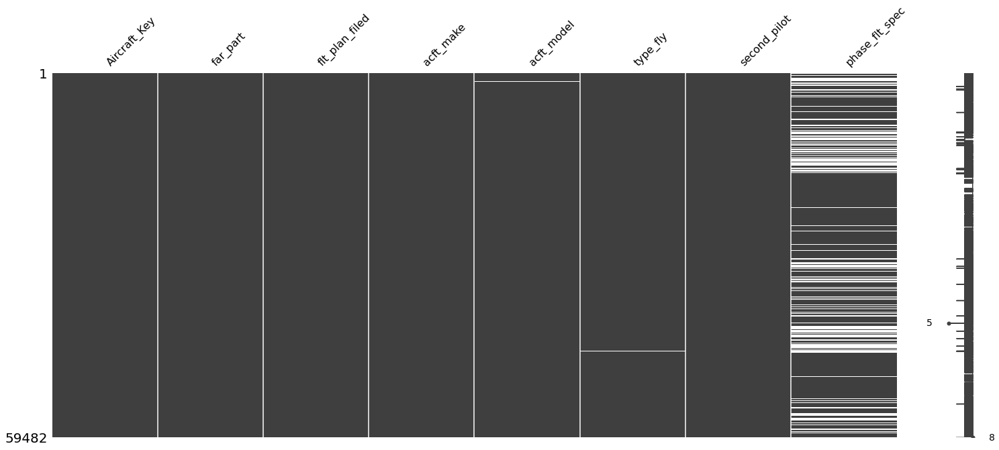

In [16]:
msno.matrix(aircraft_ga_single)
plt.show()

In [17]:
aircraft_ga_single.info()

<class 'pandas.core.frame.DataFrame'>
Index: 59482 entries, 20051031X01758 to 20070927X01454
Data columns (total 8 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   Aircraft_Key    59482 non-null  int64 
 1   far_part        59482 non-null  object
 2   flt_plan_filed  59482 non-null  object
 3   acft_make       59477 non-null  object
 4   acft_model      59477 non-null  object
 5   type_fly        59432 non-null  object
 6   second_pilot    59482 non-null  object
 7   phase_flt_spec  43959 non-null  object
dtypes: int64(1), object(7)
memory usage: 4.1+ MB


### Aircrew Dataset

In [18]:
file = 'D:/cap/capstone2/data/raw/crew.csv'
crew = pd.read_csv(file, encoding = 'Windows-1252', index_col = 0, low_memory = False) 

In [19]:
#generate_profile(crew)

##### Task: Drop unwanted columns

In [20]:
# pc_profession (pilot job) would have been an interesting feature to analyze but it contains to many missing or non-descriptive
# values to be of use

to_drop = ['crew_city', 'crew_res_state', 'crew_res_country', 'crew_inj_level', 'seat_occ_pic', 'pc_profession']
crew.drop(columns = to_drop, inplace=True)

##### Task: Analyse 'Crew Category" column and filter out unwanted records

In [21]:
info(crew, 'crew_category')

UNIQUE VALUES & COUNTS IN crew_category
['PLT  ' 'CPLT ' 'FENG ' nan 'OTHR ' 'KPLT ' 'FLTI ' 'DSTU ' 'PRPS '
 'PASS ' 'CABN ']
PLT      79257
DSTU      2873
FLTI      2383
CPLT      1795
PASS      1075
OTHR       309
PRPS       279
KPLT       145
FENG        70
CABN        40
Name: crew_category, dtype: int64
df shape: 
(88801, 10)


In [22]:
#filter out unwanted pilot categories - retain pilot, student, and empty
crew = crew[~crew['crew_category'].isin(['FLTI ', 'PASS ', 'OTHR ', 'KPLT ', 'PRPS ', 'CPLT ', 'CABN ', 'FENG '])]
info(crew, 'crew_category')

UNIQUE VALUES & COUNTS IN crew_category
['PLT  ' nan 'DSTU ']
PLT      79257
DSTU      2873
Name: crew_category, dtype: int64
df shape: 
(82705, 10)


In [23]:
#standardize unkn entry, replace codes with pilot, student for readeability
crew['crew_category'].fillna('UNK', inplace=True)
crew['crew_category'] = crew['crew_category'].str.strip()
crew['crew_category'] = crew['crew_category'].replace(['PLT', 'DSTU'], ['PILOT','STUDENT'])
info(crew, 'crew_category')

UNIQUE VALUES & COUNTS IN crew_category
['PILOT' 'UNK' 'STUDENT']
PILOT      79257
STUDENT     2873
UNK          575
Name: crew_category, dtype: int64
df shape: 
(82705, 10)


##### Task: eliminate records containing more than one pilot based on crew_number column

In [24]:
info(crew, 'crew_no')

UNIQUE VALUES & COUNTS IN crew_no
[1 2 3 4 5 6]
1    80063
2     2544
3       81
4       12
5        4
6        1
Name: crew_no, dtype: int64
df shape: 
(82705, 10)


In [25]:
#substract multi-crew records from df
multi_crew = crew[crew['crew_no'] > 1]
crew = crew[~crew.crew_no.isin(multi_crew.crew_no)]
crew.info()

<class 'pandas.core.frame.DataFrame'>
Index: 80063 entries, 20001204X00000 to 20200724X65101
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Aircraft_Key    80063 non-null  int64  
 1   crew_no         80063 non-null  int64  
 2   crew_category   80063 non-null  object 
 3   crew_age        76169 non-null  float64
 4   crew_sex        75542 non-null  object 
 5   med_certf       78259 non-null  object 
 6   med_crtf_vldty  74900 non-null  object 
 7   date_lst_med    72485 non-null  object 
 8   bfr             49800 non-null  object 
 9   bfr_date        19163 non-null  object 
dtypes: float64(1), int64(2), object(7)
memory usage: 6.7+ MB


In [26]:
crew['crew_age'].fillna(0, inplace=True)
crew['crew_age'].unique()
info(crew, 'crew_age')

UNIQUE VALUES & COUNTS IN crew_age
[ 42.  53.  39.  25.  38.  43.  63.  59.  66.  33.  46.  31.  68.  50.
  54.  37.  28.  77.  55.  56.  45.  75.  23.  47.  32.  40.  44.  20.
   0.  69.  36.  35.  18.  65.  51.  60.  48.  61.  57.  41.  71.  70.
  64.  72.  29.  34.  26.  49.  58.  22.  30.  27.  73.  74.  62.  67.
  80.  81.  19.  21.  52.  24.  82.  78.  76.  79.  85.  88.  17.  91.
  15.  83.  84.  16.  86.  14.  87.  90.  89.   1.  99.  92.  94. 114.
   8. 115.  98. 117.  93.]
0.0      3901
45.0     1879
46.0     1876
51.0     1865
43.0     1856
         ... 
93.0        1
115.0       1
114.0       1
8.0         1
117.0       1
Name: crew_age, Length: 89, dtype: int64
df shape: 
(80063, 10)


Some age values appear to be out of range. Educated replacement is to limit max age to 100 and minimum age to 14.
The earliest age to be a student pilot is 14 years. Minimal amount of records are affected.
Ages shown as 0 will be considered as unknown and will be derived later via total flight hour algorithm.

In [27]:
crew['crew_age'] = crew['crew_age'].astype(int)
crew.loc[crew['crew_age'] > 100, 'crew_age'] = 100
crew.loc[(crew['crew_age'] < 14) & (crew['crew_age'] > 0) , 'crew_age'] = 14

In [28]:
info(crew, 'crew_age')

UNIQUE VALUES & COUNTS IN crew_age
[ 42  53  39  25  38  43  63  59  66  33  46  31  68  50  54  37  28  77
  55  56  45  75  23  47  32  40  44  20   0  69  36  35  18  65  51  60
  48  61  57  41  71  70  64  72  29  34  26  49  58  22  30  27  73  74
  62  67  80  81  19  21  52  24  82  78  76  79  85  88  17  91  15  83
  84  16  86  14  87  90  89  99  92  94 100  98  93]
0      3901
45     1879
46     1876
51     1865
43     1856
       ... 
100       3
99        2
93        1
98        1
94        1
Name: crew_age, Length: 85, dtype: int64
df shape: 
(80063, 10)


##### Medical Certificate Validity

There are several codes for medical certificate validity. For the purpose of this analysis the categories can be simplified to Valid, Invalid, and Unknown.

In [29]:
crew['med_crtf_vldty'] = crew['med_crtf_vldty'].str.strip()
crew['med_crtf_vldty'].fillna('UNK', inplace=True)
print(crew['med_crtf_vldty'].value_counts())

# To ease analysis will condense categories for medical certificate validity to 'valid', 'invalid', 'unkn'.
crew['med_crtf_vldty'] = crew['med_crtf_vldty'].replace(['VWW', 'VNOW', 'WWL', 'WOWL', 'WTLS'], 'VALID')
crew['med_crtf_vldty'] = crew['med_crtf_vldty'].replace(['NONE', 'EXP', 'NV', 'WOWL'], 'INVALID')
crew['med_crtf_vldty'].value_counts()

VWW     26347
VNOW    24395
WWL     10770
UNK      8076
WOWL     6516
NONE     2147
EXP      1403
NV        302
WTLS      107
Name: med_crtf_vldty, dtype: int64


VALID      68135
UNK         8076
INVALID     3852
Name: med_crtf_vldty, dtype: int64

In [30]:
#generate_profile(crew)

A biannual flight review is a pilot check conducted every two years for pilot to maintain currency. The bfr column states wheter a pilot had a bfr and the bfr_data shows the date of the last one. Missing value comparison shows that it appears that many entries of dates in 'bfr_date' conincide with missing entries in 'bfr'. Once the dataset is merged and the date on the event is available the 'bfr_date' column can be analyzed to determined if the date was within 2 years of the event and in that case an entry under bfr valid can be made.

#### Aircrew Ratings

Pilots may hold different certifications (ratings) which in turn allows them to conduct certain operations. These certifications show a pilot's level of training.

In [31]:
file = 'D:/cap/capstone2/data/raw/ratings.csv'
ratings = pd.read_csv(file, encoding = 'Windows-1252', low_memory = False) 
#ratings.reset_index()
ratings.index.name = 'idx'

ratings['pilot_key'] = ratings['ev_id'] + ratings['Aircraft_Key'].astype(str) + ratings['crew_no'].astype(str)
to_drop = ['ev_id', 'Aircraft_Key', 'crew_no']          
ratings.drop(columns = to_drop, inplace=True)
ratings = ratings[['pilot_key', 'col_name', 'code']]
ratings.head(20)

,pilot_key,col_name,code
idx,,,
0,20001204X0000011,crew_cert_code,COMM
1,20001204X0000011,crew_rat_airpln,SEL
2,20001204X0000011,crew_rat_airpln,SES
3,20001204X0000011,crew_rat_instruct,NONE
4,20001204X0000011,crew_rat_instrum,APLN
5,20001204X0000011,crew_rat_roto,NONE
6,20001204X0000111,crew_cert_code,ATP
7,20001204X0000111,crew_cert_code,FE
8,20001204X0000111,crew_rat_airpln,MEL


In [32]:
#create new dataframe to transpose data
ratings['code'] = ratings['code'].str.strip()
certs = ratings['code'].unique()
print(certs)

['COMM' 'SEL' 'SES' 'NONE' 'APLN' 'ATP' 'FE' 'MEL' 'MES' 'PRI' 'STU'
 'HELI' 'AME' 'ASE' 'IAIR' 'CFI' 'GLI' 'MIL' 'GYRO' 'BALL' 'IHEL' 'FORN'
 'AIRS' 'REC' 'PLFT' 'SPRT' 'RMPT' 'SUAS']


In [33]:
column_names = ['CERT_ATP', 'CERT_REC', 'CERT_CFI', 'CERT_COMM', 'CERT_FE', 'CERT_FORN', 'CERT_MIL', 'CERT_NONE', 
                'CERT_PRI', 'CERT_STU', 'CERT_SPRT', 'AP_MEL', 'AP_MES', 'AP_NONE', 'AP_SEL', 'AP_SES', 'IP_AME', 
                'IP_ASE', 'IP_GLI', 'IP_GYRO', 'IP_HELI', 'IP_IAIR', 'IP_IHEL', 'IP_NONE', 'IP_SPRT', 'IP_PLFT',
                'IP_NONE']

In [34]:
new_ratings = pd.DataFrame(pd.Series(ratings['pilot_key'].unique()))
new_ratings.rename(columns = {0:'pilot_key'}, inplace=True)
new_ratings[['CERT_ATP','CERT_REC', 'CERT_CFI', 'CERT_COMM', 'CERT_FE', 'CERT_FORN', 'CERT_MIL', 'CERT_NONE', 'CERT_PRI', 
             'CERT_STU', 'CERT_SPRT']] = 0
new_ratings.head()

,pilot_key,CERT_ATP,CERT_REC,CERT_CFI,CERT_COMM,CERT_FE,CERT_FORN,CERT_MIL,CERT_NONE,CERT_PRI,CERT_STU,CERT_SPRT
0,20001204X0000011,0,0,0,0,0,0,0,0,0,0,0
1,20001204X0000111,0,0,0,0,0,0,0,0,0,0,0
2,20001204X0000211,0,0,0,0,0,0,0,0,0,0,0
3,20001204X0000311,0,0,0,0,0,0,0,0,0,0,0
4,20001204X0000411,0,0,0,0,0,0,0,0,0,0,0


In [35]:
cert_atp = ratings[(ratings['col_name'] == 'crew_cert_code') & (ratings['code'] == 'ATP')]
cert_atp.head()

,pilot_key,col_name,code
idx,,,
6,20001204X0000111,crew_cert_code,ATP
13,20001204X0000211,crew_cert_code,ATP
98,20001204X0001711,crew_cert_code,ATP
112,20001204X0001911,crew_cert_code,ATP
148,20001204X0002411,crew_cert_code,ATP


In [36]:
cert_atp_lite = cert_atp.sample(n = 1000)
new_ratings_lite = new_ratings.sample(n=1000)
df_len = len(new_ratings_lite)


for k in cert_atp_lite['pilot_key'].tolist():
    for i in range(0, df_len): 
        if k == new_ratings_lite.iloc[i,0]:
            new_ratings_lite.iloc[i,1] = 1
 

1000
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X0195911
20020917X0208011
20020917X0458611
20001212X1989211
20001212X2057911
20070411X0039311
20001214X3646711
20001213X3309111
20001214X3593811
20131030X1121612
20031031X0183311
20131023X2485512
20001213X2934511
20140305X1331511
20001212X2103011
20001208X0613511
20001214X4239811
20001213X3391711
20001206X0276511
20001213X2548111
20060131X0013611
20001206X0094511
20120103X9451311
20130729X6273711
20001213X2770911
20080915X0146311
20101130X2262811
20001213X2644411
20001211X1302311
20001214X3702211
20001214X4009511
20110320X1501811
20051114X0183411
20050720X0106511
20001214X4123311
20001208X

20001214X3870011
20090805X9143811
20190722X2300112
20001206X0225211
20170501X8182711
20090413X2243111
20001212X1772711
20001212X1929711
20021002X0526012
20001213X2821911
20050725X0108511
20020917X0470611
20020917X0492711
20050915X0146512
20001207X0361311
20020318X0035711
20030917X0155111
20140324X0054612
20001208X0706411
20001207X0407111
20001208X0613311
20001213X2484711
20001214X4155611
20001211X1190011
20001213X3017711
20060412X0042911
20001207X0337711
20031113X0189911
20001214X4443911
20140622X9194811
20001214X4429011
20110215X9344011
20001212X2125511
20190806X2134311
20020917X0238511
20081003X1753811
20151119X9402211
20001212X2473411
20160323X6235211
20001214X4432511
20001212X1658711
20001213X2596611
20001207X0478911
20001213X3341511
20001213X3458111
20190715X4540511
20001208X0816311
20080425X0055012
20150825X0011811
20180705X7091411
20101201X7412521
20160805X5015312
20001211X1586221
20001208X0750611
20001214X4195511
20180621X7224011
20020917X0236011
20001208X0538011
20001205X00245

20060719X0096811
20001208X0838711
20001213X2605411
20001214X4360911
20001213X3274611
20051209X0195811
20001208X0880511
20010216X0046111
20001213X3450111
20001214X3838311
20080227X0023711
20100912X4211511
20001206X0092811
20001214X4254611
20001214X4333211
20001213X3004111
20050819X0128811
20001214X3620011
20001208X0900411
20120802X4381611
20030827X0140711
20050407X0042821
20001206X0254011
20001207X0367811
20001208X0680311
20001213X2920511
20170712X2122711
20001214X3636411
20180610X8395511
20060718X0096212
20001213X2505011
20160718X2533412
20170924X1041411
20020917X0428111
20001214X4434511
20001212X2157711
20151015X2100611
20080107X0002511
20120821X3115911
20030305X0028511
20001213X3272611
20001213X3384311
20001212X2337411
20070313X0028311
20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X0303112
20001213X3272411
20001213X2946911
20001213X2809411
20081208X7040211
20001213X2901011
20001212X2208711
20001214X3858211
20001211X14164

20120103X9451311
20130729X6273711
20001213X2770911
20080915X0146311
20101130X2262811
20001213X2644411
20001211X1302311
20001214X3702211
20001214X4009511
20110320X1501811
20051114X0183411
20050720X0106511
20001214X4123311
20001208X0802611
20001212X1777311
20180606X2030511
20060911X0132512
20061107X0161811
20001212X1747511
20021217X0561311
20001214X4340311
20001207X0393511
20001208X0672811
20001213X3058711
20001212X2096611
20001208X0850911
20001208X0615211
20001214X4111011
20120605X2484411
20140318X4164611
20001208X0686611
20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X1605211
20160708X4482611
20001211X1310211
20001213X3378611
20120529X1583612
20001212X2038711
20001211X1586711
20001212X2376611
20001206X0194911
20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X27282

20110527X4041411
20001208X0602311
20010110X0008011
20120320X9550111
20050907X0140411
20001206X0261811
20001214X4393611
20071030X0169011
20150728X3141211
20020830X0149711
20151006X1593511
20001207X0311711
20170623X5015211
20001208X0909311
20001213X2895811
20081015X6003211
20110820X5271311
20001211X1610311
20070111X0004222
20020917X0322511
20001212X1890111
20001212X2228511
20020917X0511011
20120809X1533711
20110703X5020311
20001212X1714811
20110103X0461211
20001212X1892111
20001213X3259311
20001214X3910711
20001214X4005311
20001214X3805011
20070814X0118611
20001211X1537911
20001214X4513711
20140618X6325111
20001213X3491611
20160502X4072111
20001211X1225811
20001212X2249911
20001213X2955211
20020917X0400611
20150921X1413911
20050211X0018311
20001213X3171311
20001212X1793311
20190422X3583511
20001212X2036711
20100329X7085011
20120604X4353512
20001208X0837711
20120925X0391611
20060510X0053711
20131220X8031011
20001213X3469811
20001212X1887011
20150429X6002711
20090909X3473411
20071205X01898

20001211X1080911
20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X28769

20001211X1340211
20041116X0182411
20001211X1558911
20160316X9533911
20001213X3501711
20001212X1730311
20170222X6284911
20050901X0136111
20150303X7573911
20001213X2849611
20001207X0286911
20020917X0175211
20140507X9512511
20020917X0452911
20070920X0142311
20001213X3412111
20100509X2542411
20001208X0836911
20021118X0547911
20090427X0212011
20001214X3906911
20001211X1120211
20001214X4234711
20030813X0132311
20020917X0331811
20020917X0266511
20050916X0147512
20001207X0476411
20131024X6521611
20040608X0074511
20001211X1543021
20001213X2867411
20001204X0003111
20001207X0454021
20001214X4318011
20001214X4149611
20051018X0167512
20061010X0149011
20001214X4349611
20021024X0538111
20001206X0111511
20001211X1041311
20021021X0534811
20020702X0102311
20140524X6361511
20001213X2775811
20001213X3179211
20050317X0032311
20160718X6231311
20001213X2502211
20130718X6170311
20130508X8203111
20001212X1625711
20001213X3435811
20010613X0117011
20040422X0050011
20160302X1190212
20150402X1022911
20020917X04148

20001213X2811511
20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X2790711
20001207X0327411
20001211X0943911
20001211X1582311
20001206X0178311
20001212X2437011
20001208X0602111
20020927X0523411
20001205X0046711
20001212X2168511
20001214X4095611
20001212X1928111
20200622X3044411
20001206X0112511
20001213X2636411
20001213X2848411
20001211X1487511
20001213X3509711
20130916X8471211
20020422X0056211
20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X2463811
20001214X4133711
20001208X0528111
20001213X3153111
20130621X6465511
20001213X2616111
20160805X2220811
20001213X2955911
20121225X13047

20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X9333312
20001214X4051411
20001214X3939711
20001214X3738011
20001213X2733711
20090319X1151411
20180313X7195111
20001212X1658311
20001206X0204211
20001208X0882411
20001214X3723111
20040514X0060112
20050216X0020011
20001214X4509611
20001213X3200421
20001206X0134511
20001212X2161211
20060601X0066411
20001213X3175811
20001207X0350311
20001213X2896411
20150722X5185811
20120605X9173811
20001213X2828211
20001211X1288211
20001213X3421411
20110107X5225311
20040225X0023611
20001213X2837911
20020917X0417311
20170430X0383912
20001212X2467311
20010510X0092712
20001212X21317

20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X0195911
20020917X0208011
20020917X0458611
20001212X1989211
20001212X2057911
20070411X0039311
20001214X3646711
20001213X3309111
20001214X3593811
20131030X1121612
20031031X0183311
20131023X2485512
20001213X2934511
20140305X1331511
20001212X2103011
20001208X0613511
20001214X4239811
20001213X3391711
20001206X0276511
20001213X2548111
20060131X0013611
20001206X0094511
20120103X94513

20001212X2208711
20001214X3858211
20001211X1416411
20050629X0089411
20001206X0197911
20001214X4048911
20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X17961

20001214X3906911
20001211X1120211
20001214X4234711
20030813X0132311
20020917X0331811
20020917X0266511
20050916X0147512
20001207X0476411
20131024X6521611
20040608X0074511
20001211X1543021
20001213X2867411
20001204X0003111
20001207X0454021
20001214X4318011
20001214X4149611
20051018X0167512
20061010X0149011
20001214X4349611
20021024X0538111
20001206X0111511
20001211X1041311
20021021X0534811
20020702X0102311
20140524X6361511
20001213X2775811
20001213X3179211
20050317X0032311
20160718X6231311
20001213X2502211
20130718X6170311
20130508X8203111
20001212X1625711
20001213X3435811
20010613X0117011
20040422X0050011
20160302X1190212
20150402X1022911
20020917X0414821
20100830X0053411
20180405X3113811
20001208X0760211
20001208X0630811
20060501X0049312
20001212X2124111
20001214X4058311
20001212X1676811
20001211X1085911
20001212X1928411
20150225X0491511
20110202X8581811
20150717X4174812
20001208X0745911
20121025X0073511
20070711X0090711
20031017X0175312
20040826X0129011
20001211X0954711
20001212X24822

20071030X0169011
20150728X3141211
20020830X0149711
20151006X1593511
20001207X0311711
20170623X5015211
20001208X0909311
20001213X2895811
20081015X6003211
20110820X5271311
20001211X1610311
20070111X0004222
20020917X0322511
20001212X1890111
20001212X2228511
20020917X0511011
20120809X1533711
20110703X5020311
20001212X1714811
20110103X0461211
20001212X1892111
20001213X3259311
20001214X3910711
20001214X4005311
20001214X3805011
20070814X0118611
20001211X1537911
20001214X4513711
20140618X6325111
20001213X3491611
20160502X4072111
20001211X1225811
20001212X2249911
20001213X2955211
20020917X0400611
20150921X1413911
20050211X0018311
20001213X3171311
20001212X1793311
20190422X3583511
20001212X2036711
20100329X7085011
20120604X4353512
20001208X0837711
20120925X0391611
20060510X0053711
20131220X8031011
20001213X3469811
20001212X1887011
20150429X6002711
20090909X3473411
20071205X0189813
20001207X0296611
20001211X1417611
20180820X9514611
20001208X0601811
20001213X2564611
20001206X0273011
20130623X25322

20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X9333312
20001214X4051411
20001214X3939711
20001214X3738011
20001213X2733711
20090319X1151411
20180313X7195111
20001212X1658311
20001206X0204211
20001208X0882411
20001214X3723111
20040514X0060112
20050216X0020011
20001214X4509611
20001213X3200421
20001206X0134511
20001212X2161211
20060601X0066411
20001213X3175811
20001207X0350311
20001213X2896411
20150722X5185811
20120605X9173811
20001213X2828211
20001211X1288211
20001213X3421411
20110107X5225311
20040225X0023611
20001213X2837911
20020917X04173

20180405X3113811
20001208X0760211
20001208X0630811
20060501X0049312
20001212X2124111
20001214X4058311
20001212X1676811
20001211X1085911
20001212X1928411
20150225X0491511
20110202X8581811
20150717X4174812
20001208X0745911
20121025X0073511
20070711X0090711
20031017X0175312
20040826X0129011
20001211X0954711
20001212X2482211
20001214X4507011
20001212X2247211
20020917X0343211
20080307X0028411
20101006X6582911
20031022X0179711
20001214X4486611
20001208X0772311
20001205X0028911
20001212X2375911
20181220X0383611
20010420X0078811
20001212X1828711
20050727X0110711
20001208X0602211
20001214X4216811
20070611X0071111
20001212X2038111
20001213X2849011
20130529X7262911
20001206X0182011
20001212X2366511
20190128X9101411
20001213X3073511
20100522X1282411
20001212X1947611
20061114X0166911
20020917X0253511
20001214X3611311
20041022X0168111
20001212X1782421
20140611X3232911
20020917X0354511
20001211X1330411
20001207X0347111
20001213X3238411
20160808X2392411
20001214X3697111
20001212X1714911
20171214X32057

20001213X2616111
20160805X2220811
20001213X2955911
20121225X1304711
20170703X7141221
20001214X3674811
20110527X4041411
20001208X0602311
20010110X0008011
20120320X9550111
20050907X0140411
20001206X0261811
20001214X4393611
20071030X0169011
20150728X3141211
20020830X0149711
20151006X1593511
20001207X0311711
20170623X5015211
20001208X0909311
20001213X2895811
20081015X6003211
20110820X5271311
20001211X1610311
20070111X0004222
20020917X0322511
20001212X1890111
20001212X2228511
20020917X0511011
20120809X1533711
20110703X5020311
20001212X1714811
20110103X0461211
20001212X1892111
20001213X3259311
20001214X3910711
20001214X4005311
20001214X3805011
20070814X0118611
20001211X1537911
20001214X4513711
20140618X6325111
20001213X3491611
20160502X4072111
20001211X1225811
20001212X2249911
20001213X2955211
20020917X0400611
20150921X1413911
20050211X0018311
20001213X3171311
20001212X1793311
20190422X3583511
20001212X2036711
20100329X7085011
20120604X4353512
20001208X0837711
20120925X0391611
20060510X00537

20001213X2811511
20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X2790711
20001207X0327411
20001211X0943911
20001211X1582311
20001206X0178311
20001212X2437011
20001208X0602111
20020927X0523411
20001205X0046711
20001212X2168511
20001214X4095611
20001212X1928111
20200622X3044411
20001206X0112511
20001213X2636411
20001213X2848411
20001211X1487511
20001213X3509711
20130916X8471211
20020422X0056211
20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X2463811
20001214X4133711
20001208X0528111
20001213X3153111
20130621X6465511
20001213X2616111
20160805X2220811
20001213X2955911
20121225X13047

20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X0195911
20020917X0208011
20020917X0458611
20001212X1989211
20001212X2057911
20070411X0039311
20001214X3646711
20001213X3309111
20001214X3593811
20131030X1121612
20031031X0183311
20131023X24855

20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X2790711
20001207X0327411
20001211X0943911
20001211X1582311
20001206X0178311
20001212X2437011
20001208X0602111
20020927X0523411
20001205X00467

20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X9333312
20001214X4051411
20001214X3939711
20001214X3738011
20001213X2733711
20090319X1151411
20180313X7195111
20001212X1658311
20001206X0204211
20001208X0882411
20001214X3723111
20040514X0060112
20050216X00200

20001207X0389611
20170323X5311611
20011207X0236111
20001208X0677521
20050628X0088311
20001207X0370711
20001213X2711311
20001211X1169411
20001214X4447811
20001207X0328711
20101202X9484411
20090724X1344011
20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X30015

20001212X1714811
20110103X0461211
20001212X1892111
20001213X3259311
20001214X3910711
20001214X4005311
20001214X3805011
20070814X0118611
20001211X1537911
20001214X4513711
20140618X6325111
20001213X3491611
20160502X4072111
20001211X1225811
20001212X2249911
20001213X2955211
20020917X0400611
20150921X1413911
20050211X0018311
20001213X3171311
20001212X1793311
20190422X3583511
20001212X2036711
20100329X7085011
20120604X4353512
20001208X0837711
20120925X0391611
20060510X0053711
20131220X8031011
20001213X3469811
20001212X1887011
20150429X6002711
20090909X3473411
20071205X0189813
20001207X0296611
20001211X1417611
20180820X9514611
20001208X0601811
20001213X2564611
20001206X0273011
20130623X2532211
20001211X1565211
20120320X0101211
20071107X0175311
20170504X7252711
20001211X1292511
20040730X0111311
20001214X4186211
20130119X0260511
20001208X0582711
20001206X0232811
20001214X3870011
20090805X9143811
20190722X2300112
20001206X0225211
20170501X8182711
20090413X2243111
20001212X1772711
20001212X19297

20001211X0998211
20151022X6590111
20040105X0001311
20010502X0086111
20001211X1080911
20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X28375

20001212X1989211
20001212X2057911
20070411X0039311
20001214X3646711
20001213X3309111
20001214X3593811
20131030X1121612
20031031X0183311
20131023X2485512
20001213X2934511
20140305X1331511
20001212X2103011
20001208X0613511
20001214X4239811
20001213X3391711
20001206X0276511
20001213X2548111
20060131X0013611
20001206X0094511
20120103X9451311
20130729X6273711
20001213X2770911
20080915X0146311
20101130X2262811
20001213X2644411
20001211X1302311
20001214X3702211
20001214X4009511
20110320X1501811
20051114X0183411
20050720X0106511
20001214X4123311
20001208X0802611
20001212X1777311
20180606X2030511
20060911X0132512
20061107X0161811
20001212X1747511
20021217X0561311
20001214X4340311
20001207X0393511
20001208X0672811
20001213X3058711
20001212X2096611
20001208X0850911
20001208X0615211
20001214X4111011
20120605X2484411
20140318X4164611
20001208X0686611
20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X05469

20050819X0128811
20001214X3620011
20001208X0900411
20120802X4381611
20030827X0140711
20050407X0042821
20001206X0254011
20001207X0367811
20001208X0680311
20001213X2920511
20170712X2122711
20001214X3636411
20180610X8395511
20060718X0096212
20001213X2505011
20160718X2533412
20170924X1041411
20020917X0428111
20001214X4434511
20001212X2157711
20151015X2100611
20080107X0002511
20120821X3115911
20030305X0028511
20001213X3272611
20001213X3384311
20001212X2337411
20070313X0028311
20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X0303112
20001213X3272411
20001213X2946911
20001213X2809411
20081208X7040211
20001213X2901011
20001212X2208711
20001214X3858211
20001211X1416411
20050629X0089411
20001206X0197911
20001214X4048911
20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X16280

20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X9333312
20001214X4051411
20001214X3939711
20001214X3738011
20001213X2733711
20090319X1151411
20180313X7195111
20001212X1658311
20001206X0204211
20001208X0882411
20001214X3723111
20040514X0060112
20050216X0020011
20001214X4509611
20001213X3200421
20001206X0134511
20001212X2161211
20060601X0066411
20001213X3175811
20001207X0350311
20001213X2896411
20150722X5185811
20120605X9173811
20001213X2828211
20001211X1288211
20001213X3421411
20110107X5225311
20040225X0023611
20001213X2837911
20020917X0417311
20170430X0383912
20001212X2467311
20010510X0092712
20001212X2131711
20001213X3405011
20160217X0233211
20001213X3015111
20001214X4064211
20001213X3041811
20020917X0172611
20120831X0595711
20030825X0139311
20020917X0332611
20001213X3334911
20190104X8225011
20001213X29576

20020917X0288411
20161231X2463811
20001214X4133711
20001208X0528111
20001213X3153111
20130621X6465511
20001213X2616111
20160805X2220811
20001213X2955911
20121225X1304711
20170703X7141221
20001214X3674811
20110527X4041411
20001208X0602311
20010110X0008011
20120320X9550111
20050907X0140411
20001206X0261811
20001214X4393611
20071030X0169011
20150728X3141211
20020830X0149711
20151006X1593511
20001207X0311711
20170623X5015211
20001208X0909311
20001213X2895811
20081015X6003211
20110820X5271311
20001211X1610311
20070111X0004222
20020917X0322511
20001212X1890111
20001212X2228511
20020917X0511011
20120809X1533711
20110703X5020311
20001212X1714811
20110103X0461211
20001212X1892111
20001213X3259311
20001214X3910711
20001214X4005311
20001214X3805011
20070814X0118611
20001211X1537911
20001214X4513711
20140618X6325111
20001213X3491611
20160502X4072111
20001211X1225811
20001212X2249911
20001213X2955211
20020917X0400611
20150921X1413911
20050211X0018311
20001213X3171311
20001212X1793311
20190422X35835

20001212X1625711
20001213X3435811
20010613X0117011
20040422X0050011
20160302X1190212
20150402X1022911
20020917X0414821
20100830X0053411
20180405X3113811
20001208X0760211
20001208X0630811
20060501X0049312
20001212X2124111
20001214X4058311
20001212X1676811
20001211X1085911
20001212X1928411
20150225X0491511
20110202X8581811
20150717X4174812
20001208X0745911
20121025X0073511
20070711X0090711
20031017X0175312
20040826X0129011
20001211X0954711
20001212X2482211
20001214X4507011
20001212X2247211
20020917X0343211
20080307X0028411
20101006X6582911
20031022X0179711
20001214X4486611
20001208X0772311
20001205X0028911
20001212X2375911
20181220X0383611
20010420X0078811
20001212X1828711
20050727X0110711
20001208X0602211
20001214X4216811
20070611X0071111
20001212X2038111
20001213X2849011
20130529X7262911
20001206X0182011
20001212X2366511
20190128X9101411
20001213X3073511
20100522X1282411
20001212X1947611
20061114X0166911
20020917X0253511
20001214X3611311
20041022X0168111
20001212X1782421
20140611X32329

20001213X3273821
20071025X0165911
20120322X8573011
20190421X8054211
20001205X0023011
20001208X0822811
20130930X0571711
20060915X0134611
20001214X3893211
20001212X2165111
20181028X1385312
20001212X2024311
20170216X1482411
20150924X7091712
20001214X4393111
20001213X3539511
20001212X2105211
20120314X3332611
20020903X0150711
20090908X1445911
20020618X0091311
20010110X0017111
20070129X0010411
20001214X3710811
20100507X2504311
20001207X0389611
20170323X5311611
20011207X0236111
20001208X0677521
20050628X0088311
20001207X0370711
20001213X2711311
20001211X1169411
20001214X4447811
20001207X0328711
20101202X9484411
20090724X1344011
20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X28813

20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X2790711
20001207X0327411
20001211X0943911
20001211X1582311
20001206X0178311
20001212X2437011
20001208X0602111
20020927X0523411
20001205X0046711
20001212X2168511
20001214X4095611
20001212X1928111
20200622X3044411
20001206X0112511
20001213X2636411
20001213X2848411
20001211X14875

20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X9333312
20001214X4051411
20001214X3939711
20001214X3738011
20001213X2733711
20090319X1151411
20180313X7195111
20001212X1658311
20001206X0204211
20001208X0882411
20001214X3723111
20040514X0060112
20050216X0020011
20001214X4509611
20001213X3200421
20001206X0134511
20001212X2161211
20060601X0066411
20001213X3175811
20001207X0350311
20001213X2896411
20150722X5185811
20120605X9173811
20001213X2828211
20001211X12882

20001208X0608811
20130412X9183311
20001206X0097911
20001213X3273821
20071025X0165911
20120322X8573011
20190421X8054211
20001205X0023011
20001208X0822811
20130930X0571711
20060915X0134611
20001214X3893211
20001212X2165111
20181028X1385312
20001212X2024311
20170216X1482411
20150924X7091712
20001214X4393111
20001213X3539511
20001212X2105211
20120314X3332611
20020903X0150711
20090908X1445911
20020618X0091311
20010110X0017111
20070129X0010411
20001214X3710811
20100507X2504311
20001207X0389611
20170323X5311611
20011207X0236111
20001208X0677521
20050628X0088311
20001207X0370711
20001213X2711311
20001211X1169411
20001214X4447811
20001207X0328711
20101202X9484411
20090724X1344011
20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X61547

20001213X2955211
20020917X0400611
20150921X1413911
20050211X0018311
20001213X3171311
20001212X1793311
20190422X3583511
20001212X2036711
20100329X7085011
20120604X4353512
20001208X0837711
20120925X0391611
20060510X0053711
20131220X8031011
20001213X3469811
20001212X1887011
20150429X6002711
20090909X3473411
20071205X0189813
20001207X0296611
20001211X1417611
20180820X9514611
20001208X0601811
20001213X2564611
20001206X0273011
20130623X2532211
20001211X1565211
20120320X0101211
20071107X0175311
20170504X7252711
20001211X1292511
20040730X0111311
20001214X4186211
20130119X0260511
20001208X0582711
20001206X0232811
20001214X3870011
20090805X9143811
20190722X2300112
20001206X0225211
20170501X8182711
20090413X2243111
20001212X1772711
20001212X1929711
20021002X0526012
20001213X2821911
20050725X0108511
20020917X0470611
20020917X0492711
20050915X0146512
20001207X0361311
20020318X0035711
20030917X0155111
20140324X0054612
20001208X0706411
20001207X0407111
20001208X0613311
20001213X2484711
20001214X41556

20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X41171

20001213X2502211
20130718X6170311
20130508X8203111
20001212X1625711
20001213X3435811
20010613X0117011
20040422X0050011
20160302X1190212
20150402X1022911
20020917X0414821
20100830X0053411
20180405X3113811
20001208X0760211
20001208X0630811
20060501X0049312
20001212X2124111
20001214X4058311
20001212X1676811
20001211X1085911
20001212X1928411
20150225X0491511
20110202X8581811
20150717X4174812
20001208X0745911
20121025X0073511
20070711X0090711
20031017X0175312
20040826X0129011
20001211X0954711
20001212X2482211
20001214X4507011
20001212X2247211
20020917X0343211
20080307X0028411
20101006X6582911
20031022X0179711
20001214X4486611
20001208X0772311
20001205X0028911
20001212X2375911
20181220X0383611
20010420X0078811
20001212X1828711
20050727X0110711
20001208X0602211
20001214X4216811
20070611X0071111
20001212X2038111
20001213X2849011
20130529X7262911
20001206X0182011
20001212X2366511
20190128X9101411
20001213X3073511
20100522X1282411
20001212X1947611
20061114X0166911
20020917X0253511
20001214X36113

20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X2463811
20001214X4133711
20001208X0528111
20001213X3153111
20130621X6465511
20001213X2616111
20160805X2220811
20001213X2955911
20121225X1304711
20170703X7141221
20001214X3674811
20110527X4041411
20001208X0602311
20010110X0008011
20120320X9550111
20050907X0140411
20001206X0261811
20001214X4393611
20071030X0169011
20150728X3141211
20020830X0149711
20151006X1593511
20001207X0311711
20170623X5015211
20001208X0909311
20001213X2895811
20081015X6003211
20110820X5271311
20001211X1610311
20070111X0004222
20020917X0322511
20001212X1890111
20001212X2228511
20020917X0511011
20120809X1533711
20110703X5020311
20001212X1714811
20110103X0461211
20001212X1892111
20001213X3259311
20001214X3910711
20001214X4005311
20001214X3805011
20070814X0118611
20001211X1537911
20001214X4513711
20140618X6325111
20001213X3491611
20160502X4072111
20001211X1225811
20001212X2249911
20001213X2955211
20020917X04006

20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X2790711
20001207X0327411
20001211X0943911
20001211X1582311
20001206X0178311
20001212X2437011
20001208X0602111
20020927X0523411
20001205X0046711
20001212X2168511
20001214X4095611
20001212X1928111
20200622X3044411
20001206X0112511
20001213X2636411
20001213X2848411
20001211X1487511
20001213X3509711
20130916X8471211
20020422X0056211
20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X00033

20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X0089911
20001207X0376011
20140826X6491712
20081020X7401311
20170105X7472611
20001213X3430911
20001211X1340211
20041116X0182411
20001211X1558911
20160316X9533911
20001213X3501711
20001212X1730311
20170222X6284911
20050901X0136111
20150303X7573911
20001213X2849611
20001207X0286911
20020917X0175211
20140507X9512511
20020917X0452911
20070920X0142311
20001213X3412111
20100509X2542411
20001208X0836911
20021118X0547911
20090427X0212011
20001214X3906911
20001211X1120211
20001214X4234711
20030813X0132311
20020917X0331811
20020917X0266511
20050916X01475

20101202X9484411
20090724X1344011
20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X0195911
20020917X0208011
20020917X0458611
20001212X1989211
20001212X2057911
20070411X0039311
20001214X3646711
20001213X3309111
20001214X3593811
20131030X11216

20050204X0013411
20001214X4156011
20001212X1711111
20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X1132511
20060719X0096811
20001208X0838711
20001213X2605411
20001214X4360911
20001213X3274611
20051209X0195811
20001208X0880511
20010216X0046111
20001213X3450111
20001214X3838311
20080227X0023711
20100912X4211511
20001206X0092811
20001214X4254611
20001214X4333211
20001213X3004111
20050819X0128811
20001214X3620011
20001208X0900411
20120802X4381611
20030827X0140711
20050407X0042821
20001206X0254011
20001207X0367811
20001208X0680311
20001213X2920511
20170712X2122711
20001214X3636411
20180610X8395511
20060718X0096212
20001213X2505011
20160718X2533412
20170924X1041411
20020917X0428111
20001214X4434511
20001212X2157711
20151015X2100611
20080107X0002511
20120821X3115911
20030305X0028511
20001213X3272611
20001213X3384311
20001212X2337411
20070313X0028311
20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X03031

20001213X3179211
20050317X0032311
20160718X6231311
20001213X2502211
20130718X6170311
20130508X8203111
20001212X1625711
20001213X3435811
20010613X0117011
20040422X0050011
20160302X1190212
20150402X1022911
20020917X0414821
20100830X0053411
20180405X3113811
20001208X0760211
20001208X0630811
20060501X0049312
20001212X2124111
20001214X4058311
20001212X1676811
20001211X1085911
20001212X1928411
20150225X0491511
20110202X8581811
20150717X4174812
20001208X0745911
20121025X0073511
20070711X0090711
20031017X0175312
20040826X0129011
20001211X0954711
20001212X2482211
20001214X4507011
20001212X2247211
20020917X0343211
20080307X0028411
20101006X6582911
20031022X0179711
20001214X4486611
20001208X0772311
20001205X0028911
20001212X2375911
20181220X0383611
20010420X0078811
20001212X1828711
20050727X0110711
20001208X0602211
20001214X4216811
20070611X0071111
20001212X2038111
20001213X2849011
20130529X7262911
20001206X0182011
20001212X2366511
20190128X9101411
20001213X3073511
20100522X1282411
20001212X19476

20110703X5020311
20001212X1714811
20110103X0461211
20001212X1892111
20001213X3259311
20001214X3910711
20001214X4005311
20001214X3805011
20070814X0118611
20001211X1537911
20001214X4513711
20140618X6325111
20001213X3491611
20160502X4072111
20001211X1225811
20001212X2249911
20001213X2955211
20020917X0400611
20150921X1413911
20050211X0018311
20001213X3171311
20001212X1793311
20190422X3583511
20001212X2036711
20100329X7085011
20120604X4353512
20001208X0837711
20120925X0391611
20060510X0053711
20131220X8031011
20001213X3469811
20001212X1887011
20150429X6002711
20090909X3473411
20071205X0189813
20001207X0296611
20001211X1417611
20180820X9514611
20001208X0601811
20001213X2564611
20001206X0273011
20130623X2532211
20001211X1565211
20120320X0101211
20071107X0175311
20170504X7252711
20001211X1292511
20040730X0111311
20001214X4186211
20130119X0260511
20001208X0582711
20001206X0232811
20001214X3870011
20090805X9143811
20190722X2300112
20001206X0225211
20170501X8182711
20090413X2243111
20001212X17727

20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X2463811
20001214X4133711
20001208X0528111
20001213X3153111
20130621X6465511
20001213X2616111
20160805X2220811
20001213X2955911
20121225X1304711
20170703X7141221
20001214X3674811
20110527X4041411
20001208X0602311
20010110X0008011
20120320X9550111
20050907X0140411
20001206X0261811
20001214X4393611
20071030X0169011
20150728X3141211
20020830X0149711
20151006X1593511
20001207X0311711
20170623X5015211
20001208X0909311
20001213X2895811
20081015X6003211
20110820X5271311
20001211X1610311
20070111X0004222
20020917X0322511
20001212X1890111
20001212X2228511
20020917X0511011
20120809X1533711
20110703X5020311
20001212X1714811
20110103X0461211
20001212X1892111
20001213X3259311
20001214X3910711
20001214X4005311
20001214X3805011
20070814X0118611
20001211X1537911
20001214X4513711
20140618X6325111
20001213X3491611
20160502X4072111
20001211X12258

20130927X8113611
20180420X0441511
20001208X0589211
20041118X0183611
20170924X0404811
20001214X4297111
20171209X0520011
20010714X0143011
20001206X0246511
20001211X1536511
20001211X1249611
20001214X3626911
20001214X4058011
20001212X2453711
20001206X0257711
20020917X0207611
20151015X1594911
20001214X3874911
20120603X7492011
20100708X7534811
20061016X0152411
20001206X0219411
20001214X3644111
20001214X4126211
20030109X0003912
20100923X0055411
20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X0998211
20151022X6590111
20040105X0001311
20010502X0086111
20001211X1080911
20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X31740

20001206X0094511
20120103X9451311
20130729X6273711
20001213X2770911
20080915X0146311
20101130X2262811
20001213X2644411
20001211X1302311
20001214X3702211
20001214X4009511
20110320X1501811
20051114X0183411
20050720X0106511
20001214X4123311
20001208X0802611
20001212X1777311
20180606X2030511
20060911X0132512
20061107X0161811
20001212X1747511
20021217X0561311
20001214X4340311
20001207X0393511
20001208X0672811
20001213X3058711
20001212X2096611
20001208X0850911
20001208X0615211
20001214X4111011
20120605X2484411
20140318X4164611
20001208X0686611
20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X1605211
20160708X4482611
20001211X1310211
20001213X3378611
20120529X1583612
20001212X2038711
20001211X1586711
20001212X2376611
20001206X0194911
20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X13310

20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X2790711
20001207X0327411
20001211X0943911
20001211X1582311
20001206X0178311
20001212X2437011
20001208X0602111
20020927X0523411
20001205X0046711
20001212X2168511
20001214X4095611
20001212X1928111
20200622X3044411
20001206X0112511
20001213X2636411
20001213X2848411
20001211X1487511
20001213X3509711
20130916X8471211
20020422X0056211
20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X63502

20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X93333

20110929X9524811
20001213X3439211
20001206X0102711
20180529X8421111
20001208X0812611
20020917X0427111
20001214X4518311
20001211X1501311
20111115X1485111
20001213X2492311
20001208X0608811
20130412X9183311
20001206X0097911
20001213X3273821
20071025X0165911
20120322X8573011
20190421X8054211
20001205X0023011
20001208X0822811
20130930X0571711
20060915X0134611
20001214X3893211
20001212X2165111
20181028X1385312
20001212X2024311
20170216X1482411
20150924X7091712
20001214X4393111
20001213X3539511
20001212X2105211
20120314X3332611
20020903X0150711
20090908X1445911
20020618X0091311
20010110X0017111
20070129X0010411
20001214X3710811
20100507X2504311
20001207X0389611
20170323X5311611
20011207X0236111
20001208X0677521
20050628X0088311
20001207X0370711
20001213X2711311
20001211X1169411
20001214X4447811
20001207X0328711
20101202X9484411
20090724X1344011
20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X95755

20001206X0112511
20001213X2636411
20001213X2848411
20001211X1487511
20001213X3509711
20130916X8471211
20020422X0056211
20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X2463811
20001214X4133711
20001208X0528111
20001213X3153111
20130621X6465511
20001213X2616111
20160805X2220811
20001213X2955911
20121225X1304711
20170703X7141221
20001214X3674811
20110527X4041411
20001208X0602311
20010110X0008011
20120320X9550111
20050907X0140411
20001206X0261811
20001214X4393611
20071030X0169011
20150728X3141211
20020830X0149711
20151006X1593511
20001207X0311711
20170623X5015211
20001208X0909311
20001213X2895811
20081015X6003211
20110820X52713

20101006X6582911
20031022X0179711
20001214X4486611
20001208X0772311
20001205X0028911
20001212X2375911
20181220X0383611
20010420X0078811
20001212X1828711
20050727X0110711
20001208X0602211
20001214X4216811
20070611X0071111
20001212X2038111
20001213X2849011
20130529X7262911
20001206X0182011
20001212X2366511
20190128X9101411
20001213X3073511
20100522X1282411
20001212X1947611
20061114X0166911
20020917X0253511
20001214X3611311
20041022X0168111
20001212X1782421
20140611X3232911
20020917X0354511
20001211X1330411
20001207X0347111
20001213X3238411
20160808X2392411
20001214X3697111
20001212X1714911
20171214X3205711
20001212X2294011
20001212X2115311
20160330X2331611
20110623X9073812
20001214X4135011
20100421X5280111
20001211X1245411
20001208X0888711
20001208X0516211
20091022X7402411
20001211X1368011
20001213X2852111
20020917X0289611
20010213X0044211
20030724X0118711
20130927X8113611
20180420X0441511
20001208X0589211
20041118X0183611
20170924X0404811
20001214X4297111
20171209X0520011
20010714X01430

20001211X1041311
20021021X0534811
20020702X0102311
20140524X6361511
20001213X2775811
20001213X3179211
20050317X0032311
20160718X6231311
20001213X2502211
20130718X6170311
20130508X8203111
20001212X1625711
20001213X3435811
20010613X0117011
20040422X0050011
20160302X1190212
20150402X1022911
20020917X0414821
20100830X0053411
20180405X3113811
20001208X0760211
20001208X0630811
20060501X0049312
20001212X2124111
20001214X4058311
20001212X1676811
20001211X1085911
20001212X1928411
20150225X0491511
20110202X8581811
20150717X4174812
20001208X0745911
20121025X0073511
20070711X0090711
20031017X0175312
20040826X0129011
20001211X0954711
20001212X2482211
20001214X4507011
20001212X2247211
20020917X0343211
20080307X0028411
20101006X6582911
20031022X0179711
20001214X4486611
20001208X0772311
20001205X0028911
20001212X2375911
20181220X0383611
20010420X0078811
20001212X1828711
20050727X0110711
20001208X0602211
20001214X4216811
20070611X0071111
20001212X2038111
20001213X2849011
20130529X7262911
20001206X01820

20001213X2809411
20081208X7040211
20001213X2901011
20001212X2208711
20001214X3858211
20001211X1416411
20050629X0089411
20001206X0197911
20001214X4048911
20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X40016

20070617X0075111
20040729X0110911
20151012X2211711
20120502X0134011
20010321X0062312
20100713X4065911
20001212X2184311
20070411X0038811
20180321X0472211
20190302X8230211
20001214X4175011
20001214X4506611
20160516X9554811
20001208X0681811
20010518X0096511
20040722X0103512
20001214X4065011
20001214X3736111
20001214X4310411
20001212X1857511
20001218X4544611
20110929X9524811
20001213X3439211
20001206X0102711
20180529X8421111
20001208X0812611
20020917X0427111
20001214X4518311
20001211X1501311
20111115X1485111
20001213X2492311
20001208X0608811
20130412X9183311
20001206X0097911
20001213X3273821
20071025X0165911
20120322X8573011
20190421X8054211
20001205X0023011
20001208X0822811
20130930X0571711
20060915X0134611
20001214X3893211
20001212X2165111
20181028X1385312
20001212X2024311
20170216X1482411
20150924X7091712
20001214X4393111
20001213X3539511
20001212X2105211
20120314X3332611
20020903X0150711
20090908X1445911
20020618X0091311
20010110X0017111
20070129X0010411
20001214X3710811
20100507X25043

20001214X3611311
20041022X0168111
20001212X1782421
20140611X3232911
20020917X0354511
20001211X1330411
20001207X0347111
20001213X3238411
20160808X2392411
20001214X3697111
20001212X1714911
20171214X3205711
20001212X2294011
20001212X2115311
20160330X2331611
20110623X9073812
20001214X4135011
20100421X5280111
20001211X1245411
20001208X0888711
20001208X0516211
20091022X7402411
20001211X1368011
20001213X2852111
20020917X0289611
20010213X0044211
20030724X0118711
20130927X8113611
20180420X0441511
20001208X0589211
20041118X0183611
20170924X0404811
20001214X4297111
20171209X0520011
20010714X0143011
20001206X0246511
20001211X1536511
20001211X1249611
20001214X3626911
20001214X4058011
20001212X2453711
20001206X0257711
20020917X0207611
20151015X1594911
20001214X3874911
20120603X7492011
20100708X7534811
20061016X0152411
20001206X0219411
20001214X3644111
20001214X4126211
20030109X0003912
20100923X0055411
20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X09982

20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X2463811
20001214X4133711
20001208X0528111
20001213X3153111
20130621X6465511
20001213X2616111
20160805X2220811
20001213X2955911
20121225X1304711
20170703X7141221
20001214X3674811
20110527X4041411
20001208X0602311
20010110X0008011
20120320X9550111
20050907X0140411
20001206X0261811
20001214X4393611
20071030X0169011
20150728X3141211
20020830X0149711
20151006X1593511
20001207X0311711
20170623X5015211
20001208X0909311
20001213X2895811
20081015X6003211
20110820X5271311
20001211X1610311
20070111X0004222
20020917X0322511
20001212X1890111
20001212X2228511
20020917X0511011
20120809X1533711
20110703X5020311
20001212X1714811
20110103X0461211
20001212X1892111
20001213X3259311
20001214X3910711
20001214X40053

20001208X0836911
20021118X0547911
20090427X0212011
20001214X3906911
20001211X1120211
20001214X4234711
20030813X0132311
20020917X0331811
20020917X0266511
20050916X0147512
20001207X0476411
20131024X6521611
20040608X0074511
20001211X1543021
20001213X2867411
20001204X0003111
20001207X0454021
20001214X4318011
20001214X4149611
20051018X0167512
20061010X0149011
20001214X4349611
20021024X0538111
20001206X0111511
20001211X1041311
20021021X0534811
20020702X0102311
20140524X6361511
20001213X2775811
20001213X3179211
20050317X0032311
20160718X6231311
20001213X2502211
20130718X6170311
20130508X8203111
20001212X1625711
20001213X3435811
20010613X0117011
20040422X0050011
20160302X1190212
20150402X1022911
20020917X0414821
20100830X0053411
20180405X3113811
20001208X0760211
20001208X0630811
20060501X0049312
20001212X2124111
20001214X4058311
20001212X1676811
20001211X1085911
20001212X1928411
20150225X0491511
20110202X8581811
20150717X4174812
20001208X0745911
20121025X0073511
20070711X0090711
20031017X01753

20001214X4156011
20001212X1711111
20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X1132511
20060719X0096811
20001208X0838711
20001213X2605411
20001214X4360911
20001213X3274611
20051209X0195811
20001208X0880511
20010216X0046111
20001213X3450111
20001214X3838311
20080227X0023711
20100912X4211511
20001206X0092811
20001214X4254611
20001214X4333211
20001213X3004111
20050819X0128811
20001214X3620011
20001208X0900411
20120802X4381611
20030827X0140711
20050407X0042821
20001206X0254011
20001207X0367811
20001208X0680311
20001213X2920511
20170712X2122711
20001214X3636411
20180610X8395511
20060718X0096212
20001213X2505011
20160718X2533412
20170924X1041411
20020917X0428111
20001214X4434511
20001212X2157711
20151015X2100611
20080107X0002511
20120821X3115911
20030305X0028511
20001213X3272611
20001213X3384311
20001212X2337411
20070313X0028311
20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X0303112
20001213X32724

20001214X4393611
20071030X0169011
20150728X3141211
20020830X0149711
20151006X1593511
20001207X0311711
20170623X5015211
20001208X0909311
20001213X2895811
20081015X6003211
20110820X5271311
20001211X1610311
20070111X0004222
20020917X0322511
20001212X1890111
20001212X2228511
20020917X0511011
20120809X1533711
20110703X5020311
20001212X1714811
20110103X0461211
20001212X1892111
20001213X3259311
20001214X3910711
20001214X4005311
20001214X3805011
20070814X0118611
20001211X1537911
20001214X4513711
20140618X6325111
20001213X3491611
20160502X4072111
20001211X1225811
20001212X2249911
20001213X2955211
20020917X0400611
20150921X1413911
20050211X0018311
20001213X3171311
20001212X1793311
20190422X3583511
20001212X2036711
20100329X7085011
20120604X4353512
20001208X0837711
20120925X0391611
20060510X0053711
20131220X8031011
20001213X3469811
20001212X1887011
20150429X6002711
20090909X3473411
20071205X0189813
20001207X0296611
20001211X1417611
20180820X9514611
20001208X0601811
20001213X2564611
20001206X02730

20001207X0454021
20001214X4318011
20001214X4149611
20051018X0167512
20061010X0149011
20001214X4349611
20021024X0538111
20001206X0111511
20001211X1041311
20021021X0534811
20020702X0102311
20140524X6361511
20001213X2775811
20001213X3179211
20050317X0032311
20160718X6231311
20001213X2502211
20130718X6170311
20130508X8203111
20001212X1625711
20001213X3435811
20010613X0117011
20040422X0050011
20160302X1190212
20150402X1022911
20020917X0414821
20100830X0053411
20180405X3113811
20001208X0760211
20001208X0630811
20060501X0049312
20001212X2124111
20001214X4058311
20001212X1676811
20001211X1085911
20001212X1928411
20150225X0491511
20110202X8581811
20150717X4174812
20001208X0745911
20121025X0073511
20070711X0090711
20031017X0175312
20040826X0129011
20001211X0954711
20001212X2482211
20001214X4507011
20001212X2247211
20020917X0343211
20080307X0028411
20101006X6582911
20031022X0179711
20001214X4486611
20001208X0772311
20001205X0028911
20001212X2375911
20181220X0383611
20010420X0078811
20001212X18287

20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X2790711
20001207X0327411
20001211X0943911
20001211X1582311
20001206X0178311
20001212X2437011
20001208X0602111
20020927X0523411
20001205X0046711
20001212X2168511
20001214X4095611
20001212X1928111
20200622X3044411
20001206X0112511
20001213X2636411
20001213X2848411
20001211X1487511
20001213X35097

20011207X0236111
20001208X0677521
20050628X0088311
20001207X0370711
20001213X2711311
20001211X1169411
20001214X4447811
20001207X0328711
20101202X9484411
20090724X1344011
20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X0195911
20020917X02080

20001212X2376611
20001206X0194911
20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X0089911
20001207X0376011
20140826X6491712
20081020X7401311
20170105X7472611
20001213X3430911
20001211X1340211
20041116X0182411
20001211X1558911
20160316X9533911
20001213X3501711
20001212X1730311
20170222X6284911
20050901X0136111
20150303X7573911
20001213X2849611
20001207X0286911
20020917X0175211
20140507X9512511
20020917X0452911
20070920X0142311
20001213X3412111
20100509X2542411
20001208X08369

20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X2790711
20001207X0327411
20001211X0943911
20001211X1582311
20001206X0178311
20001212X2437011
20001208X0602111
20020927X0523411
20001205X0046711
20001212X2168511
20001214X40956

20020422X0056211
20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X2463811
20001214X4133711
20001208X0528111
20001213X3153111
20130621X6465511
20001213X2616111
20160805X2220811
20001213X2955911
20121225X1304711
20170703X7141221
20001214X3674811
20110527X4041411
20001208X0602311
20010110X0008011
20120320X9550111
20050907X0140411
20001206X0261811
20001214X4393611
20071030X0169011
20150728X3141211
20020830X0149711
20151006X1593511
20001207X0311711
20170623X5015211
20001208X0909311
20001213X2895811
20081015X6003211
20110820X5271311
20001211X1610311
20070111X0004222
20020917X0322511
20001212X1890111
20001212X2228511
20020917X05110

20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X0089911
20001207X0376011
20140826X6491712
20081020X7401311
20170105X7472611
20001213X3430911
20001211X1340211
20041116X0182411
20001211X1558911
20160316X9533911
20001213X3501711
20001212X1730311
20170222X6284911
20050901X0136111
20150303X7573911
20001213X2849611
20001207X0286911
20020917X0175211
20140507X9512511
20020917X0452911
20070920X0142311
20001213X3412111
20100509X2542411
20001208X0836911
20021118X0547911
20090427X0212011
20001214X3906911
20001211X1120211
20001214X4234711
20030813X0132311
20020917X0331811
20020917X0266511
20050916X0147512
20001207X0476411
20131024X6521611
20040608X0074511
20001211X1543021
20001213X2867411
20001204X0003111
20001207X0454021
20001214X4318011
20001214X4149611
20051018X0167512
20061010X0149011
20001214X4349611
20021024X0538111
20001206X0111511
20001211X10413

20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X01971

20001211X1487511
20001213X3509711
20130916X8471211
20020422X0056211
20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X2463811
20001214X4133711
20001208X0528111
20001213X3153111
20130621X6465511
20001213X2616111
20160805X2220811
20001213X2955911
20121225X1304711
20170703X7141221
20001214X3674811
20110527X4041411
20001208X0602311
20010110X0008011
20120320X9550111
20050907X0140411
20001206X0261811
20001214X4393611
20071030X0169011
20150728X3141211
20020830X0149711
20151006X1593511
20001207X0311711
20170623X5015211
20001208X0909311
20001213X2895811
20081015X6003211
20110820X5271311
20001211X1610311
20070111X0004222
20020917X03225

20001213X3076411
20011011X0207321
20020917X0394511
20001214X3686111
20100609X5193211
20030806X0127611
20050518X0063012
20001206X0167011
20160724X0192011
20071121X0183011
20001212X2018811
20001206X0108211
20001213X2947511
20001213X3453011
20001213X2573211
20100708X4571812
20001211X1352511
20001211X1415311
20040812X0120711
20001214X3686711
20060202X0015511
20001208X0930111
20180915X2385211
20031006X0166312
20020607X0083611
20040629X0087911
20071203X0188911
20030203X0014211
20030926X0160611
20001212X2150711
20001213X3454811
20001214X4093211
20080812X0122911
20001213X3368411
20001213X3524511
20001212X2249411
20001213X3044611
20001214X4181911
20001206X0060611
20070617X0075111
20040729X0110911
20151012X2211711
20120502X0134011
20010321X0062312
20100713X4065911
20001212X2184311
20070411X0038811
20180321X0472211
20190302X8230211
20001214X4175011
20001214X4506611
20160516X9554811
20001208X0681811
20010518X0096511
20040722X0103512
20001214X4065011
20001214X3736111
20001214X4310411
20001212X18575

20001214X4216811
20070611X0071111
20001212X2038111
20001213X2849011
20130529X7262911
20001206X0182011
20001212X2366511
20190128X9101411
20001213X3073511
20100522X1282411
20001212X1947611
20061114X0166911
20020917X0253511
20001214X3611311
20041022X0168111
20001212X1782421
20140611X3232911
20020917X0354511
20001211X1330411
20001207X0347111
20001213X3238411
20160808X2392411
20001214X3697111
20001212X1714911
20171214X3205711
20001212X2294011
20001212X2115311
20160330X2331611
20110623X9073812
20001214X4135011
20100421X5280111
20001211X1245411
20001208X0888711
20001208X0516211
20091022X7402411
20001211X1368011
20001213X2852111
20020917X0289611
20010213X0044211
20030724X0118711
20130927X8113611
20180420X0441511
20001208X0589211
20041118X0183611
20170924X0404811
20001214X4297111
20171209X0520011
20010714X0143011
20001206X0246511
20001211X1536511
20001211X1249611
20001214X3626911
20001214X4058011
20001212X2453711
20001206X0257711
20020917X0207611
20151015X1594911
20001214X3874911
20120603X74920

20001206X0112511
20001213X2636411
20001213X2848411
20001211X1487511
20001213X3509711
20130916X8471211
20020422X0056211
20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X2463811
20001214X4133711
20001208X0528111
20001213X3153111
20130621X6465511
20001213X2616111
20160805X2220811
20001213X2955911
20121225X1304711
20170703X7141221
20001214X3674811
20110527X4041411
20001208X0602311
20010110X0008011
20120320X9550111
20050907X0140411
20001206X0261811
20001214X4393611
20071030X0169011
20150728X3141211
20020830X0149711
20151006X1593511
20001207X0311711
20170623X5015211
20001208X0909311
20001213X2895811
20081015X6003211
20110820X52713

20001206X0094511
20120103X9451311
20130729X6273711
20001213X2770911
20080915X0146311
20101130X2262811
20001213X2644411
20001211X1302311
20001214X3702211
20001214X4009511
20110320X1501811
20051114X0183411
20050720X0106511
20001214X4123311
20001208X0802611
20001212X1777311
20180606X2030511
20060911X0132512
20061107X0161811
20001212X1747511
20021217X0561311
20001214X4340311
20001207X0393511
20001208X0672811
20001213X3058711
20001212X2096611
20001208X0850911
20001208X0615211
20001214X4111011
20120605X2484411
20140318X4164611
20001208X0686611
20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X1605211
20160708X4482611
20001211X1310211
20001213X3378611
20120529X1583612
20001212X2038711
20001211X1586711
20001212X2376611
20001206X0194911
20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X13310

20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X9333312
20001214X4051411
20001214X3939711
20001214X3738011
20001213X2733711
20090319X1151411
20180313X7195111
20001212X1658311
20001206X0204211
20001208X0882411
20001214X3723111
20040514X0060112
20050216X0020011
20001214X4509611
20001213X3200421
20001206X0134511
20001212X2161211
20060601X0066411
20001213X3175811
20001207X0350311
20001213X2896411
20150722X5185811
20120605X9173811
20001213X2828211
20001211X1288211
20001213X3421411
20110107X5225311
20040225X0023611
20001213X2837911
20020917X0417311
20170430X0383912
20001212X2467311
20010510X0092712
20001212X2131711
20001213X3405011
20160217X0233211
20001213X3015111
20001214X4064211
20001213X3041811
20020917X0172611
20120831X0595711
20030825X0139311
20020917X0332611
20001213X3334911
20190104X8225011
20001213X2957611
20001212X1829011
20020917X0236111
20001213X2509111
20001214X3945111
20001208X0745511
20001211X1111511
20001214X37781

20050725X0108511
20020917X0470611
20020917X0492711
20050915X0146512
20001207X0361311
20020318X0035711
20030917X0155111
20140324X0054612
20001208X0706411
20001207X0407111
20001208X0613311
20001213X2484711
20001214X4155611
20001211X1190011
20001213X3017711
20060412X0042911
20001207X0337711
20031113X0189911
20001214X4443911
20140622X9194811
20001214X4429011
20110215X9344011
20001212X2125511
20190806X2134311
20020917X0238511
20081003X1753811
20151119X9402211
20001212X2473411
20160323X6235211
20001214X4432511
20001212X1658711
20001213X2596611
20001207X0478911
20001213X3341511
20001213X3458111
20190715X4540511
20001208X0816311
20080425X0055012
20150825X0011811
20180705X7091411
20101201X7412521
20160805X5015312
20001211X1586221
20001208X0750611
20001214X4195511
20180621X7224011
20020917X0236011
20001208X0538011
20001205X0024511
20190917X8541411
20020530X0077011
20020917X0351211
20140702X2295011
20001213X2498711
20060824X0123411
20011030X0216411
20040729X0110311
20001206X0174711
20001214X43010

20090427X0212011
20001214X3906911
20001211X1120211
20001214X4234711
20030813X0132311
20020917X0331811
20020917X0266511
20050916X0147512
20001207X0476411
20131024X6521611
20040608X0074511
20001211X1543021
20001213X2867411
20001204X0003111
20001207X0454021
20001214X4318011
20001214X4149611
20051018X0167512
20061010X0149011
20001214X4349611
20021024X0538111
20001206X0111511
20001211X1041311
20021021X0534811
20020702X0102311
20140524X6361511
20001213X2775811
20001213X3179211
20050317X0032311
20160718X6231311
20001213X2502211
20130718X6170311
20130508X8203111
20001212X1625711
20001213X3435811
20010613X0117011
20040422X0050011
20160302X1190212
20150402X1022911
20020917X0414821
20100830X0053411
20180405X3113811
20001208X0760211
20001208X0630811
20060501X0049312
20001212X2124111
20001214X4058311
20001212X1676811
20001211X1085911
20001212X1928411
20150225X0491511
20110202X8581811
20150717X4174812
20001208X0745911
20121025X0073511
20070711X0090711
20031017X0175312
20040826X0129011
20001211X09547

20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X9333312
20001214X4051411
20001214X3939711
20001214X3738011
20001213X2733711
20090319X1151411
20180313X7195111
20001212X1658311
20001206X0204211
20001208X0882411
20001214X3723111
20040514X0060112
20050216X0020011
20001214X4509611
20001213X3200421
20001206X0134511
20001212X2161211
20060601X0066411
20001213X3175811
20001207X0350311
20001213X2896411
20150722X5185811
20120605X9173811
20001213X2828211
20001211X1288211
20001213X3421411
20110107X5225311
20040225X0023611
20001213X2837911
20020917X0417311
20170430X0383912
20001212X2467311
20010510X0092712
20001212X2131711
20001213X34050

20020927X0523411
20001205X0046711
20001212X2168511
20001214X4095611
20001212X1928111
20200622X3044411
20001206X0112511
20001213X2636411
20001213X2848411
20001211X1487511
20001213X3509711
20130916X8471211
20020422X0056211
20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X2463811
20001214X4133711
20001208X0528111
20001213X3153111
20130621X6465511
20001213X2616111
20160805X2220811
20001213X2955911
20121225X1304711
20170703X7141221
20001214X3674811
20110527X4041411
20001208X0602311
20010110X0008011
20120320X9550111
20050907X0140411
20001206X0261811
20001214X4393611
20071030X0169011
20150728X3141211
20020830X0149711
20151006X15935

20050725X0108511
20020917X0470611
20020917X0492711
20050915X0146512
20001207X0361311
20020318X0035711
20030917X0155111
20140324X0054612
20001208X0706411
20001207X0407111
20001208X0613311
20001213X2484711
20001214X4155611
20001211X1190011
20001213X3017711
20060412X0042911
20001207X0337711
20031113X0189911
20001214X4443911
20140622X9194811
20001214X4429011
20110215X9344011
20001212X2125511
20190806X2134311
20020917X0238511
20081003X1753811
20151119X9402211
20001212X2473411
20160323X6235211
20001214X4432511
20001212X1658711
20001213X2596611
20001207X0478911
20001213X3341511
20001213X3458111
20190715X4540511
20001208X0816311
20080425X0055012
20150825X0011811
20180705X7091411
20101201X7412521
20160805X5015312
20001211X1586221
20001208X0750611
20001214X4195511
20180621X7224011
20020917X0236011
20001208X0538011
20001205X0024511
20190917X8541411
20020530X0077011
20020917X0351211
20140702X2295011
20001213X2498711
20060824X0123411
20011030X0216411
20040729X0110311
20001206X0174711
20001214X43010

20061107X0161811
20001212X1747511
20021217X0561311
20001214X4340311
20001207X0393511
20001208X0672811
20001213X3058711
20001212X2096611
20001208X0850911
20001208X0615211
20001214X4111011
20120605X2484411
20140318X4164611
20001208X0686611
20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X1605211
20160708X4482611
20001211X1310211
20001213X3378611
20120529X1583612
20001212X2038711
20001211X1586711
20001212X2376611
20001206X0194911
20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X01951

20001211X1368011
20001213X2852111
20020917X0289611
20010213X0044211
20030724X0118711
20130927X8113611
20180420X0441511
20001208X0589211
20041118X0183611
20170924X0404811
20001214X4297111
20171209X0520011
20010714X0143011
20001206X0246511
20001211X1536511
20001211X1249611
20001214X3626911
20001214X4058011
20001212X2453711
20001206X0257711
20020917X0207611
20151015X1594911
20001214X3874911
20120603X7492011
20100708X7534811
20061016X0152411
20001206X0219411
20001214X3644111
20001214X4126211
20030109X0003912
20100923X0055411
20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X0998211
20151022X6590111
20040105X0001311
20010502X0086111
20001211X1080911
20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X03849

20120608X2011911
20020417X0052511
20001213X3066011
20090706X0341711
20001212X1746411
20001208X0648411
20140804X7022111
20001207X0375111
20001211X1404211
20020917X0348211
20020604X0080511
20001212X1753911
20111226X1082411
20001213X3164211
20001213X3234311
20160328X0315611
20001213X3307111
20010810X0165611
20001212X1764911
20001208X0656111
20001212X2121711
20081117X8421011
20001213X3076411
20011011X0207321
20020917X0394511
20001214X3686111
20100609X5193211
20030806X0127611
20050518X0063012
20001206X0167011
20160724X0192011
20071121X0183011
20001212X2018811
20001206X0108211
20001213X2947511
20001213X3453011
20001213X2573211
20100708X4571812
20001211X1352511
20001211X1415311
20040812X0120711
20001214X3686711
20060202X0015511
20001208X0930111
20180915X2385211
20031006X0166312
20020607X0083611
20040629X0087911
20071203X0188911
20030203X0014211
20030926X0160611
20001212X2150711
20001213X3454811
20001214X4093211
20080812X0122911
20001213X3368411
20001213X3524511
20001212X2249411
20001213X30446

20031017X0175312
20040826X0129011
20001211X0954711
20001212X2482211
20001214X4507011
20001212X2247211
20020917X0343211
20080307X0028411
20101006X6582911
20031022X0179711
20001214X4486611
20001208X0772311
20001205X0028911
20001212X2375911
20181220X0383611
20010420X0078811
20001212X1828711
20050727X0110711
20001208X0602211
20001214X4216811
20070611X0071111
20001212X2038111
20001213X2849011
20130529X7262911
20001206X0182011
20001212X2366511
20190128X9101411
20001213X3073511
20100522X1282411
20001212X1947611
20061114X0166911
20020917X0253511
20001214X3611311
20041022X0168111
20001212X1782421
20140611X3232911
20020917X0354511
20001211X1330411
20001207X0347111
20001213X3238411
20160808X2392411
20001214X3697111
20001212X1714911
20171214X3205711
20001212X2294011
20001212X2115311
20160330X2331611
20110623X9073812
20001214X4135011
20100421X5280111
20001211X1245411
20001208X0888711
20001208X0516211
20091022X7402411
20001211X1368011
20001213X2852111
20020917X0289611
20010213X0044211
20030724X01187

20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X2790711
20001207X0327411
20001211X0943911
20001211X1582311
20001206X0178311
20001212X2437011
20001208X0602111
20020927X0523411
20001205X0046711
20001212X2168511
20001214X4095611
20001212X1928111
20200622X3044411
20001206X0112511
20001213X2636411
20001213X2848411
20001211X1487511
20001213X3509711
20130916X8471211
20020422X0056211
20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X2463811
20001214X4133711
20001208X0528111
20001213X3153111
20130621X6465511
20001213X2616111
20160805X2220811
20001213X2955911
20121225X1304711
20170703X7141221
20001214X36748

20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X0195911
20020917X0208011
20020917X0458611
20001212X1989211
20001212X2057911
20070411X0039311
20001214X3646711
20001213X3309111
20001214X3593811
20131030X1121612
20031031X0183311
20131023X2485512
20001213X2934511
20140305X1331511
20001212X2103011
20001208X0613511
20001214X4239811
20001213X3391711
20001206X0276511
20001213X25481

20150722X5185811
20120605X9173811
20001213X2828211
20001211X1288211
20001213X3421411
20110107X5225311
20040225X0023611
20001213X2837911
20020917X0417311
20170430X0383912
20001212X2467311
20010510X0092712
20001212X2131711
20001213X3405011
20160217X0233211
20001213X3015111
20001214X4064211
20001213X3041811
20020917X0172611
20120831X0595711
20030825X0139311
20020917X0332611
20001213X3334911
20190104X8225011
20001213X2957611
20001212X1829011
20020917X0236111
20001213X2509111
20001214X3945111
20001208X0745511
20001211X1111511
20001214X3778111
20061214X0179311
20020418X0053411
20001214X3716811
20190809X5360811
20191221X8362111
20001213X3494411
20001214X4466711
20001214X3953111
20001213X2796311
20180507X8164811
20001213X3116611
20001214X3836611
20001208X0778211
20001214X3917311
20001206X0181711
20001213X3286311
20001211X1492811
20001213X2570811
20050407X0042711
20001211X1147811
20001213X2732211
20001214X4394911
20001207X0281111
20001214X3914111
20001207X0416811
20001205X0057011
20140811X81213

20001208X0837711
20120925X0391611
20060510X0053711
20131220X8031011
20001213X3469811
20001212X1887011
20150429X6002711
20090909X3473411
20071205X0189813
20001207X0296611
20001211X1417611
20180820X9514611
20001208X0601811
20001213X2564611
20001206X0273011
20130623X2532211
20001211X1565211
20120320X0101211
20071107X0175311
20170504X7252711
20001211X1292511
20040730X0111311
20001214X4186211
20130119X0260511
20001208X0582711
20001206X0232811
20001214X3870011
20090805X9143811
20190722X2300112
20001206X0225211
20170501X8182711
20090413X2243111
20001212X1772711
20001212X1929711
20021002X0526012
20001213X2821911
20050725X0108511
20020917X0470611
20020917X0492711
20050915X0146512
20001207X0361311
20020318X0035711
20030917X0155111
20140324X0054612
20001208X0706411
20001207X0407111
20001208X0613311
20001213X2484711
20001214X4155611
20001211X1190011
20001213X3017711
20060412X0042911
20001207X0337711
20031113X0189911
20001214X4443911
20140622X9194811
20001214X4429011
20110215X9344011
20001212X21255

20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X0089911
20001207X0376011
20140826X6491712
20081020X7401311
20170105X7472611
20001213X3430911
20001211X1340211
20041116X0182411
20001211X1558911
20160316X9533911
20001213X3501711
20001212X1730311
20170222X6284911
20050901X0136111
20150303X7573911
20001213X2849611
20001207X0286911
20020917X0175211
20140507X9512511
20020917X0452911
20070920X0142311
20001213X3412111
20100509X2542411
20001208X0836911
20021118X0547911
20090427X0212011
20001214X3906911
20001211X1120211
20001214X4234711
20030813X0132311
20020917X0331811
20020917X0266511
20050916X0147512
20001207X0476411
20131024X6521611
20040608X00745

20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X9333312
20001214X4051411
20001214X3939711
20001214X3738011
20001213X2733711
20090319X1151411
20180313X7195111
20001212X1658311
20001206X0204211
20001208X0882411
20001214X3723111
20040514X0060112
20050216X0020011
20001214X4509611
20001213X3200421
20001206X0134511
20001212X21612

20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X2790711
20001207X0327411
20001211X0943911
20001211X1582311
20001206X0178311
20001212X2437011
20001208X0602111
20020927X0523411
20001205X0046711
20001212X2168511
20001214X4095611
20001212X1928111
20200622X3044411
20001206X0112511
20001213X2636411
20001213X2848411
20001211X1487511
20001213X3509711
20130916X8471211
20020422X0056211
20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X00033

20001213X3501711
20001212X1730311
20170222X6284911
20050901X0136111
20150303X7573911
20001213X2849611
20001207X0286911
20020917X0175211
20140507X9512511
20020917X0452911
20070920X0142311
20001213X3412111
20100509X2542411
20001208X0836911
20021118X0547911
20090427X0212011
20001214X3906911
20001211X1120211
20001214X4234711
20030813X0132311
20020917X0331811
20020917X0266511
20050916X0147512
20001207X0476411
20131024X6521611
20040608X0074511
20001211X1543021
20001213X2867411
20001204X0003111
20001207X0454021
20001214X4318011
20001214X4149611
20051018X0167512
20061010X0149011
20001214X4349611
20021024X0538111
20001206X0111511
20001211X1041311
20021021X0534811
20020702X0102311
20140524X6361511
20001213X2775811
20001213X3179211
20050317X0032311
20160718X6231311
20001213X2502211
20130718X6170311
20130508X8203111
20001212X1625711
20001213X3435811
20010613X0117011
20040422X0050011
20160302X1190212
20150402X1022911
20020917X0414821
20100830X0053411
20180405X3113811
20001208X0760211
20001208X06308

20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X9333312
20001214X4051411
20001214X3939711
20001214X3738011
20001213X2733711
20090319X1151411
20180313X7195111
20001212X1658311
20001206X0204211
20001208X0882411
20001214X3723111
20040514X0060112
20050216X0020011
20001214X4509611
20001213X3200421
20001206X0134511
20001212X2161211
20060601X0066411
20001213X3175811
20001207X0350311
20001213X2896411
20150722X5185811
20120605X9173811
20001213X2828211
20001211X1288211
20001213X3421411
20110107X5225311
20040225X0023611
20001213X2837911
20020917X0417311
20170430X0383912
20001212X2467311
20010510X0092712
20001212X2131711
20001213X3405011
20160217X0233211
20001213X3015111
20001214X4064211
20001213X3041811
20020917X0172611
20120831X0595711
20030825X0139311
20020917X0332611
20001213X3334911
20190104X8225011
20001213X2957611
20001212X1829011
20020917X0236111
20001213X2509111
20001214X39451

20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X2463811
20001214X4133711
20001208X0528111
20001213X3153111
20130621X6465511
20001213X2616111
20160805X2220811
20001213X2955911
20121225X1304711
20170703X7141221
20001214X3674811
20110527X4041411
20001208X0602311
20010110X0008011
20120320X9550111
20050907X0140411
20001206X0261811
20001214X4393611
20071030X0169011
20150728X3141211
20020830X0149711
20151006X1593511
20001207X0311711
20170623X5015211
20001208X0909311
20001213X2895811
20081015X6003211
20110820X5271311
20001211X1610311
20070111X0004222
20020917X0322511
20001212X1890111
20001212X2228511
20020917X0511011
20120809X1533711
20110703X5020311
20001212X1714811
20110103X0461211
20001212X1892111
20001213X3259311
20001214X3910711
20001214X4005311
20001214X3805011
20070814X01186

20041116X0182411
20001211X1558911
20160316X9533911
20001213X3501711
20001212X1730311
20170222X6284911
20050901X0136111
20150303X7573911
20001213X2849611
20001207X0286911
20020917X0175211
20140507X9512511
20020917X0452911
20070920X0142311
20001213X3412111
20100509X2542411
20001208X0836911
20021118X0547911
20090427X0212011
20001214X3906911
20001211X1120211
20001214X4234711
20030813X0132311
20020917X0331811
20020917X0266511
20050916X0147512
20001207X0476411
20131024X6521611
20040608X0074511
20001211X1543021
20001213X2867411
20001204X0003111
20001207X0454021
20001214X4318011
20001214X4149611
20051018X0167512
20061010X0149011
20001214X4349611
20021024X0538111
20001206X0111511
20001211X1041311
20021021X0534811
20020702X0102311
20140524X6361511
20001213X2775811
20001213X3179211
20050317X0032311
20160718X6231311
20001213X2502211
20130718X6170311
20130508X8203111
20001212X1625711
20001213X3435811
20010613X0117011
20040422X0050011
20160302X1190212
20150402X1022911
20020917X0414821
20100830X00534

20190714X0074511
20141202X0303112
20001213X3272411
20001213X2946911
20001213X2809411
20081208X7040211
20001213X2901011
20001212X2208711
20001214X3858211
20001211X1416411
20050629X0089411
20001206X0197911
20001214X4048911
20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X01239

20170216X1482411
20150924X7091712
20001214X4393111
20001213X3539511
20001212X2105211
20120314X3332611
20020903X0150711
20090908X1445911
20020618X0091311
20010110X0017111
20070129X0010411
20001214X3710811
20100507X2504311
20001207X0389611
20170323X5311611
20011207X0236111
20001208X0677521
20050628X0088311
20001207X0370711
20001213X2711311
20001211X1169411
20001214X4447811
20001207X0328711
20101202X9484411
20090724X1344011
20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X04897

20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X00333

20020917X0288411
20161231X2463811
20001214X4133711
20001208X0528111
20001213X3153111
20130621X6465511
20001213X2616111
20160805X2220811
20001213X2955911
20121225X1304711
20170703X7141221
20001214X3674811
20110527X4041411
20001208X0602311
20010110X0008011
20120320X9550111
20050907X0140411
20001206X0261811
20001214X4393611
20071030X0169011
20150728X3141211
20020830X0149711
20151006X1593511
20001207X0311711
20170623X5015211
20001208X0909311
20001213X2895811
20081015X6003211
20110820X5271311
20001211X1610311
20070111X0004222
20020917X0322511
20001212X1890111
20001212X2228511
20020917X0511011
20120809X1533711
20110703X5020311
20001212X1714811
20110103X0461211
20001212X1892111
20001213X3259311
20001214X3910711
20001214X4005311
20001214X3805011
20070814X0118611
20001211X1537911
20001214X4513711
20140618X6325111
20001213X3491611
20160502X4072111
20001211X1225811
20001212X2249911
20001213X2955211
20020917X0400611
20150921X1413911
20050211X0018311
20001213X3171311
20001212X1793311
20190422X35835

20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X0089911
20001207X0376011
20140826X6491712
20081020X7401311
20170105X7472611
20001213X3430911
20001211X1340211
20041116X0182411
20001211X1558911
20160316X9533911
20001213X3501711
20001212X1730311
20170222X6284911
20050901X0136111
20150303X7573911
20001213X2849611
20001207X0286911
20020917X0175211
20140507X9512511
20020917X0452911
20070920X0142311
20001213X3412111
20100509X2542411
20001208X0836911
20021118X0547911
20090427X0212011
20001214X3906911
20001211X1120211
20001214X4234711
20030813X0132311
20020917X0331811
20020917X0266511
20050916X0147512
20001207X0476411
20131024X65216

20001214X3914111
20001207X0416811
20001205X0057011
20140811X8121311
20001208X0766911
20061101X0159511
20100628X5160511
20001208X0708211
20020917X0254511
20041006X0157911
20090806X2110811
20001206X0222611
20020917X0340911
20001212X2358411
20080506X0060911
20120326X9174811
20010807X0161811
20001212X2407811
20150922X3384711
20150924X2124611
20001205X0052811
20001206X0123111
20001214X3854611
20001212X1884911
20110912X0055312
20130404X5500811
20001211X1340511
20160802X4515911
20121215X1323211
20001212X2316611
20060802X0107211
20001214X4210211
20120718X2221811
20020917X0470411
20160228X2243311
20001208X0936411
20001212X2007811
20010828X0180212
20120416X6514111
20001213X3479411
20001212X1750111
20070501X0049411
20001212X1738611
20100624X4484611
20001213X2650811
20001214X4078011
20001214X3724411
20190824X8034711
20041026X0169811
20130813X7280012
20020917X0316611
20050204X0013411
20001214X4156011
20001212X1711111
20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X11325

20001212X2125511
20190806X2134311
20020917X0238511
20081003X1753811
20151119X9402211
20001212X2473411
20160323X6235211
20001214X4432511
20001212X1658711
20001213X2596611
20001207X0478911
20001213X3341511
20001213X3458111
20190715X4540511
20001208X0816311
20080425X0055012
20150825X0011811
20180705X7091411
20101201X7412521
20160805X5015312
20001211X1586221
20001208X0750611
20001214X4195511
20180621X7224011
20020917X0236011
20001208X0538011
20001205X0024511
20190917X8541411
20020530X0077011
20020917X0351211
20140702X2295011
20001213X2498711
20060824X0123411
20011030X0216411
20040729X0110311
20001206X0174711
20001214X4301011
20001214X3812211
20120608X2011911
20020417X0052511
20001213X3066011
20090706X0341711
20001212X1746411
20001208X0648411
20140804X7022111
20001207X0375111
20001211X1404211
20020917X0348211
20020604X0080511
20001212X1753911
20111226X1082411
20001213X3164211
20001213X3234311
20160328X0315611
20001213X3307111
20010810X0165611
20001212X1764911
20001208X0656111
20001212X21217

20001208X0615211
20001214X4111011
20120605X2484411
20140318X4164611
20001208X0686611
20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X1605211
20160708X4482611
20001211X1310211
20001213X3378611
20120529X1583612
20001212X2038711
20001211X1586711
20001212X2376611
20001206X0194911
20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X0089911
20001207X0376011
20140826X64917

20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X9333312
20001214X4051411
20001214X3939711
20001214X3738011
20001213X2733711
20090319X1151411
20180313X7195111
20001212X1658311
20001206X0204211
20001208X0882411
20001214X3723111
20040514X0060112
20050216X0020011
20001214X4509611
20001213X3200421
20001206X0134511
20001212X2161211
20060601X0066411
20001213X3175811
20001207X0350311
20001213X2896411
20150722X5185811
20120605X9173811
20001213X2828211
20001211X1288211
20001213X3421411
20110107X5225311
20040225X0023611
20001213X28379

20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X2790711
20001207X0327411
20001211X0943911
20001211X1582311
20001206X0178311
20001212X2437011
20001208X0602111
20020927X0523411
20001205X0046711
20001212X2168511
20001214X4095611
20001212X1928111
20200622X3044411
20001206X0112511
20001213X2636411
20001213X2848411
20001211X1487511
20001213X3509711
20130916X8471211
20020422X0056211
20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X18396

20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X0089911
20001207X0376011
20140826X6491712
20081020X7401311
20170105X7472611
20001213X3430911
20001211X1340211
20041116X0182411
20001211X1558911
20160316X9533911
20001213X3501711
20001212X1730311
20170222X6284911
20050901X0136111
20150303X7573911
20001213X2849611
20001207X0286911
20020917X0175211
20140507X9512511
20020917X0452911
20070920X0142311
20001213X3412111
20100509X2542411
20001208X0836911
20021118X0547911
20090427X0212011
20001214X3906911
20001211X1120211
20001214X4234711
20030813X0132311
20020917X0331811
20020917X0266511
20050916X0147512
20001207X0476411
20131024X6521611
20040608X0074511
20001211X1543021
20001213X2867411
20001204X0003111
20001207X0454021
20001214X4318011
20001214X4149611
20051018X0167512
20061010X0149011
20001214X4349611
20021024X0538111
20001206X0111511
20001211X1041311
20021021X0534811
20020702X0102311
20140524X6361511
20001213X2775811
20001213X3179211
20050317X0032311
20160718X62313

20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X0195911
20020917X0208011
20020917X0458611
20001212X1989211
20001212X2057911
20070411X0039311
20001214X3646711
20001213X3309111
20001214X3593811
20131030X1121612
20031031X0183311
20131023X2485512
20001213X2934511
20140305X1331511
20001212X2103011
20001208X0613511
20001214X4239811
20001213X3391711
20001206X0276511
20001213X2548111
20060131X0013611
20001206X0094511
20120103X9451311
20130729X6273711
20001213X2770911
20080915X0146311
20101130X2262811
20001213X2644411
20001211X1302311
20001214X3702211
20001214X4009511
20110320X1501811
20051114X0183411
20050720X0106511
20001214X41233

20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X0089911
20001207X0376011
20140826X6491712
20081020X7401311
20170105X7472611
20001213X3430911
20001211X1340211
20041116X0182411
20001211X1558911
20160316X9533911
20001213X3501711
20001212X1730311
20170222X6284911
20050901X0136111
20150303X7573911
20001213X2849611
20001207X0286911
20020917X0175211
20140507X9512511
20020917X0452911
20070920X0142311
20001213X3412111
20100509X2542411
20001208X0836911
20021118X0547911
20090427X0212011
20001214X3906911
20001211X1120211
20001214X4234711
20030813X0132311
20020917X0331811
20020917X0266511
20050916X01475

20001212X1738611
20100624X4484611
20001213X2650811
20001214X4078011
20001214X3724411
20190824X8034711
20041026X0169811
20130813X7280012
20020917X0316611
20050204X0013411
20001214X4156011
20001212X1711111
20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X1132511
20060719X0096811
20001208X0838711
20001213X2605411
20001214X4360911
20001213X3274611
20051209X0195811
20001208X0880511
20010216X0046111
20001213X3450111
20001214X3838311
20080227X0023711
20100912X4211511
20001206X0092811
20001214X4254611
20001214X4333211
20001213X3004111
20050819X0128811
20001214X3620011
20001208X0900411
20120802X4381611
20030827X0140711
20050407X0042821
20001206X0254011
20001207X0367811
20001208X0680311
20001213X2920511
20170712X2122711
20001214X3636411
20180610X8395511
20060718X0096212
20001213X2505011
20160718X2533412
20170924X1041411
20020917X0428111
20001214X4434511
20001212X2157711
20151015X2100611
20080107X0002511
20120821X3115911
20030305X0028511
20001213X3272611
20001213X33843

20120925X0391611
20060510X0053711
20131220X8031011
20001213X3469811
20001212X1887011
20150429X6002711
20090909X3473411
20071205X0189813
20001207X0296611
20001211X1417611
20180820X9514611
20001208X0601811
20001213X2564611
20001206X0273011
20130623X2532211
20001211X1565211
20120320X0101211
20071107X0175311
20170504X7252711
20001211X1292511
20040730X0111311
20001214X4186211
20130119X0260511
20001208X0582711
20001206X0232811
20001214X3870011
20090805X9143811
20190722X2300112
20001206X0225211
20170501X8182711
20090413X2243111
20001212X1772711
20001212X1929711
20021002X0526012
20001213X2821911
20050725X0108511
20020917X0470611
20020917X0492711
20050915X0146512
20001207X0361311
20020318X0035711
20030917X0155111
20140324X0054612
20001208X0706411
20001207X0407111
20001208X0613311
20001213X2484711
20001214X4155611
20001211X1190011
20001213X3017711
20060412X0042911
20001207X0337711
20031113X0189911
20001214X4443911
20140622X9194811
20001214X4429011
20110215X9344011
20001212X2125511
20190806X21343

20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X0089911
20001207X0376011
20140826X6491712
20081020X7401311
20170105X7472611
20001213X3430911
20001211X1340211
20041116X0182411
20001211X1558911
20160316X9533911
20001213X3501711
20001212X1730311
20170222X6284911
20050901X0136111
20150303X7573911
20001213X2849611
20001207X0286911
20020917X0175211
20140507X9512511
20020917X0452911
20070920X0142311
20001213X3412111
20100509X2542411
20001208X0836911
20021118X0547911
20090427X0212011
20001214X3906911
20001211X1120211
20001214X4234711
20030813X0132311
20020917X0331811
20020917X0266511
20050916X0147512
20001207X0476411
20131024X6521611
20040608X0074511
20001211X1543021
20001213X2867411
20001204X0003111
20001207X0454021
20001214X4318011
20001214X4149611
20051018X0167512
20061010X0149011
20001214X4349611
20021024X0538111
20001206X0111511
20001211X1041311
20021021X0534811
20020702X0102311
20140524X63615

20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X2790711
20001207X0327411
20001211X0943911
20001211X1582311
20001206X0178311
20001212X2437011
20001208X0602111
20020927X0523411
20001205X0046711
20001212X2168511
20001214X4095611
20001212X1928111
20200622X3044411
20001206X0112511
20001213X2636411
20001213X2848411
20001211X1487511
20001213X3509711
20130916X8471211
20020422X0056211
20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X21106

20001214X3620011
20001208X0900411
20120802X4381611
20030827X0140711
20050407X0042821
20001206X0254011
20001207X0367811
20001208X0680311
20001213X2920511
20170712X2122711
20001214X3636411
20180610X8395511
20060718X0096212
20001213X2505011
20160718X2533412
20170924X1041411
20020917X0428111
20001214X4434511
20001212X2157711
20151015X2100611
20080107X0002511
20120821X3115911
20030305X0028511
20001213X3272611
20001213X3384311
20001212X2337411
20070313X0028311
20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X0303112
20001213X3272411
20001213X2946911
20001213X2809411
20081208X7040211
20001213X2901011
20001212X2208711
20001214X3858211
20001211X1416411
20050629X0089411
20001206X0197911
20001214X4048911
20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X1628011
20001214X42328

20020917X0351211
20140702X2295011
20001213X2498711
20060824X0123411
20011030X0216411
20040729X0110311
20001206X0174711
20001214X4301011
20001214X3812211
20120608X2011911
20020417X0052511
20001213X3066011
20090706X0341711
20001212X1746411
20001208X0648411
20140804X7022111
20001207X0375111
20001211X1404211
20020917X0348211
20020604X0080511
20001212X1753911
20111226X1082411
20001213X3164211
20001213X3234311
20160328X0315611
20001213X3307111
20010810X0165611
20001212X1764911
20001208X0656111
20001212X2121711
20081117X8421011
20001213X3076411
20011011X0207321
20020917X0394511
20001214X3686111
20100609X5193211
20030806X0127611
20050518X0063012
20001206X0167011
20160724X0192011
20071121X0183011
20001212X2018811
20001206X0108211
20001213X2947511
20001213X3453011
20001213X2573211
20100708X4571812
20001211X1352511
20001211X1415311
20040812X0120711
20001214X3686711
20060202X0015511
20001208X0930111
20180915X2385211
20031006X0166312
20020607X0083611
20040629X0087911
20071203X0188911
20030203X00142

20001214X3644111
20001214X4126211
20030109X0003912
20100923X0055411
20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X0998211
20151022X6590111
20040105X0001311
20010502X0086111
20001211X1080911
20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X40391

20001205X0046711
20001212X2168511
20001214X4095611
20001212X1928111
20200622X3044411
20001206X0112511
20001213X2636411
20001213X2848411
20001211X1487511
20001213X3509711
20130916X8471211
20020422X0056211
20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X2463811
20001214X4133711
20001208X0528111
20001213X3153111
20130621X6465511
20001213X2616111
20160805X2220811
20001213X2955911
20121225X1304711
20170703X7141221
20001214X3674811
20110527X4041411
20001208X0602311
20010110X0008011
20120320X9550111
20050907X0140411
20001206X0261811
20001214X4393611
20071030X0169011
20150728X3141211
20020830X0149711
20151006X1593511
20001207X03117

20001213X2711311
20001211X1169411
20001214X4447811
20001207X0328711
20101202X9484411
20090724X1344011
20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X0195911
20020917X0208011
20020917X0458611
20001212X1989211
20001212X2057911
20070411X00393

20001208X0836911
20021118X0547911
20090427X0212011
20001214X3906911
20001211X1120211
20001214X4234711
20030813X0132311
20020917X0331811
20020917X0266511
20050916X0147512
20001207X0476411
20131024X6521611
20040608X0074511
20001211X1543021
20001213X2867411
20001204X0003111
20001207X0454021
20001214X4318011
20001214X4149611
20051018X0167512
20061010X0149011
20001214X4349611
20021024X0538111
20001206X0111511
20001211X1041311
20021021X0534811
20020702X0102311
20140524X6361511
20001213X2775811
20001213X3179211
20050317X0032311
20160718X6231311
20001213X2502211
20130718X6170311
20130508X8203111
20001212X1625711
20001213X3435811
20010613X0117011
20040422X0050011
20160302X1190212
20150402X1022911
20020917X0414821
20100830X0053411
20180405X3113811
20001208X0760211
20001208X0630811
20060501X0049312
20001212X2124111
20001214X4058311
20001212X1676811
20001211X1085911
20001212X1928411
20150225X0491511
20110202X8581811
20150717X4174812
20001208X0745911
20121025X0073511
20070711X0090711
20031017X01753

20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X2463811
20001214X4133711
20001208X0528111
20001213X3153111
20130621X6465511
20001213X2616111
20160805X2220811
20001213X2955911
20121225X1304711
20170703X7141221
20001214X3674811
20110527X4041411
20001208X0602311
20010110X0008011
20120320X9550111
20050907X0140411
20001206X0261811
20001214X4393611
20071030X0169011
20150728X3141211
20020830X0149711
20151006X1593511
20001207X0311711
20170623X5015211
20001208X0909311
20001213X2895811
20081015X6003211
20110820X5271311
20001211X1610311
20070111X0004222
20020917X0322511
20001212X1890111
20001212X2228511
20020917X0511011
20120809X1533711
20110703X5020311
20001212X1714811
20110103X0461211
20001212X1892111
20001213X3259311
20001214X39107

20001213X2484711
20001214X4155611
20001211X1190011
20001213X3017711
20060412X0042911
20001207X0337711
20031113X0189911
20001214X4443911
20140622X9194811
20001214X4429011
20110215X9344011
20001212X2125511
20190806X2134311
20020917X0238511
20081003X1753811
20151119X9402211
20001212X2473411
20160323X6235211
20001214X4432511
20001212X1658711
20001213X2596611
20001207X0478911
20001213X3341511
20001213X3458111
20190715X4540511
20001208X0816311
20080425X0055012
20150825X0011811
20180705X7091411
20101201X7412521
20160805X5015312
20001211X1586221
20001208X0750611
20001214X4195511
20180621X7224011
20020917X0236011
20001208X0538011
20001205X0024511
20190917X8541411
20020530X0077011
20020917X0351211
20140702X2295011
20001213X2498711
20060824X0123411
20011030X0216411
20040729X0110311
20001206X0174711
20001214X4301011
20001214X3812211
20120608X2011911
20020417X0052511
20001213X3066011
20090706X0341711
20001212X1746411
20001208X0648411
20140804X7022111
20001207X0375111
20001211X1404211
20020917X03482

20001208X0772311
20001205X0028911
20001212X2375911
20181220X0383611
20010420X0078811
20001212X1828711
20050727X0110711
20001208X0602211
20001214X4216811
20070611X0071111
20001212X2038111
20001213X2849011
20130529X7262911
20001206X0182011
20001212X2366511
20190128X9101411
20001213X3073511
20100522X1282411
20001212X1947611
20061114X0166911
20020917X0253511
20001214X3611311
20041022X0168111
20001212X1782421
20140611X3232911
20020917X0354511
20001211X1330411
20001207X0347111
20001213X3238411
20160808X2392411
20001214X3697111
20001212X1714911
20171214X3205711
20001212X2294011
20001212X2115311
20160330X2331611
20110623X9073812
20001214X4135011
20100421X5280111
20001211X1245411
20001208X0888711
20001208X0516211
20091022X7402411
20001211X1368011
20001213X2852111
20020917X0289611
20010213X0044211
20030724X0118711
20130927X8113611
20180420X0441511
20001208X0589211
20041118X0183611
20170924X0404811
20001214X4297111
20171209X0520011
20010714X0143011
20001206X0246511
20001211X1536511
20001211X12496

20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X2790711
20001207X0327411
20001211X0943911
20001211X1582311
20001206X0178311
20001212X2437011
20001208X0602111
20020927X0523411
20001205X0046711
20001212X2168511
20001214X4095611
20001212X1928111
20200622X3044411
20001206X0112511
20001213X2636411
20001213X2848411
20001211X1487511
20001213X3509711
20130916X8471211
20020422X0056211
20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X30510

20001212X2057911
20070411X0039311
20001214X3646711
20001213X3309111
20001214X3593811
20131030X1121612
20031031X0183311
20131023X2485512
20001213X2934511
20140305X1331511
20001212X2103011
20001208X0613511
20001214X4239811
20001213X3391711
20001206X0276511
20001213X2548111
20060131X0013611
20001206X0094511
20120103X9451311
20130729X6273711
20001213X2770911
20080915X0146311
20101130X2262811
20001213X2644411
20001211X1302311
20001214X3702211
20001214X4009511
20110320X1501811
20051114X0183411
20050720X0106511
20001214X4123311
20001208X0802611
20001212X1777311
20180606X2030511
20060911X0132512
20061107X0161811
20001212X1747511
20021217X0561311
20001214X4340311
20001207X0393511
20001208X0672811
20001213X3058711
20001212X2096611
20001208X0850911
20001208X0615211
20001214X4111011
20120605X2484411
20140318X4164611
20001208X0686611
20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X16052

20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X9333312
20001214X4051411
20001214X3939711
20001214X3738011
20001213X2733711
20090319X1151411
20180313X7195111
20001212X1658311
20001206X0204211
20001208X0882411
20001214X3723111
20040514X0060112
20050216X0020011
20001214X4509611
20001213X3200421
20001206X0134511
20001212X2161211
20060601X0066411
20001213X3175811
20001207X0350311
20001213X2896411
20150722X5185811
20120605X9173811
20001213X2828211
20001211X1288211
20001213X3421411
20110107X5225311
20040225X0023611
20001213X2837911
20020917X0417311
20170430X0383912
20001212X2467311
20010510X0092712
20001212X2131711
20001213X3405011
20160217X0233211
20001213X3015111
20001214X40642

20110820X5271311
20001211X1610311
20070111X0004222
20020917X0322511
20001212X1890111
20001212X2228511
20020917X0511011
20120809X1533711
20110703X5020311
20001212X1714811
20110103X0461211
20001212X1892111
20001213X3259311
20001214X3910711
20001214X4005311
20001214X3805011
20070814X0118611
20001211X1537911
20001214X4513711
20140618X6325111
20001213X3491611
20160502X4072111
20001211X1225811
20001212X2249911
20001213X2955211
20020917X0400611
20150921X1413911
20050211X0018311
20001213X3171311
20001212X1793311
20190422X3583511
20001212X2036711
20100329X7085011
20120604X4353512
20001208X0837711
20120925X0391611
20060510X0053711
20131220X8031011
20001213X3469811
20001212X1887011
20150429X6002711
20090909X3473411
20071205X0189813
20001207X0296611
20001211X1417611
20180820X9514611
20001208X0601811
20001213X2564611
20001206X0273011
20130623X2532211
20001211X1565211
20120320X0101211
20071107X0175311
20170504X7252711
20001211X1292511
20040730X0111311
20001214X4186211
20130119X0260511
20001208X05827

20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X0089911
20001207X0376011
20140826X6491712
20081020X7401311
20170105X7472611
20001213X3430911
20001211X1340211
20041116X0182411
20001211X1558911
20160316X9533911
20001213X3501711
20001212X1730311
20170222X6284911
20050901X0136111
20150303X7573911
20001213X2849611
20001207X0286911
20020917X0175211
20140507X9512511
20020917X0452911
20070920X0142311
20001213X3412111
20100509X2542411
20001208X0836911
20021118X0547911
20090427X0212011
20001214X3906911
20001211X1120211
20001214X4234711
20030813X0132311
20020917X0331811
20020917X0266511
20050916X0147512
20001207X0476411
20131024X6521611
20040608X0074511
20001211X15430

20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X32205

20001212X2249411
20001213X3044611
20001214X4181911
20001206X0060611
20070617X0075111
20040729X0110911
20151012X2211711
20120502X0134011
20010321X0062312
20100713X4065911
20001212X2184311
20070411X0038811
20180321X0472211
20190302X8230211
20001214X4175011
20001214X4506611
20160516X9554811
20001208X0681811
20010518X0096511
20040722X0103512
20001214X4065011
20001214X3736111
20001214X4310411
20001212X1857511
20001218X4544611
20110929X9524811
20001213X3439211
20001206X0102711
20180529X8421111
20001208X0812611
20020917X0427111
20001214X4518311
20001211X1501311
20111115X1485111
20001213X2492311
20001208X0608811
20130412X9183311
20001206X0097911
20001213X3273821
20071025X0165911
20120322X8573011
20190421X8054211
20001205X0023011
20001208X0822811
20130930X0571711
20060915X0134611
20001214X3893211
20001212X2165111
20181028X1385312
20001212X2024311
20170216X1482411
20150924X7091712
20001214X4393111
20001213X3539511
20001212X2105211
20120314X3332611
20020903X0150711
20090908X1445911
20020618X00913

20001211X1245411
20001208X0888711
20001208X0516211
20091022X7402411
20001211X1368011
20001213X2852111
20020917X0289611
20010213X0044211
20030724X0118711
20130927X8113611
20180420X0441511
20001208X0589211
20041118X0183611
20170924X0404811
20001214X4297111
20171209X0520011
20010714X0143011
20001206X0246511
20001211X1536511
20001211X1249611
20001214X3626911
20001214X4058011
20001212X2453711
20001206X0257711
20020917X0207611
20151015X1594911
20001214X3874911
20120603X7492011
20100708X7534811
20061016X0152411
20001206X0219411
20001214X3644111
20001214X4126211
20030109X0003912
20100923X0055411
20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X0998211
20151022X6590111
20040105X0001311
20010502X0086111
20001211X1080911
20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X01154

20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X2790711
20001207X0327411
20001211X0943911
20001211X1582311
20001206X0178311
20001212X2437011
20001208X0602111
20020927X0523411
20001205X0046711
20001212X2168511
20001214X4095611
20001212X1928111
20200622X3044411
20001206X0112511
20001213X2636411
20001213X2848411
20001211X14875

20111115X1485111
20001213X2492311
20001208X0608811
20130412X9183311
20001206X0097911
20001213X3273821
20071025X0165911
20120322X8573011
20190421X8054211
20001205X0023011
20001208X0822811
20130930X0571711
20060915X0134611
20001214X3893211
20001212X2165111
20181028X1385312
20001212X2024311
20170216X1482411
20150924X7091712
20001214X4393111
20001213X3539511
20001212X2105211
20120314X3332611
20020903X0150711
20090908X1445911
20020618X0091311
20010110X0017111
20070129X0010411
20001214X3710811
20100507X2504311
20001207X0389611
20170323X5311611
20011207X0236111
20001208X0677521
20050628X0088311
20001207X0370711
20001213X2711311
20001211X1169411
20001214X4447811
20001207X0328711
20101202X9484411
20090724X1344011
20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X75214

20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X20870

20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X2463811
20001214X4133711
20001208X0528111
20001213X3153111
20130621X6465511
20001213X2616111
20160805X2220811
20001213X2955911
20121225X1304711
20170703X7141221
20001214X3674811
20110527X4041411
20001208X0602311
20010110X0008011
20120320X9550111
20050907X0140411
20001206X0261811
20001214X4393611
20071030X0169011
20150728X3141211
20020830X0149711
20151006X1593511
20001207X0311711
20170623X5015211
20001208X0909311
20001213X2895811
20081015X6003211
20110820X5271311
20001211X1610311
20070111X0004222
20020917X0322511
20001212X1890111
20001212X2228511
20020917X0511011
20120809X1533711
20110703X5020311
20001212X1714811
20110103X0461211
20001212X1892111
20001213X3259311
20001214X3910711
20001214X4005311
20001214X3805011
20070814X01186

20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X0089911
20001207X0376011
20140826X6491712
20081020X7401311
20170105X7472611
20001213X3430911
20001211X1340211
20041116X0182411
20001211X1558911
20160316X9533911
20001213X3501711
20001212X1730311
20170222X6284911
20050901X0136111
20150303X7573911
20001213X2849611
20001207X0286911
20020917X0175211
20140507X9512511
20020917X0452911
20070920X0142311
20001213X3412111
20100509X2542411
20001208X0836911
20021118X0547911
20090427X0212011
20001214X3906911
20001211X1120211
20001214X42347

20060601X0066411
20001213X3175811
20001207X0350311
20001213X2896411
20150722X5185811
20120605X9173811
20001213X2828211
20001211X1288211
20001213X3421411
20110107X5225311
20040225X0023611
20001213X2837911
20020917X0417311
20170430X0383912
20001212X2467311
20010510X0092712
20001212X2131711
20001213X3405011
20160217X0233211
20001213X3015111
20001214X4064211
20001213X3041811
20020917X0172611
20120831X0595711
20030825X0139311
20020917X0332611
20001213X3334911
20190104X8225011
20001213X2957611
20001212X1829011
20020917X0236111
20001213X2509111
20001214X3945111
20001208X0745511
20001211X1111511
20001214X3778111
20061214X0179311
20020418X0053411
20001214X3716811
20190809X5360811
20191221X8362111
20001213X3494411
20001214X4466711
20001214X3953111
20001213X2796311
20180507X8164811
20001213X3116611
20001214X3836611
20001208X0778211
20001214X3917311
20001206X0181711
20001213X3286311
20001211X1492811
20001213X2570811
20050407X0042711
20001211X1147811
20001213X2732211
20001214X4394911
20001207X02811

20001213X3171311
20001212X1793311
20190422X3583511
20001212X2036711
20100329X7085011
20120604X4353512
20001208X0837711
20120925X0391611
20060510X0053711
20131220X8031011
20001213X3469811
20001212X1887011
20150429X6002711
20090909X3473411
20071205X0189813
20001207X0296611
20001211X1417611
20180820X9514611
20001208X0601811
20001213X2564611
20001206X0273011
20130623X2532211
20001211X1565211
20120320X0101211
20071107X0175311
20170504X7252711
20001211X1292511
20040730X0111311
20001214X4186211
20130119X0260511
20001208X0582711
20001206X0232811
20001214X3870011
20090805X9143811
20190722X2300112
20001206X0225211
20170501X8182711
20090413X2243111
20001212X1772711
20001212X1929711
20021002X0526012
20001213X2821911
20050725X0108511
20020917X0470611
20020917X0492711
20050915X0146512
20001207X0361311
20020318X0035711
20030917X0155111
20140324X0054612
20001208X0706411
20001207X0407111
20001208X0613311
20001213X2484711
20001214X4155611
20001211X1190011
20001213X3017711
20060412X0042911
20001207X03377

20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X0089911
20001207X0376011
20140826X6491712
20081020X7401311
20170105X7472611
20001213X3430911
20001211X1340211
20041116X0182411
20001211X1558911
20160316X9533911
20001213X3501711
20001212X1730311
20170222X6284911
20050901X0136111
20150303X7573911
20001213X2849611
20001207X0286911
20020917X0175211
20140507X9512511
20020917X0452911
20070920X0142311
20001213X3412111
20100509X2542411
20001208X0836911
20021118X0547911
20090427X02120

20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X2790711
20001207X0327411
20001211X0943911
20001211X1582311
20001206X0178311
20001212X2437011
20001208X0602111
20020927X0523411
20001205X00467

20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X2790711
20001207X0327411
20001211X0943911
20001211X1582311
20001206X0178311
20001212X2437011
20001208X0602111
20020927X0523411
20001205X00467

20001212X2024311
20170216X1482411
20150924X7091712
20001214X4393111
20001213X3539511
20001212X2105211
20120314X3332611
20020903X0150711
20090908X1445911
20020618X0091311
20010110X0017111
20070129X0010411
20001214X3710811
20100507X2504311
20001207X0389611
20170323X5311611
20011207X0236111
20001208X0677521
20050628X0088311
20001207X0370711
20001213X2711311
20001211X1169411
20001214X4447811
20001207X0328711
20101202X9484411
20090724X1344011
20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X31803

20001212X2124111
20001214X4058311
20001212X1676811
20001211X1085911
20001212X1928411
20150225X0491511
20110202X8581811
20150717X4174812
20001208X0745911
20121025X0073511
20070711X0090711
20031017X0175312
20040826X0129011
20001211X0954711
20001212X2482211
20001214X4507011
20001212X2247211
20020917X0343211
20080307X0028411
20101006X6582911
20031022X0179711
20001214X4486611
20001208X0772311
20001205X0028911
20001212X2375911
20181220X0383611
20010420X0078811
20001212X1828711
20050727X0110711
20001208X0602211
20001214X4216811
20070611X0071111
20001212X2038111
20001213X2849011
20130529X7262911
20001206X0182011
20001212X2366511
20190128X9101411
20001213X3073511
20100522X1282411
20001212X1947611
20061114X0166911
20020917X0253511
20001214X3611311
20041022X0168111
20001212X1782421
20140611X3232911
20020917X0354511
20001211X1330411
20001207X0347111
20001213X3238411
20160808X2392411
20001214X3697111
20001212X1714911
20171214X3205711
20001212X2294011
20001212X2115311
20160330X2331611
20110623X90738

20001206X0222611
20020917X0340911
20001212X2358411
20080506X0060911
20120326X9174811
20010807X0161811
20001212X2407811
20150922X3384711
20150924X2124611
20001205X0052811
20001206X0123111
20001214X3854611
20001212X1884911
20110912X0055312
20130404X5500811
20001211X1340511
20160802X4515911
20121215X1323211
20001212X2316611
20060802X0107211
20001214X4210211
20120718X2221811
20020917X0470411
20160228X2243311
20001208X0936411
20001212X2007811
20010828X0180212
20120416X6514111
20001213X3479411
20001212X1750111
20070501X0049411
20001212X1738611
20100624X4484611
20001213X2650811
20001214X4078011
20001214X3724411
20190824X8034711
20041026X0169811
20130813X7280012
20020917X0316611
20050204X0013411
20001214X4156011
20001212X1711111
20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X1132511
20060719X0096811
20001208X0838711
20001213X2605411
20001214X4360911
20001213X3274611
20051209X0195811
20001208X0880511
20010216X0046111
20001213X3450111
20001214X3838311
20080227X00237

20001214X4443911
20140622X9194811
20001214X4429011
20110215X9344011
20001212X2125511
20190806X2134311
20020917X0238511
20081003X1753811
20151119X9402211
20001212X2473411
20160323X6235211
20001214X4432511
20001212X1658711
20001213X2596611
20001207X0478911
20001213X3341511
20001213X3458111
20190715X4540511
20001208X0816311
20080425X0055012
20150825X0011811
20180705X7091411
20101201X7412521
20160805X5015312
20001211X1586221
20001208X0750611
20001214X4195511
20180621X7224011
20020917X0236011
20001208X0538011
20001205X0024511
20190917X8541411
20020530X0077011
20020917X0351211
20140702X2295011
20001213X2498711
20060824X0123411
20011030X0216411
20040729X0110311
20001206X0174711
20001214X4301011
20001214X3812211
20120608X2011911
20020417X0052511
20001213X3066011
20090706X0341711
20001212X1746411
20001208X0648411
20140804X7022111
20001207X0375111
20001211X1404211
20020917X0348211
20020604X0080511
20001212X1753911
20111226X1082411
20001213X3164211
20001213X3234311
20160328X0315611
20001213X33071

20101130X2262811
20001213X2644411
20001211X1302311
20001214X3702211
20001214X4009511
20110320X1501811
20051114X0183411
20050720X0106511
20001214X4123311
20001208X0802611
20001212X1777311
20180606X2030511
20060911X0132512
20061107X0161811
20001212X1747511
20021217X0561311
20001214X4340311
20001207X0393511
20001208X0672811
20001213X3058711
20001212X2096611
20001208X0850911
20001208X0615211
20001214X4111011
20120605X2484411
20140318X4164611
20001208X0686611
20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X1605211
20160708X4482611
20001211X1310211
20001213X3378611
20120529X1583612
20001212X2038711
20001211X1586711
20001212X2376611
20001206X0194911
20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X25556

20001212X2208711
20001214X3858211
20001211X1416411
20050629X0089411
20001206X0197911
20001214X4048911
20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X17961

20050211X0018311
20001213X3171311
20001212X1793311
20190422X3583511
20001212X2036711
20100329X7085011
20120604X4353512
20001208X0837711
20120925X0391611
20060510X0053711
20131220X8031011
20001213X3469811
20001212X1887011
20150429X6002711
20090909X3473411
20071205X0189813
20001207X0296611
20001211X1417611
20180820X9514611
20001208X0601811
20001213X2564611
20001206X0273011
20130623X2532211
20001211X1565211
20120320X0101211
20071107X0175311
20170504X7252711
20001211X1292511
20040730X0111311
20001214X4186211
20130119X0260511
20001208X0582711
20001206X0232811
20001214X3870011
20090805X9143811
20190722X2300112
20001206X0225211
20170501X8182711
20090413X2243111
20001212X1772711
20001212X1929711
20021002X0526012
20001213X2821911
20050725X0108511
20020917X0470611
20020917X0492711
20050915X0146512
20001207X0361311
20020318X0035711
20030917X0155111
20140324X0054612
20001208X0706411
20001207X0407111
20001208X0613311
20001213X2484711
20001214X4155611
20001211X1190011
20001213X3017711
20060412X00429

20001211X1605211
20160708X4482611
20001211X1310211
20001213X3378611
20120529X1583612
20001212X2038711
20001211X1586711
20001212X2376611
20001206X0194911
20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X0089911
20001207X0376011
20140826X6491712
20081020X7401311
20170105X7472611
20001213X3430911
20001211X1340211
20041116X0182411
20001211X1558911
20160316X9533911
20001213X3501711
20001212X1730311
20170222X6284911
20050901X0136111
20150303X7573911
20001213X2849611
20001207X02869

20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X00106

20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X32205

20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X0195911
20020917X0208011
20020917X0458611
20001212X1989211
20001212X2057911
20070411X0039311
20001214X3646711
20001213X3309111
20001214X3593811
20131030X1121612
20031031X0183311
20131023X2485512
20001213X2934511
20140305X1331511
20001212X2103011
20001208X0613511
20001214X4239811
20001213X3391711
20001206X0276511
20001213X2548111
20060131X0013611
20001206X0094511
20120103X9451311
20130729X6273711
20001213X2770911
20080915X0146311
20101130X2262811
20001213X2644411
20001211X1302311
20001214X3702211
20001214X4009511
20110320X1501811
20051114X0183411
20050720X0106511
20001214X4123311
20001208X0802611
20001212X1777311
20180606X2030511
20060911X0132512
20061107X0161811
20001212X17475

20020917X0289611
20010213X0044211
20030724X0118711
20130927X8113611
20180420X0441511
20001208X0589211
20041118X0183611
20170924X0404811
20001214X4297111
20171209X0520011
20010714X0143011
20001206X0246511
20001211X1536511
20001211X1249611
20001214X3626911
20001214X4058011
20001212X2453711
20001206X0257711
20020917X0207611
20151015X1594911
20001214X3874911
20120603X7492011
20100708X7534811
20061016X0152411
20001206X0219411
20001214X3644111
20001214X4126211
20030109X0003912
20100923X0055411
20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X0998211
20151022X6590111
20040105X0001311
20010502X0086111
20001211X1080911
20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X03084

20001206X0254011
20001207X0367811
20001208X0680311
20001213X2920511
20170712X2122711
20001214X3636411
20180610X8395511
20060718X0096212
20001213X2505011
20160718X2533412
20170924X1041411
20020917X0428111
20001214X4434511
20001212X2157711
20151015X2100611
20080107X0002511
20120821X3115911
20030305X0028511
20001213X3272611
20001213X3384311
20001212X2337411
20070313X0028311
20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X0303112
20001213X3272411
20001213X2946911
20001213X2809411
20081208X7040211
20001213X2901011
20001212X2208711
20001214X3858211
20001211X1416411
20050629X0089411
20001206X0197911
20001214X4048911
20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X17699

20001212X2096611
20001208X0850911
20001208X0615211
20001214X4111011
20120605X2484411
20140318X4164611
20001208X0686611
20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X1605211
20160708X4482611
20001211X1310211
20001213X3378611
20120529X1583612
20001212X2038711
20001211X1586711
20001212X2376611
20001206X0194911
20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X00899

20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X9333312
20001214X4051411
20001214X3939711
20001214X37380

20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X2790711
20001207X0327411
20001211X0943911
20001211X1582311
20001206X0178311
20001212X2437011
20001208X0602111
20020927X0523411
20001205X0046711
20001212X2168511
20001214X4095611
20001212X1928111
20200622X3044411
20001206X0112511
20001213X2636411
20001213X2848411
20001211X1487511
20001213X3509711
20130916X8471211
20020422X0056211
20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X05901

20081117X8421011
20001213X3076411
20011011X0207321
20020917X0394511
20001214X3686111
20100609X5193211
20030806X0127611
20050518X0063012
20001206X0167011
20160724X0192011
20071121X0183011
20001212X2018811
20001206X0108211
20001213X2947511
20001213X3453011
20001213X2573211
20100708X4571812
20001211X1352511
20001211X1415311
20040812X0120711
20001214X3686711
20060202X0015511
20001208X0930111
20180915X2385211
20031006X0166312
20020607X0083611
20040629X0087911
20071203X0188911
20030203X0014211
20030926X0160611
20001212X2150711
20001213X3454811
20001214X4093211
20080812X0122911
20001213X3368411
20001213X3524511
20001212X2249411
20001213X3044611
20001214X4181911
20001206X0060611
20070617X0075111
20040729X0110911
20151012X2211711
20120502X0134011
20010321X0062312
20100713X4065911
20001212X2184311
20070411X0038811
20180321X0472211
20190302X8230211
20001214X4175011
20001214X4506611
20160516X9554811
20001208X0681811
20010518X0096511
20040722X0103512
20001214X4065011
20001214X3736111
20001214X43104

20181220X0383611
20010420X0078811
20001212X1828711
20050727X0110711
20001208X0602211
20001214X4216811
20070611X0071111
20001212X2038111
20001213X2849011
20130529X7262911
20001206X0182011
20001212X2366511
20190128X9101411
20001213X3073511
20100522X1282411
20001212X1947611
20061114X0166911
20020917X0253511
20001214X3611311
20041022X0168111
20001212X1782421
20140611X3232911
20020917X0354511
20001211X1330411
20001207X0347111
20001213X3238411
20160808X2392411
20001214X3697111
20001212X1714911
20171214X3205711
20001212X2294011
20001212X2115311
20160330X2331611
20110623X9073812
20001214X4135011
20100421X5280111
20001211X1245411
20001208X0888711
20001208X0516211
20091022X7402411
20001211X1368011
20001213X2852111
20020917X0289611
20010213X0044211
20030724X0118711
20130927X8113611
20180420X0441511
20001208X0589211
20041118X0183611
20170924X0404811
20001214X4297111
20171209X0520011
20010714X0143011
20001206X0246511
20001211X1536511
20001211X1249611
20001214X3626911
20001214X4058011
20001212X24537

20001213X2901011
20001212X2208711
20001214X3858211
20001211X1416411
20050629X0089411
20001206X0197911
20001214X4048911
20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X01785

20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X0195911
20020917X0208011
20020917X0458611
20001212X1989211
20001212X2057911
20070411X0039311
20001214X3646711
20001213X3309111
20001214X3593811
20131030X1121612
20031031X0183311
20131023X2485512
20001213X2934511
20140305X1331511
20001212X2103011
20001208X0613511
20001214X4239811
20001213X3391711
20001206X0276511
20001213X2548111
20060131X0013611
20001206X0094511
20120103X9451311
20130729X62737

20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X11704

20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X2463811
20001214X4133711
20001208X0528111
20001213X3153111
20130621X6465511
20001213X2616111
20160805X2220811
20001213X2955911
20121225X1304711
20170703X7141221
20001214X3674811
20110527X4041411
20001208X0602311
20010110X0008011
20120320X9550111
20050907X0140411
20001206X0261811
20001214X4393611
20071030X0169011
20150728X3141211
20020830X0149711
20151006X1593511
20001207X0311711
20170623X5015211
20001208X0909311
20001213X2895811
20081015X6003211
20110820X5271311
20001211X1610311
20070111X0004222
20020917X0322511
20001212X1890111
20001212X2228511
20020917X0511011
20120809X1533711
20110703X5020311
20001212X1714811
20110103X0461211
20001212X1892111
20001213X32593

20001208X0615211
20001214X4111011
20120605X2484411
20140318X4164611
20001208X0686611
20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X1605211
20160708X4482611
20001211X1310211
20001213X3378611
20120529X1583612
20001212X2038711
20001211X1586711
20001212X2376611
20001206X0194911
20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X0089911
20001207X0376011
20140826X64917

20160718X2533412
20170924X1041411
20020917X0428111
20001214X4434511
20001212X2157711
20151015X2100611
20080107X0002511
20120821X3115911
20030305X0028511
20001213X3272611
20001213X3384311
20001212X2337411
20070313X0028311
20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X0303112
20001213X3272411
20001213X2946911
20001213X2809411
20081208X7040211
20001213X2901011
20001212X2208711
20001214X3858211
20001211X1416411
20050629X0089411
20001206X0197911
20001214X4048911
20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X27885

20050518X0063012
20001206X0167011
20160724X0192011
20071121X0183011
20001212X2018811
20001206X0108211
20001213X2947511
20001213X3453011
20001213X2573211
20100708X4571812
20001211X1352511
20001211X1415311
20040812X0120711
20001214X3686711
20060202X0015511
20001208X0930111
20180915X2385211
20031006X0166312
20020607X0083611
20040629X0087911
20071203X0188911
20030203X0014211
20030926X0160611
20001212X2150711
20001213X3454811
20001214X4093211
20080812X0122911
20001213X3368411
20001213X3524511
20001212X2249411
20001213X3044611
20001214X4181911
20001206X0060611
20070617X0075111
20040729X0110911
20151012X2211711
20120502X0134011
20010321X0062312
20100713X4065911
20001212X2184311
20070411X0038811
20180321X0472211
20190302X8230211
20001214X4175011
20001214X4506611
20160516X9554811
20001208X0681811
20010518X0096511
20040722X0103512
20001214X4065011
20001214X3736111
20001214X4310411
20001212X1857511
20001218X4544611
20110929X9524811
20001213X3439211
20001206X0102711
20180529X8421111
20001208X08126

20001206X0182011
20001212X2366511
20190128X9101411
20001213X3073511
20100522X1282411
20001212X1947611
20061114X0166911
20020917X0253511
20001214X3611311
20041022X0168111
20001212X1782421
20140611X3232911
20020917X0354511
20001211X1330411
20001207X0347111
20001213X3238411
20160808X2392411
20001214X3697111
20001212X1714911
20171214X3205711
20001212X2294011
20001212X2115311
20160330X2331611
20110623X9073812
20001214X4135011
20100421X5280111
20001211X1245411
20001208X0888711
20001208X0516211
20091022X7402411
20001211X1368011
20001213X2852111
20020917X0289611
20010213X0044211
20030724X0118711
20130927X8113611
20180420X0441511
20001208X0589211
20041118X0183611
20170924X0404811
20001214X4297111
20171209X0520011
20010714X0143011
20001206X0246511
20001211X1536511
20001211X1249611
20001214X3626911
20001214X4058011
20001212X2453711
20001206X0257711
20020917X0207611
20151015X1594911
20001214X3874911
20120603X7492011
20100708X7534811
20061016X0152411
20001206X0219411
20001214X3644111
20001214X41262

20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X2790711
20001207X03274

20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X0195911
20020917X0208011
20020917X0458611
20001212X1989211
20001212X2057911
20070411X0039311
20001214X3646711
20001213X3309111
20001214X3593811
20131030X1121612
20031031X0183311
20131023X24855

20001214X4126211
20030109X0003912
20100923X0055411
20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X0998211
20151022X6590111
20040105X0001311
20010502X0086111
20001211X1080911
20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X23936

20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X0303112
20001213X3272411
20001213X2946911
20001213X2809411
20081208X7040211
20001213X2901011
20001212X2208711
20001214X3858211
20001211X1416411
20050629X0089411
20001206X0197911
20001214X4048911
20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X0092311
20080102X00007

20001212X1747511
20021217X0561311
20001214X4340311
20001207X0393511
20001208X0672811
20001213X3058711
20001212X2096611
20001208X0850911
20001208X0615211
20001214X4111011
20120605X2484411
20140318X4164611
20001208X0686611
20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X1605211
20160708X4482611
20001211X1310211
20001213X3378611
20120529X1583612
20001212X2038711
20001211X1586711
20001212X2376611
20001206X0194911
20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X44683

20001212X1747511
20021217X0561311
20001214X4340311
20001207X0393511
20001208X0672811
20001213X3058711
20001212X2096611
20001208X0850911
20001208X0615211
20001214X4111011
20120605X2484411
20140318X4164611
20001208X0686611
20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X1605211
20160708X4482611
20001211X1310211
20001213X3378611
20120529X1583612
20001212X2038711
20001211X1586711
20001212X2376611
20001206X0194911
20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X44683

20030825X0139311
20020917X0332611
20001213X3334911
20190104X8225011
20001213X2957611
20001212X1829011
20020917X0236111
20001213X2509111
20001214X3945111
20001208X0745511
20001211X1111511
20001214X3778111
20061214X0179311
20020418X0053411
20001214X3716811
20190809X5360811
20191221X8362111
20001213X3494411
20001214X4466711
20001214X3953111
20001213X2796311
20180507X8164811
20001213X3116611
20001214X3836611
20001208X0778211
20001214X3917311
20001206X0181711
20001213X3286311
20001211X1492811
20001213X2570811
20050407X0042711
20001211X1147811
20001213X2732211
20001214X4394911
20001207X0281111
20001214X3914111
20001207X0416811
20001205X0057011
20140811X8121311
20001208X0766911
20061101X0159511
20100628X5160511
20001208X0708211
20020917X0254511
20041006X0157911
20090806X2110811
20001206X0222611
20020917X0340911
20001212X2358411
20080506X0060911
20120326X9174811
20010807X0161811
20001212X2407811
20150922X3384711
20150924X2124611
20001205X0052811
20001206X0123111
20001214X3854611
20001212X18849

20001206X0225211
20170501X8182711
20090413X2243111
20001212X1772711
20001212X1929711
20021002X0526012
20001213X2821911
20050725X0108511
20020917X0470611
20020917X0492711
20050915X0146512
20001207X0361311
20020318X0035711
20030917X0155111
20140324X0054612
20001208X0706411
20001207X0407111
20001208X0613311
20001213X2484711
20001214X4155611
20001211X1190011
20001213X3017711
20060412X0042911
20001207X0337711
20031113X0189911
20001214X4443911
20140622X9194811
20001214X4429011
20110215X9344011
20001212X2125511
20190806X2134311
20020917X0238511
20081003X1753811
20151119X9402211
20001212X2473411
20160323X6235211
20001214X4432511
20001212X1658711
20001213X2596611
20001207X0478911
20001213X3341511
20001213X3458111
20190715X4540511
20001208X0816311
20080425X0055012
20150825X0011811
20180705X7091411
20101201X7412521
20160805X5015312
20001211X1586221
20001208X0750611
20001214X4195511
20180621X7224011
20020917X0236011
20001208X0538011
20001205X0024511
20190917X8541411
20020530X0077011
20020917X03512

20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X0089911
20001207X0376011
20140826X6491712
20081020X7401311
20170105X7472611
20001213X3430911
20001211X1340211
20041116X0182411
20001211X1558911
20160316X9533911
20001213X3501711
20001212X1730311
20170222X6284911
20050901X0136111
20150303X7573911
20001213X2849611
20001207X0286911
20020917X0175211
20140507X9512511
20020917X0452911
20070920X0142311
20001213X3412111
20100509X2542411
20001208X0836911
20021118X0547911
20090427X0212011
20001214X3906911
20001211X1120211
20001214X4234711
20030813X0132311
20020917X0331811
20020917X0266511
20050916X0147512
20001207X0476411
20131024X6521611
20040608X0074511
20001211X1543021
20001213X2867411
20001204X0003111
20001207X0454021
20001214X4318011
20001214X4149611
20051018X01675

20001213X2650811
20001214X4078011
20001214X3724411
20190824X8034711
20041026X0169811
20130813X7280012
20020917X0316611
20050204X0013411
20001214X4156011
20001212X1711111
20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X1132511
20060719X0096811
20001208X0838711
20001213X2605411
20001214X4360911
20001213X3274611
20051209X0195811
20001208X0880511
20010216X0046111
20001213X3450111
20001214X3838311
20080227X0023711
20100912X4211511
20001206X0092811
20001214X4254611
20001214X4333211
20001213X3004111
20050819X0128811
20001214X3620011
20001208X0900411
20120802X4381611
20030827X0140711
20050407X0042821
20001206X0254011
20001207X0367811
20001208X0680311
20001213X2920511
20170712X2122711
20001214X3636411
20180610X8395511
20060718X0096212
20001213X2505011
20160718X2533412
20170924X1041411
20020917X0428111
20001214X4434511
20001212X2157711
20151015X2100611
20080107X0002511
20120821X3115911
20030305X0028511
20001213X3272611
20001213X3384311
20001212X2337411
20070313X00283

20090909X3473411
20071205X0189813
20001207X0296611
20001211X1417611
20180820X9514611
20001208X0601811
20001213X2564611
20001206X0273011
20130623X2532211
20001211X1565211
20120320X0101211
20071107X0175311
20170504X7252711
20001211X1292511
20040730X0111311
20001214X4186211
20130119X0260511
20001208X0582711
20001206X0232811
20001214X3870011
20090805X9143811
20190722X2300112
20001206X0225211
20170501X8182711
20090413X2243111
20001212X1772711
20001212X1929711
20021002X0526012
20001213X2821911
20050725X0108511
20020917X0470611
20020917X0492711
20050915X0146512
20001207X0361311
20020318X0035711
20030917X0155111
20140324X0054612
20001208X0706411
20001207X0407111
20001208X0613311
20001213X2484711
20001214X4155611
20001211X1190011
20001213X3017711
20060412X0042911
20001207X0337711
20031113X0189911
20001214X4443911
20140622X9194811
20001214X4429011
20110215X9344011
20001212X2125511
20190806X2134311
20020917X0238511
20081003X1753811
20151119X9402211
20001212X2473411
20160323X6235211
20001214X44325

20001206X0108211
20001213X2947511
20001213X3453011
20001213X2573211
20100708X4571812
20001211X1352511
20001211X1415311
20040812X0120711
20001214X3686711
20060202X0015511
20001208X0930111
20180915X2385211
20031006X0166312
20020607X0083611
20040629X0087911
20071203X0188911
20030203X0014211
20030926X0160611
20001212X2150711
20001213X3454811
20001214X4093211
20080812X0122911
20001213X3368411
20001213X3524511
20001212X2249411
20001213X3044611
20001214X4181911
20001206X0060611
20070617X0075111
20040729X0110911
20151012X2211711
20120502X0134011
20010321X0062312
20100713X4065911
20001212X2184311
20070411X0038811
20180321X0472211
20190302X8230211
20001214X4175011
20001214X4506611
20160516X9554811
20001208X0681811
20010518X0096511
20040722X0103512
20001214X4065011
20001214X3736111
20001214X4310411
20001212X1857511
20001218X4544611
20110929X9524811
20001213X3439211
20001206X0102711
20180529X8421111
20001208X0812611
20020917X0427111
20001214X4518311
20001211X1501311
20111115X1485111
20001213X24923

20001212X1829011
20020917X0236111
20001213X2509111
20001214X3945111
20001208X0745511
20001211X1111511
20001214X3778111
20061214X0179311
20020418X0053411
20001214X3716811
20190809X5360811
20191221X8362111
20001213X3494411
20001214X4466711
20001214X3953111
20001213X2796311
20180507X8164811
20001213X3116611
20001214X3836611
20001208X0778211
20001214X3917311
20001206X0181711
20001213X3286311
20001211X1492811
20001213X2570811
20050407X0042711
20001211X1147811
20001213X2732211
20001214X4394911
20001207X0281111
20001214X3914111
20001207X0416811
20001205X0057011
20140811X8121311
20001208X0766911
20061101X0159511
20100628X5160511
20001208X0708211
20020917X0254511
20041006X0157911
20090806X2110811
20001206X0222611
20020917X0340911
20001212X2358411
20080506X0060911
20120326X9174811
20010807X0161811
20001212X2407811
20150922X3384711
20150924X2124611
20001205X0052811
20001206X0123111
20001214X3854611
20001212X1884911
20110912X0055312
20130404X5500811
20001211X1340511
20160802X4515911
20121215X13232

20001214X4135011
20100421X5280111
20001211X1245411
20001208X0888711
20001208X0516211
20091022X7402411
20001211X1368011
20001213X2852111
20020917X0289611
20010213X0044211
20030724X0118711
20130927X8113611
20180420X0441511
20001208X0589211
20041118X0183611
20170924X0404811
20001214X4297111
20171209X0520011
20010714X0143011
20001206X0246511
20001211X1536511
20001211X1249611
20001214X3626911
20001214X4058011
20001212X2453711
20001206X0257711
20020917X0207611
20151015X1594911
20001214X3874911
20120603X7492011
20100708X7534811
20061016X0152411
20001206X0219411
20001214X3644111
20001214X4126211
20030109X0003912
20100923X0055411
20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X0998211
20151022X6590111
20040105X0001311
20010502X0086111
20001211X1080911
20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X28039

20020917X0428111
20001214X4434511
20001212X2157711
20151015X2100611
20080107X0002511
20120821X3115911
20030305X0028511
20001213X3272611
20001213X3384311
20001212X2337411
20070313X0028311
20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X0303112
20001213X3272411
20001213X2946911
20001213X2809411
20081208X7040211
20001213X2901011
20001212X2208711
20001214X3858211
20001211X1416411
20050629X0089411
20001206X0197911
20001214X4048911
20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X04362

20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X0195911
20020917X0208011
20020917X0458611
20001212X1989211
20001212X2057911
20070411X0039311
20001214X3646711
20001213X3309111
20001214X3593811
20131030X1121612
20031031X0183311
20131023X2485512
20001213X2934511
20140305X1331511
20001212X2103011
20001208X0613511
20001214X4239811
20001213X3391711
20001206X0276511
20001213X2548111
20060131X0013611
20001206X0094511
20120103X9451311
20130729X6273711
20001213X2770911
20080915X0146311
20101130X2262811
20001213X2644411
20001211X1302311
20001214X3702211
20001214X4009511
20110320X1501811
20051114X0183411
20050720X0106511
20001214X4123311
20001208X0802611
20001212X1777311
20180606X2030511
20060911X0132512
20061107X0161811
20001212X1747511
20021217X0561311
20001214X4340311
20001207X0393511
20001208X0672811
20001213X3058711
20001212X2096611
20001208X08509

20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X9333312
20001214X4051411
20001214X3939711
20001214X3738011
20001213X2733711
20090319X1151411
20180313X7195111
20001212X1658311
20001206X0204211
20001208X0882411
20001214X3723111
20040514X0060112
20050216X0020011
20001214X4509611
20001213X3200421
20001206X0134511
20001212X2161211
20060601X0066411
20001213X3175811
20001207X0350311
20001213X2896411
20150722X5185811
20120605X9173811
20001213X2828211
20001211X1288211
20001213X3421411
20110107X5225311
20040225X0023611
20001213X2837911
20020917X0417311
20170430X0383912
20001212X2467311
20010510X0092712
20001212X2131711
20001213X3405011
20160217X0233211
20001213X3015111
20001214X4064211
20001213X3041811
20020917X0172611
20120831X0595711
20030825X0139311
20020917X03326

20001212X2228511
20020917X0511011
20120809X1533711
20110703X5020311
20001212X1714811
20110103X0461211
20001212X1892111
20001213X3259311
20001214X3910711
20001214X4005311
20001214X3805011
20070814X0118611
20001211X1537911
20001214X4513711
20140618X6325111
20001213X3491611
20160502X4072111
20001211X1225811
20001212X2249911
20001213X2955211
20020917X0400611
20150921X1413911
20050211X0018311
20001213X3171311
20001212X1793311
20190422X3583511
20001212X2036711
20100329X7085011
20120604X4353512
20001208X0837711
20120925X0391611
20060510X0053711
20131220X8031011
20001213X3469811
20001212X1887011
20150429X6002711
20090909X3473411
20071205X0189813
20001207X0296611
20001211X1417611
20180820X9514611
20001208X0601811
20001213X2564611
20001206X0273011
20130623X2532211
20001211X1565211
20120320X0101211
20071107X0175311
20170504X7252711
20001211X1292511
20040730X0111311
20001214X4186211
20130119X0260511
20001208X0582711
20001206X0232811
20001214X3870011
20090805X9143811
20190722X2300112
20001206X02252

20001212X1747511
20021217X0561311
20001214X4340311
20001207X0393511
20001208X0672811
20001213X3058711
20001212X2096611
20001208X0850911
20001208X0615211
20001214X4111011
20120605X2484411
20140318X4164611
20001208X0686611
20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X1605211
20160708X4482611
20001211X1310211
20001213X3378611
20120529X1583612
20001212X2038711
20001211X1586711
20001212X2376611
20001206X0194911
20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X44683

20150924X2124611
20001205X0052811
20001206X0123111
20001214X3854611
20001212X1884911
20110912X0055312
20130404X5500811
20001211X1340511
20160802X4515911
20121215X1323211
20001212X2316611
20060802X0107211
20001214X4210211
20120718X2221811
20020917X0470411
20160228X2243311
20001208X0936411
20001212X2007811
20010828X0180212
20120416X6514111
20001213X3479411
20001212X1750111
20070501X0049411
20001212X1738611
20100624X4484611
20001213X2650811
20001214X4078011
20001214X3724411
20190824X8034711
20041026X0169811
20130813X7280012
20020917X0316611
20050204X0013411
20001214X4156011
20001212X1711111
20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X1132511
20060719X0096811
20001208X0838711
20001213X2605411
20001214X4360911
20001213X3274611
20051209X0195811
20001208X0880511
20010216X0046111
20001213X3450111
20001214X3838311
20080227X0023711
20100912X4211511
20001206X0092811
20001214X4254611
20001214X4333211
20001213X3004111
20050819X0128811
20001214X3620011
20001208X09004

20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X2790711
20001207X0327411
20001211X0943911
20001211X1582311
20001206X0178311
20001212X2437011
20001208X0602111
20020927X0523411
20001205X0046711
20001212X2168511
20001214X40956

20080915X0146311
20101130X2262811
20001213X2644411
20001211X1302311
20001214X3702211
20001214X4009511
20110320X1501811
20051114X0183411
20050720X0106511
20001214X4123311
20001208X0802611
20001212X1777311
20180606X2030511
20060911X0132512
20061107X0161811
20001212X1747511
20021217X0561311
20001214X4340311
20001207X0393511
20001208X0672811
20001213X3058711
20001212X2096611
20001208X0850911
20001208X0615211
20001214X4111011
20120605X2484411
20140318X4164611
20001208X0686611
20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X1605211
20160708X4482611
20001211X1310211
20001213X3378611
20120529X1583612
20001212X2038711
20001211X1586711
20001212X2376611
20001206X0194911
20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X95252

20001213X3073511
20100522X1282411
20001212X1947611
20061114X0166911
20020917X0253511
20001214X3611311
20041022X0168111
20001212X1782421
20140611X3232911
20020917X0354511
20001211X1330411
20001207X0347111
20001213X3238411
20160808X2392411
20001214X3697111
20001212X1714911
20171214X3205711
20001212X2294011
20001212X2115311
20160330X2331611
20110623X9073812
20001214X4135011
20100421X5280111
20001211X1245411
20001208X0888711
20001208X0516211
20091022X7402411
20001211X1368011
20001213X2852111
20020917X0289611
20010213X0044211
20030724X0118711
20130927X8113611
20180420X0441511
20001208X0589211
20041118X0183611
20170924X0404811
20001214X4297111
20171209X0520011
20010714X0143011
20001206X0246511
20001211X1536511
20001211X1249611
20001214X3626911
20001214X4058011
20001212X2453711
20001206X0257711
20020917X0207611
20151015X1594911
20001214X3874911
20120603X7492011
20100708X7534811
20061016X0152411
20001206X0219411
20001214X3644111
20001214X4126211
20030109X0003912
20100923X0055411
20090425X62928

20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X32205

20080425X0055012
20150825X0011811
20180705X7091411
20101201X7412521
20160805X5015312
20001211X1586221
20001208X0750611
20001214X4195511
20180621X7224011
20020917X0236011
20001208X0538011
20001205X0024511
20190917X8541411
20020530X0077011
20020917X0351211
20140702X2295011
20001213X2498711
20060824X0123411
20011030X0216411
20040729X0110311
20001206X0174711
20001214X4301011
20001214X3812211
20120608X2011911
20020417X0052511
20001213X3066011
20090706X0341711
20001212X1746411
20001208X0648411
20140804X7022111
20001207X0375111
20001211X1404211
20020917X0348211
20020604X0080511
20001212X1753911
20111226X1082411
20001213X3164211
20001213X3234311
20160328X0315611
20001213X3307111
20010810X0165611
20001212X1764911
20001208X0656111
20001212X2121711
20081117X8421011
20001213X3076411
20011011X0207321
20020917X0394511
20001214X3686111
20100609X5193211
20030806X0127611
20050518X0063012
20001206X0167011
20160724X0192011
20071121X0183011
20001212X2018811
20001206X0108211
20001213X2947511
20001213X34530

20001206X0094511
20120103X9451311
20130729X6273711
20001213X2770911
20080915X0146311
20101130X2262811
20001213X2644411
20001211X1302311
20001214X3702211
20001214X4009511
20110320X1501811
20051114X0183411
20050720X0106511
20001214X4123311
20001208X0802611
20001212X1777311
20180606X2030511
20060911X0132512
20061107X0161811
20001212X1747511
20021217X0561311
20001214X4340311
20001207X0393511
20001208X0672811
20001213X3058711
20001212X2096611
20001208X0850911
20001208X0615211
20001214X4111011
20120605X2484411
20140318X4164611
20001208X0686611
20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X1605211
20160708X4482611
20001211X1310211
20001213X3378611
20120529X1583612
20001212X2038711
20001211X1586711
20001212X2376611
20001206X0194911
20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X13310

20001213X3004111
20050819X0128811
20001214X3620011
20001208X0900411
20120802X4381611
20030827X0140711
20050407X0042821
20001206X0254011
20001207X0367811
20001208X0680311
20001213X2920511
20170712X2122711
20001214X3636411
20180610X8395511
20060718X0096212
20001213X2505011
20160718X2533412
20170924X1041411
20020917X0428111
20001214X4434511
20001212X2157711
20151015X2100611
20080107X0002511
20120821X3115911
20030305X0028511
20001213X3272611
20001213X3384311
20001212X2337411
20070313X0028311
20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X0303112
20001213X3272411
20001213X2946911
20001213X2809411
20081208X7040211
20001213X2901011
20001212X2208711
20001214X3858211
20001211X1416411
20050629X0089411
20001206X0197911
20001214X4048911
20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X12808

20010510X0092712
20001212X2131711
20001213X3405011
20160217X0233211
20001213X3015111
20001214X4064211
20001213X3041811
20020917X0172611
20120831X0595711
20030825X0139311
20020917X0332611
20001213X3334911
20190104X8225011
20001213X2957611
20001212X1829011
20020917X0236111
20001213X2509111
20001214X3945111
20001208X0745511
20001211X1111511
20001214X3778111
20061214X0179311
20020418X0053411
20001214X3716811
20190809X5360811
20191221X8362111
20001213X3494411
20001214X4466711
20001214X3953111
20001213X2796311
20180507X8164811
20001213X3116611
20001214X3836611
20001208X0778211
20001214X3917311
20001206X0181711
20001213X3286311
20001211X1492811
20001213X2570811
20050407X0042711
20001211X1147811
20001213X2732211
20001214X4394911
20001207X0281111
20001214X3914111
20001207X0416811
20001205X0057011
20140811X8121311
20001208X0766911
20061101X0159511
20100628X5160511
20001208X0708211
20020917X0254511
20041006X0157911
20090806X2110811
20001206X0222611
20020917X0340911
20001212X2358411
20080506X00609

20001212X2249911
20001213X2955211
20020917X0400611
20150921X1413911
20050211X0018311
20001213X3171311
20001212X1793311
20190422X3583511
20001212X2036711
20100329X7085011
20120604X4353512
20001208X0837711
20120925X0391611
20060510X0053711
20131220X8031011
20001213X3469811
20001212X1887011
20150429X6002711
20090909X3473411
20071205X0189813
20001207X0296611
20001211X1417611
20180820X9514611
20001208X0601811
20001213X2564611
20001206X0273011
20130623X2532211
20001211X1565211
20120320X0101211
20071107X0175311
20170504X7252711
20001211X1292511
20040730X0111311
20001214X4186211
20130119X0260511
20001208X0582711
20001206X0232811
20001214X3870011
20090805X9143811
20190722X2300112
20001206X0225211
20170501X8182711
20090413X2243111
20001212X1772711
20001212X1929711
20021002X0526012
20001213X2821911
20050725X0108511
20020917X0470611
20020917X0492711
20050915X0146512
20001207X0361311
20020318X0035711
20030917X0155111
20140324X0054612
20001208X0706411
20001207X0407111
20001208X0613311
20001213X24847

20001206X0276511
20001213X2548111
20060131X0013611
20001206X0094511
20120103X9451311
20130729X6273711
20001213X2770911
20080915X0146311
20101130X2262811
20001213X2644411
20001211X1302311
20001214X3702211
20001214X4009511
20110320X1501811
20051114X0183411
20050720X0106511
20001214X4123311
20001208X0802611
20001212X1777311
20180606X2030511
20060911X0132512
20061107X0161811
20001212X1747511
20021217X0561311
20001214X4340311
20001207X0393511
20001208X0672811
20001213X3058711
20001212X2096611
20001208X0850911
20001208X0615211
20001214X4111011
20120605X2484411
20140318X4164611
20001208X0686611
20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X1605211
20160708X4482611
20001211X1310211
20001213X3378611
20120529X1583612
20001212X2038711
20001211X1586711
20001212X2376611
20001206X0194911
20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X39039

20080227X0023711
20100912X4211511
20001206X0092811
20001214X4254611
20001214X4333211
20001213X3004111
20050819X0128811
20001214X3620011
20001208X0900411
20120802X4381611
20030827X0140711
20050407X0042821
20001206X0254011
20001207X0367811
20001208X0680311
20001213X2920511
20170712X2122711
20001214X3636411
20180610X8395511
20060718X0096212
20001213X2505011
20160718X2533412
20170924X1041411
20020917X0428111
20001214X4434511
20001212X2157711
20151015X2100611
20080107X0002511
20120821X3115911
20030305X0028511
20001213X3272611
20001213X3384311
20001212X2337411
20070313X0028311
20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X0303112
20001213X3272411
20001213X2946911
20001213X2809411
20081208X7040211
20001213X2901011
20001212X2208711
20001214X3858211
20001211X1416411
20050629X0089411
20001206X0197911
20001214X4048911
20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X09976

20100421X5280111
20001211X1245411
20001208X0888711
20001208X0516211
20091022X7402411
20001211X1368011
20001213X2852111
20020917X0289611
20010213X0044211
20030724X0118711
20130927X8113611
20180420X0441511
20001208X0589211
20041118X0183611
20170924X0404811
20001214X4297111
20171209X0520011
20010714X0143011
20001206X0246511
20001211X1536511
20001211X1249611
20001214X3626911
20001214X4058011
20001212X2453711
20001206X0257711
20020917X0207611
20151015X1594911
20001214X3874911
20120603X7492011
20100708X7534811
20061016X0152411
20001206X0219411
20001214X3644111
20001214X4126211
20030109X0003912
20100923X0055411
20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X0998211
20151022X6590111
20040105X0001311
20010502X0086111
20001211X1080911
20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X03978

20120802X4381611
20030827X0140711
20050407X0042821
20001206X0254011
20001207X0367811
20001208X0680311
20001213X2920511
20170712X2122711
20001214X3636411
20180610X8395511
20060718X0096212
20001213X2505011
20160718X2533412
20170924X1041411
20020917X0428111
20001214X4434511
20001212X2157711
20151015X2100611
20080107X0002511
20120821X3115911
20030305X0028511
20001213X3272611
20001213X3384311
20001212X2337411
20070313X0028311
20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X0303112
20001213X3272411
20001213X2946911
20001213X2809411
20081208X7040211
20001213X2901011
20001212X2208711
20001214X3858211
20001211X1416411
20050629X0089411
20001206X0197911
20001214X4048911
20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X25204

20001208X0613511
20001214X4239811
20001213X3391711
20001206X0276511
20001213X2548111
20060131X0013611
20001206X0094511
20120103X9451311
20130729X6273711
20001213X2770911
20080915X0146311
20101130X2262811
20001213X2644411
20001211X1302311
20001214X3702211
20001214X4009511
20110320X1501811
20051114X0183411
20050720X0106511
20001214X4123311
20001208X0802611
20001212X1777311
20180606X2030511
20060911X0132512
20061107X0161811
20001212X1747511
20021217X0561311
20001214X4340311
20001207X0393511
20001208X0672811
20001213X3058711
20001212X2096611
20001208X0850911
20001208X0615211
20001214X4111011
20120605X2484411
20140318X4164611
20001208X0686611
20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X1605211
20160708X4482611
20001211X1310211
20001213X3378611
20120529X1583612
20001212X2038711
20001211X1586711
20001212X2376611
20001206X0194911
20001214X4165611
20001213X2967711
20041022X01686

20001208X0677521
20050628X0088311
20001207X0370711
20001213X2711311
20001211X1169411
20001214X4447811
20001207X0328711
20101202X9484411
20090724X1344011
20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X0195911
20020917X0208011
20020917X04586

20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X9333312
20001214X4051411
20001214X39397

20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X2790711
20001207X0327411
20001211X0943911
20001211X1582311
20001206X0178311
20001212X2437011
20001208X0602111
20020927X0523411
20001205X0046711
20001212X2168511
20001214X4095611
20001212X1928111
20200622X3044411
20001206X0112511
20001213X2636411
20001213X2848411
20001211X1487511
20001213X3509711
20130916X8471211
20020422X0056211
20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X2463811
20001214X4133711
20001208X0528111
20001213X3153111
20130621X64655

20001213X2934511
20140305X1331511
20001212X2103011
20001208X0613511
20001214X4239811
20001213X3391711
20001206X0276511
20001213X2548111
20060131X0013611
20001206X0094511
20120103X9451311
20130729X6273711
20001213X2770911
20080915X0146311
20101130X2262811
20001213X2644411
20001211X1302311
20001214X3702211
20001214X4009511
20110320X1501811
20051114X0183411
20050720X0106511
20001214X4123311
20001208X0802611
20001212X1777311
20180606X2030511
20060911X0132512
20061107X0161811
20001212X1747511
20021217X0561311
20001214X4340311
20001207X0393511
20001208X0672811
20001213X3058711
20001212X2096611
20001208X0850911
20001208X0615211
20001214X4111011
20120605X2484411
20140318X4164611
20001208X0686611
20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X1605211
20160708X4482611
20001211X1310211
20001213X3378611
20120529X1583612
20001212X2038711
20001211X1586711
20001212X2376611
20001206X01949

20001206X0219411
20001214X3644111
20001214X4126211
20030109X0003912
20100923X0055411
20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X0998211
20151022X6590111
20040105X0001311
20010502X0086111
20001211X1080911
20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X14740

20020422X0056211
20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X2463811
20001214X4133711
20001208X0528111
20001213X3153111
20130621X6465511
20001213X2616111
20160805X2220811
20001213X2955911
20121225X1304711
20170703X7141221
20001214X3674811
20110527X4041411
20001208X0602311
20010110X0008011
20120320X9550111
20050907X0140411
20001206X0261811
20001214X4393611
20071030X0169011
20150728X3141211
20020830X0149711
20151006X1593511
20001207X0311711
20170623X5015211
20001208X0909311
20001213X2895811
20081015X6003211
20110820X5271311
20001211X1610311
20070111X0004222
20020917X0322511
20001212X1890111
20001212X2228511
20020917X05110

20131030X1121612
20031031X0183311
20131023X2485512
20001213X2934511
20140305X1331511
20001212X2103011
20001208X0613511
20001214X4239811
20001213X3391711
20001206X0276511
20001213X2548111
20060131X0013611
20001206X0094511
20120103X9451311
20130729X6273711
20001213X2770911
20080915X0146311
20101130X2262811
20001213X2644411
20001211X1302311
20001214X3702211
20001214X4009511
20110320X1501811
20051114X0183411
20050720X0106511
20001214X4123311
20001208X0802611
20001212X1777311
20180606X2030511
20060911X0132512
20061107X0161811
20001212X1747511
20021217X0561311
20001214X4340311
20001207X0393511
20001208X0672811
20001213X3058711
20001212X2096611
20001208X0850911
20001208X0615211
20001214X4111011
20120605X2484411
20140318X4164611
20001208X0686611
20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X1605211
20160708X4482611
20001211X1310211
20001213X3378611
20120529X1583612
20001212X20387

20001213X2733711
20090319X1151411
20180313X7195111
20001212X1658311
20001206X0204211
20001208X0882411
20001214X3723111
20040514X0060112
20050216X0020011
20001214X4509611
20001213X3200421
20001206X0134511
20001212X2161211
20060601X0066411
20001213X3175811
20001207X0350311
20001213X2896411
20150722X5185811
20120605X9173811
20001213X2828211
20001211X1288211
20001213X3421411
20110107X5225311
20040225X0023611
20001213X2837911
20020917X0417311
20170430X0383912
20001212X2467311
20010510X0092712
20001212X2131711
20001213X3405011
20160217X0233211
20001213X3015111
20001214X4064211
20001213X3041811
20020917X0172611
20120831X0595711
20030825X0139311
20020917X0332611
20001213X3334911
20190104X8225011
20001213X2957611
20001212X1829011
20020917X0236111
20001213X2509111
20001214X3945111
20001208X0745511
20001211X1111511
20001214X3778111
20061214X0179311
20020418X0053411
20001214X3716811
20190809X5360811
20191221X8362111
20001213X3494411
20001214X4466711
20001214X3953111
20001213X2796311
20180507X81648

20160805X2220811
20001213X2955911
20121225X1304711
20170703X7141221
20001214X3674811
20110527X4041411
20001208X0602311
20010110X0008011
20120320X9550111
20050907X0140411
20001206X0261811
20001214X4393611
20071030X0169011
20150728X3141211
20020830X0149711
20151006X1593511
20001207X0311711
20170623X5015211
20001208X0909311
20001213X2895811
20081015X6003211
20110820X5271311
20001211X1610311
20070111X0004222
20020917X0322511
20001212X1890111
20001212X2228511
20020917X0511011
20120809X1533711
20110703X5020311
20001212X1714811
20110103X0461211
20001212X1892111
20001213X3259311
20001214X3910711
20001214X4005311
20001214X3805011
20070814X0118611
20001211X1537911
20001214X4513711
20140618X6325111
20001213X3491611
20160502X4072111
20001211X1225811
20001212X2249911
20001213X2955211
20020917X0400611
20150921X1413911
20050211X0018311
20001213X3171311
20001212X1793311
20190422X3583511
20001212X2036711
20100329X7085011
20120604X4353512
20001208X0837711
20120925X0391611
20060510X0053711
20131220X80310

20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X0089911
20001207X0376011
20140826X6491712
20081020X7401311
20170105X7472611
20001213X3430911
20001211X1340211
20041116X0182411
20001211X1558911
20160316X9533911
20001213X3501711
20001212X1730311
20170222X6284911
20050901X0136111
20150303X7573911
20001213X2849611
20001207X0286911
20020917X0175211
20140507X9512511
20020917X0452911
20070920X0142311
20001213X3412111
20100509X2542411
20001208X0836911
20021118X0547911
20090427X02120

20020917X0332611
20001213X3334911
20190104X8225011
20001213X2957611
20001212X1829011
20020917X0236111
20001213X2509111
20001214X3945111
20001208X0745511
20001211X1111511
20001214X3778111
20061214X0179311
20020418X0053411
20001214X3716811
20190809X5360811
20191221X8362111
20001213X3494411
20001214X4466711
20001214X3953111
20001213X2796311
20180507X8164811
20001213X3116611
20001214X3836611
20001208X0778211
20001214X3917311
20001206X0181711
20001213X3286311
20001211X1492811
20001213X2570811
20050407X0042711
20001211X1147811
20001213X2732211
20001214X4394911
20001207X0281111
20001214X3914111
20001207X0416811
20001205X0057011
20140811X8121311
20001208X0766911
20061101X0159511
20100628X5160511
20001208X0708211
20020917X0254511
20041006X0157911
20090806X2110811
20001206X0222611
20020917X0340911
20001212X2358411
20080506X0060911
20120326X9174811
20010807X0161811
20001212X2407811
20150922X3384711
20150924X2124611
20001205X0052811
20001206X0123111
20001214X3854611
20001212X1884911
20110912X00553

20170712X2122711
20001214X3636411
20180610X8395511
20060718X0096212
20001213X2505011
20160718X2533412
20170924X1041411
20020917X0428111
20001214X4434511
20001212X2157711
20151015X2100611
20080107X0002511
20120821X3115911
20030305X0028511
20001213X3272611
20001213X3384311
20001212X2337411
20070313X0028311
20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X0303112
20001213X3272411
20001213X2946911
20001213X2809411
20081208X7040211
20001213X2901011
20001212X2208711
20001214X3858211
20001211X1416411
20050629X0089411
20001206X0197911
20001214X4048911
20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X02083

20001212X1989211
20001212X2057911
20070411X0039311
20001214X3646711
20001213X3309111
20001214X3593811
20131030X1121612
20031031X0183311
20131023X2485512
20001213X2934511
20140305X1331511
20001212X2103011
20001208X0613511
20001214X4239811
20001213X3391711
20001206X0276511
20001213X2548111
20060131X0013611
20001206X0094511
20120103X9451311
20130729X6273711
20001213X2770911
20080915X0146311
20101130X2262811
20001213X2644411
20001211X1302311
20001214X3702211
20001214X4009511
20110320X1501811
20051114X0183411
20050720X0106511
20001214X4123311
20001208X0802611
20001212X1777311
20180606X2030511
20060911X0132512
20061107X0161811
20001212X1747511
20021217X0561311
20001214X4340311
20001207X0393511
20001208X0672811
20001213X3058711
20001212X2096611
20001208X0850911
20001208X0615211
20001214X4111011
20120605X2484411
20140318X4164611
20001208X0686611
20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X05469

20001214X4466711
20001214X3953111
20001213X2796311
20180507X8164811
20001213X3116611
20001214X3836611
20001208X0778211
20001214X3917311
20001206X0181711
20001213X3286311
20001211X1492811
20001213X2570811
20050407X0042711
20001211X1147811
20001213X2732211
20001214X4394911
20001207X0281111
20001214X3914111
20001207X0416811
20001205X0057011
20140811X8121311
20001208X0766911
20061101X0159511
20100628X5160511
20001208X0708211
20020917X0254511
20041006X0157911
20090806X2110811
20001206X0222611
20020917X0340911
20001212X2358411
20080506X0060911
20120326X9174811
20010807X0161811
20001212X2407811
20150922X3384711
20150924X2124611
20001205X0052811
20001206X0123111
20001214X3854611
20001212X1884911
20110912X0055312
20130404X5500811
20001211X1340511
20160802X4515911
20121215X1323211
20001212X2316611
20060802X0107211
20001214X4210211
20120718X2221811
20020917X0470411
20160228X2243311
20001208X0936411
20001212X2007811
20010828X0180212
20120416X6514111
20001213X3479411
20001212X1750111
20070501X00494

20001212X1929711
20021002X0526012
20001213X2821911
20050725X0108511
20020917X0470611
20020917X0492711
20050915X0146512
20001207X0361311
20020318X0035711
20030917X0155111
20140324X0054612
20001208X0706411
20001207X0407111
20001208X0613311
20001213X2484711
20001214X4155611
20001211X1190011
20001213X3017711
20060412X0042911
20001207X0337711
20031113X0189911
20001214X4443911
20140622X9194811
20001214X4429011
20110215X9344011
20001212X2125511
20190806X2134311
20020917X0238511
20081003X1753811
20151119X9402211
20001212X2473411
20160323X6235211
20001214X4432511
20001212X1658711
20001213X2596611
20001207X0478911
20001213X3341511
20001213X3458111
20190715X4540511
20001208X0816311
20080425X0055012
20150825X0011811
20180705X7091411
20101201X7412521
20160805X5015312
20001211X1586221
20001208X0750611
20001214X4195511
20180621X7224011
20020917X0236011
20001208X0538011
20001205X0024511
20190917X8541411
20020530X0077011
20020917X0351211
20140702X2295011
20001213X2498711
20060824X0123411
20011030X02164

20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X0089911
20001207X0376011
20140826X6491712
20081020X7401311
20170105X7472611
20001213X3430911
20001211X1340211
20041116X0182411
20001211X1558911
20160316X9533911
20001213X3501711
20001212X1730311
20170222X6284911
20050901X0136111
20150303X7573911
20001213X2849611
20001207X0286911
20020917X0175211
20140507X9512511
20020917X0452911
20070920X0142311
20001213X3412111
20100509X2542411
20001208X0836911
20021118X0547911
20090427X0212011
20001214X3906911
20001211X1120211
20001214X4234711
20030813X0132311
20020917X03318

20001212X2007811
20010828X0180212
20120416X6514111
20001213X3479411
20001212X1750111
20070501X0049411
20001212X1738611
20100624X4484611
20001213X2650811
20001214X4078011
20001214X3724411
20190824X8034711
20041026X0169811
20130813X7280012
20020917X0316611
20050204X0013411
20001214X4156011
20001212X1711111
20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X1132511
20060719X0096811
20001208X0838711
20001213X2605411
20001214X4360911
20001213X3274611
20051209X0195811
20001208X0880511
20010216X0046111
20001213X3450111
20001214X3838311
20080227X0023711
20100912X4211511
20001206X0092811
20001214X4254611
20001214X4333211
20001213X3004111
20050819X0128811
20001214X3620011
20001208X0900411
20120802X4381611
20030827X0140711
20050407X0042821
20001206X0254011
20001207X0367811
20001208X0680311
20001213X2920511
20170712X2122711
20001214X3636411
20180610X8395511
20060718X0096212
20001213X2505011
20160718X2533412
20170924X1041411
20020917X0428111
20001214X4434511
20001212X21577

20050915X0146512
20001207X0361311
20020318X0035711
20030917X0155111
20140324X0054612
20001208X0706411
20001207X0407111
20001208X0613311
20001213X2484711
20001214X4155611
20001211X1190011
20001213X3017711
20060412X0042911
20001207X0337711
20031113X0189911
20001214X4443911
20140622X9194811
20001214X4429011
20110215X9344011
20001212X2125511
20190806X2134311
20020917X0238511
20081003X1753811
20151119X9402211
20001212X2473411
20160323X6235211
20001214X4432511
20001212X1658711
20001213X2596611
20001207X0478911
20001213X3341511
20001213X3458111
20190715X4540511
20001208X0816311
20080425X0055012
20150825X0011811
20180705X7091411
20101201X7412521
20160805X5015312
20001211X1586221
20001208X0750611
20001214X4195511
20180621X7224011
20020917X0236011
20001208X0538011
20001205X0024511
20190917X8541411
20020530X0077011
20020917X0351211
20140702X2295011
20001213X2498711
20060824X0123411
20011030X0216411
20040729X0110311
20001206X0174711
20001214X4301011
20001214X3812211
20120608X2011911
20020417X00525

20001212X1777311
20180606X2030511
20060911X0132512
20061107X0161811
20001212X1747511
20021217X0561311
20001214X4340311
20001207X0393511
20001208X0672811
20001213X3058711
20001212X2096611
20001208X0850911
20001208X0615211
20001214X4111011
20120605X2484411
20140318X4164611
20001208X0686611
20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X1605211
20160708X4482611
20001211X1310211
20001213X3378611
20120529X1583612
20001212X2038711
20001211X1586711
20001212X2376611
20001206X0194911
20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X01274

20001211X1249611
20001214X3626911
20001214X4058011
20001212X2453711
20001206X0257711
20020917X0207611
20151015X1594911
20001214X3874911
20120603X7492011
20100708X7534811
20061016X0152411
20001206X0219411
20001214X3644111
20001214X4126211
20030109X0003912
20100923X0055411
20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X0998211
20151022X6590111
20040105X0001311
20010502X0086111
20001211X1080911
20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X10102

20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X2790711
20001207X0327411
20001211X0943911
20001211X1582311
20001206X0178311
20001212X2437011
20001208X0602111
20020927X0523411
20001205X0046711
20001212X2168511
20001214X4095611
20001212X1928111
20200622X3044411
20001206X0112511
20001213X2636411
20001213X2848411
20001211X1487511
20001213X3509711
20130916X8471211
20020422X0056211
20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X24638

20001212X2103011
20001208X0613511
20001214X4239811
20001213X3391711
20001206X0276511
20001213X2548111
20060131X0013611
20001206X0094511
20120103X9451311
20130729X6273711
20001213X2770911
20080915X0146311
20101130X2262811
20001213X2644411
20001211X1302311
20001214X3702211
20001214X4009511
20110320X1501811
20051114X0183411
20050720X0106511
20001214X4123311
20001208X0802611
20001212X1777311
20180606X2030511
20060911X0132512
20061107X0161811
20001212X1747511
20021217X0561311
20001214X4340311
20001207X0393511
20001208X0672811
20001213X3058711
20001212X2096611
20001208X0850911
20001208X0615211
20001214X4111011
20120605X2484411
20140318X4164611
20001208X0686611
20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X1605211
20160708X4482611
20001211X1310211
20001213X3378611
20120529X1583612
20001212X2038711
20001211X1586711
20001212X2376611
20001206X0194911
20001214X4165611
20001213X29677

20001214X3723111
20040514X0060112
20050216X0020011
20001214X4509611
20001213X3200421
20001206X0134511
20001212X2161211
20060601X0066411
20001213X3175811
20001207X0350311
20001213X2896411
20150722X5185811
20120605X9173811
20001213X2828211
20001211X1288211
20001213X3421411
20110107X5225311
20040225X0023611
20001213X2837911
20020917X0417311
20170430X0383912
20001212X2467311
20010510X0092712
20001212X2131711
20001213X3405011
20160217X0233211
20001213X3015111
20001214X4064211
20001213X3041811
20020917X0172611
20120831X0595711
20030825X0139311
20020917X0332611
20001213X3334911
20190104X8225011
20001213X2957611
20001212X1829011
20020917X0236111
20001213X2509111
20001214X3945111
20001208X0745511
20001211X1111511
20001214X3778111
20061214X0179311
20020418X0053411
20001214X3716811
20190809X5360811
20191221X8362111
20001213X3494411
20001214X4466711
20001214X3953111
20001213X2796311
20180507X8164811
20001213X3116611
20001214X3836611
20001208X0778211
20001214X3917311
20001206X0181711
20001213X32863

20001206X0232811
20001214X3870011
20090805X9143811
20190722X2300112
20001206X0225211
20170501X8182711
20090413X2243111
20001212X1772711
20001212X1929711
20021002X0526012
20001213X2821911
20050725X0108511
20020917X0470611
20020917X0492711
20050915X0146512
20001207X0361311
20020318X0035711
20030917X0155111
20140324X0054612
20001208X0706411
20001207X0407111
20001208X0613311
20001213X2484711
20001214X4155611
20001211X1190011
20001213X3017711
20060412X0042911
20001207X0337711
20031113X0189911
20001214X4443911
20140622X9194811
20001214X4429011
20110215X9344011
20001212X2125511
20190806X2134311
20020917X0238511
20081003X1753811
20151119X9402211
20001212X2473411
20160323X6235211
20001214X4432511
20001212X1658711
20001213X2596611
20001207X0478911
20001213X3341511
20001213X3458111
20190715X4540511
20001208X0816311
20080425X0055012
20150825X0011811
20180705X7091411
20101201X7412521
20160805X5015312
20001211X1586221
20001208X0750611
20001214X4195511
20180621X7224011
20020917X0236011
20001208X05380

20001212X2096611
20001208X0850911
20001208X0615211
20001214X4111011
20120605X2484411
20140318X4164611
20001208X0686611
20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X1605211
20160708X4482611
20001211X1310211
20001213X3378611
20120529X1583612
20001212X2038711
20001211X1586711
20001212X2376611
20001206X0194911
20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X00899

20001214X4156011
20001212X1711111
20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X1132511
20060719X0096811
20001208X0838711
20001213X2605411
20001214X4360911
20001213X3274611
20051209X0195811
20001208X0880511
20010216X0046111
20001213X3450111
20001214X3838311
20080227X0023711
20100912X4211511
20001206X0092811
20001214X4254611
20001214X4333211
20001213X3004111
20050819X0128811
20001214X3620011
20001208X0900411
20120802X4381611
20030827X0140711
20050407X0042821
20001206X0254011
20001207X0367811
20001208X0680311
20001213X2920511
20170712X2122711
20001214X3636411
20180610X8395511
20060718X0096212
20001213X2505011
20160718X2533412
20170924X1041411
20020917X0428111
20001214X4434511
20001212X2157711
20151015X2100611
20080107X0002511
20120821X3115911
20030305X0028511
20001213X3272611
20001213X3384311
20001212X2337411
20070313X0028311
20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X0303112
20001213X32724

20001211X1225811
20001212X2249911
20001213X2955211
20020917X0400611
20150921X1413911
20050211X0018311
20001213X3171311
20001212X1793311
20190422X3583511
20001212X2036711
20100329X7085011
20120604X4353512
20001208X0837711
20120925X0391611
20060510X0053711
20131220X8031011
20001213X3469811
20001212X1887011
20150429X6002711
20090909X3473411
20071205X0189813
20001207X0296611
20001211X1417611
20180820X9514611
20001208X0601811
20001213X2564611
20001206X0273011
20130623X2532211
20001211X1565211
20120320X0101211
20071107X0175311
20170504X7252711
20001211X1292511
20040730X0111311
20001214X4186211
20130119X0260511
20001208X0582711
20001206X0232811
20001214X3870011
20090805X9143811
20190722X2300112
20001206X0225211
20170501X8182711
20090413X2243111
20001212X1772711
20001212X1929711
20021002X0526012
20001213X2821911
20050725X0108511
20020917X0470611
20020917X0492711
20050915X0146512
20001207X0361311
20020318X0035711
20030917X0155111
20140324X0054612
20001208X0706411
20001207X0407111
20001208X06133

20131024X6521611
20040608X0074511
20001211X1543021
20001213X2867411
20001204X0003111
20001207X0454021
20001214X4318011
20001214X4149611
20051018X0167512
20061010X0149011
20001214X4349611
20021024X0538111
20001206X0111511
20001211X1041311
20021021X0534811
20020702X0102311
20140524X6361511
20001213X2775811
20001213X3179211
20050317X0032311
20160718X6231311
20001213X2502211
20130718X6170311
20130508X8203111
20001212X1625711
20001213X3435811
20010613X0117011
20040422X0050011
20160302X1190212
20150402X1022911
20020917X0414821
20100830X0053411
20180405X3113811
20001208X0760211
20001208X0630811
20060501X0049312
20001212X2124111
20001214X4058311
20001212X1676811
20001211X1085911
20001212X1928411
20150225X0491511
20110202X8581811
20150717X4174812
20001208X0745911
20121025X0073511
20070711X0090711
20031017X0175312
20040826X0129011
20001211X0954711
20001212X2482211
20001214X4507011
20001212X2247211
20020917X0343211
20080307X0028411
20101006X6582911
20031022X0179711
20001214X4486611
20001208X07723

20001208X0766911
20061101X0159511
20100628X5160511
20001208X0708211
20020917X0254511
20041006X0157911
20090806X2110811
20001206X0222611
20020917X0340911
20001212X2358411
20080506X0060911
20120326X9174811
20010807X0161811
20001212X2407811
20150922X3384711
20150924X2124611
20001205X0052811
20001206X0123111
20001214X3854611
20001212X1884911
20110912X0055312
20130404X5500811
20001211X1340511
20160802X4515911
20121215X1323211
20001212X2316611
20060802X0107211
20001214X4210211
20120718X2221811
20020917X0470411
20160228X2243311
20001208X0936411
20001212X2007811
20010828X0180212
20120416X6514111
20001213X3479411
20001212X1750111
20070501X0049411
20001212X1738611
20100624X4484611
20001213X2650811
20001214X4078011
20001214X3724411
20190824X8034711
20041026X0169811
20130813X7280012
20020917X0316611
20050204X0013411
20001214X4156011
20001212X1711111
20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X1132511
20060719X0096811
20001208X0838711
20001213X2605411
20001214X43609

20001213X3458111
20190715X4540511
20001208X0816311
20080425X0055012
20150825X0011811
20180705X7091411
20101201X7412521
20160805X5015312
20001211X1586221
20001208X0750611
20001214X4195511
20180621X7224011
20020917X0236011
20001208X0538011
20001205X0024511
20190917X8541411
20020530X0077011
20020917X0351211
20140702X2295011
20001213X2498711
20060824X0123411
20011030X0216411
20040729X0110311
20001206X0174711
20001214X4301011
20001214X3812211
20120608X2011911
20020417X0052511
20001213X3066011
20090706X0341711
20001212X1746411
20001208X0648411
20140804X7022111
20001207X0375111
20001211X1404211
20020917X0348211
20020604X0080511
20001212X1753911
20111226X1082411
20001213X3164211
20001213X3234311
20160328X0315611
20001213X3307111
20010810X0165611
20001212X1764911
20001208X0656111
20001212X2121711
20081117X8421011
20001213X3076411
20011011X0207321
20020917X0394511
20001214X3686111
20100609X5193211
20030806X0127611
20050518X0063012
20001206X0167011
20160724X0192011
20071121X0183011
20001212X20188

20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X0089911
20001207X0376011
20140826X6491712
20081020X7401311
20170105X7472611
20001213X3430911
20001211X1340211
20041116X0182411
20001211X1558911
20160316X9533911
20001213X3501711
20001212X1730311
20170222X6284911
20050901X0136111
20150303X7573911
20001213X2849611
20001207X0286911
20020917X0175211
20140507X9512511
20020917X0452911
20070920X0142311
20001213X3412111
20100509X2542411
20001208X0836911
20021118X0547911
20090427X0212011
20001214X3906911
20001211X1120211
20001214X4234711
20030813X0132311
20020917X0331811
20020917X0266511
20050916X0147512
20001207X04764

20001208X0708211
20020917X0254511
20041006X0157911
20090806X2110811
20001206X0222611
20020917X0340911
20001212X2358411
20080506X0060911
20120326X9174811
20010807X0161811
20001212X2407811
20150922X3384711
20150924X2124611
20001205X0052811
20001206X0123111
20001214X3854611
20001212X1884911
20110912X0055312
20130404X5500811
20001211X1340511
20160802X4515911
20121215X1323211
20001212X2316611
20060802X0107211
20001214X4210211
20120718X2221811
20020917X0470411
20160228X2243311
20001208X0936411
20001212X2007811
20010828X0180212
20120416X6514111
20001213X3479411
20001212X1750111
20070501X0049411
20001212X1738611
20100624X4484611
20001213X2650811
20001214X4078011
20001214X3724411
20190824X8034711
20041026X0169811
20130813X7280012
20020917X0316611
20050204X0013411
20001214X4156011
20001212X1711111
20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X1132511
20060719X0096811
20001208X0838711
20001213X2605411
20001214X4360911
20001213X3274611
20051209X0195811
20001208X08805

20001211X1565211
20120320X0101211
20071107X0175311
20170504X7252711
20001211X1292511
20040730X0111311
20001214X4186211
20130119X0260511
20001208X0582711
20001206X0232811
20001214X3870011
20090805X9143811
20190722X2300112
20001206X0225211
20170501X8182711
20090413X2243111
20001212X1772711
20001212X1929711
20021002X0526012
20001213X2821911
20050725X0108511
20020917X0470611
20020917X0492711
20050915X0146512
20001207X0361311
20020318X0035711
20030917X0155111
20140324X0054612
20001208X0706411
20001207X0407111
20001208X0613311
20001213X2484711
20001214X4155611
20001211X1190011
20001213X3017711
20060412X0042911
20001207X0337711
20031113X0189911
20001214X4443911
20140622X9194811
20001214X4429011
20110215X9344011
20001212X2125511
20190806X2134311
20020917X0238511
20081003X1753811
20151119X9402211
20001212X2473411
20160323X6235211
20001214X4432511
20001212X1658711
20001213X2596611
20001207X0478911
20001213X3341511
20001213X3458111
20190715X4540511
20001208X0816311
20080425X0055012
20150825X00118

20120529X1583612
20001212X2038711
20001211X1586711
20001212X2376611
20001206X0194911
20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X0089911
20001207X0376011
20140826X6491712
20081020X7401311
20170105X7472611
20001213X3430911
20001211X1340211
20041116X0182411
20001211X1558911
20160316X9533911
20001213X3501711
20001212X1730311
20170222X6284911
20050901X0136111
20150303X7573911
20001213X2849611
20001207X0286911
20020917X0175211
20140507X9512511
20020917X0452911
20070920X01423

20100624X4484611
20001213X2650811
20001214X4078011
20001214X3724411
20190824X8034711
20041026X0169811
20130813X7280012
20020917X0316611
20050204X0013411
20001214X4156011
20001212X1711111
20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X1132511
20060719X0096811
20001208X0838711
20001213X2605411
20001214X4360911
20001213X3274611
20051209X0195811
20001208X0880511
20010216X0046111
20001213X3450111
20001214X3838311
20080227X0023711
20100912X4211511
20001206X0092811
20001214X4254611
20001214X4333211
20001213X3004111
20050819X0128811
20001214X3620011
20001208X0900411
20120802X4381611
20030827X0140711
20050407X0042821
20001206X0254011
20001207X0367811
20001208X0680311
20001213X2920511
20170712X2122711
20001214X3636411
20180610X8395511
20060718X0096212
20001213X2505011
20160718X2533412
20170924X1041411
20020917X0428111
20001214X4434511
20001212X2157711
20151015X2100611
20080107X0002511
20120821X3115911
20030305X0028511
20001213X3272611
20001213X3384311
20001212X23374

20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X0195911
20020917X0208011
20020917X0458611
20001212X1989211
20001212X2057911
20070411X0039311
20001214X3646711
20001213X3309111
20001214X3593811
20131030X1121612
20031031X0183311
20131023X2485512
20001213X2934511
20140305X1331511
20001212X2103011
20001208X0613511
20001214X4239811
20001213X3391711
20001206X0276511
20001213X2548111
20060131X0013611
20001206X0094511
20120103X9451311
20130729X6273711
20001213X2770911
20080915X0146311
20101130X2262811
20001213X2644411
20001211X1302311
20001214X3702211
20001214X4009511
20110320X1501811
20051114X0183411
20050720X0106511
20001214X4123311
20001208X0802611
20001212X17773

20120809X1533711
20110703X5020311
20001212X1714811
20110103X0461211
20001212X1892111
20001213X3259311
20001214X3910711
20001214X4005311
20001214X3805011
20070814X0118611
20001211X1537911
20001214X4513711
20140618X6325111
20001213X3491611
20160502X4072111
20001211X1225811
20001212X2249911
20001213X2955211
20020917X0400611
20150921X1413911
20050211X0018311
20001213X3171311
20001212X1793311
20190422X3583511
20001212X2036711
20100329X7085011
20120604X4353512
20001208X0837711
20120925X0391611
20060510X0053711
20131220X8031011
20001213X3469811
20001212X1887011
20150429X6002711
20090909X3473411
20071205X0189813
20001207X0296611
20001211X1417611
20180820X9514611
20001208X0601811
20001213X2564611
20001206X0273011
20130623X2532211
20001211X1565211
20120320X0101211
20071107X0175311
20170504X7252711
20001211X1292511
20040730X0111311
20001214X4186211
20130119X0260511
20001208X0582711
20001206X0232811
20001214X3870011
20090805X9143811
20190722X2300112
20001206X0225211
20170501X8182711
20090413X22431

20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X0195911
20020917X0208011
20020917X0458611
20001212X1989211
20001212X2057911
20070411X0039311
20001214X3646711
20001213X3309111
20001214X3593811
20131030X1121612
20031031X0183311
20131023X2485512
20001213X2934511
20140305X1331511
20001212X2103011
20001208X0613511
20001214X4239811
20001213X3391711
20001206X0276511
20001213X2548111
20060131X0013611
20001206X0094511
20120103X9451311
20130729X6273711
20001213X2770911
20080915X0146311
20101130X2262811
20001213X2644411
20001211X1302311
20001214X3702211
20001214X4009511
20110320X1501811
20051114X0183411
20050720X0106511
20001214X4123311
20001208X0802611
20001212X1777311
20180606X20305

20091022X7402411
20001211X1368011
20001213X2852111
20020917X0289611
20010213X0044211
20030724X0118711
20130927X8113611
20180420X0441511
20001208X0589211
20041118X0183611
20170924X0404811
20001214X4297111
20171209X0520011
20010714X0143011
20001206X0246511
20001211X1536511
20001211X1249611
20001214X3626911
20001214X4058011
20001212X2453711
20001206X0257711
20020917X0207611
20151015X1594911
20001214X3874911
20120603X7492011
20100708X7534811
20061016X0152411
20001206X0219411
20001214X3644111
20001214X4126211
20030109X0003912
20100923X0055411
20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X0998211
20151022X6590111
20040105X0001311
20010502X0086111
20001211X1080911
20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X00531

20001213X3004111
20050819X0128811
20001214X3620011
20001208X0900411
20120802X4381611
20030827X0140711
20050407X0042821
20001206X0254011
20001207X0367811
20001208X0680311
20001213X2920511
20170712X2122711
20001214X3636411
20180610X8395511
20060718X0096212
20001213X2505011
20160718X2533412
20170924X1041411
20020917X0428111
20001214X4434511
20001212X2157711
20151015X2100611
20080107X0002511
20120821X3115911
20030305X0028511
20001213X3272611
20001213X3384311
20001212X2337411
20070313X0028311
20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X0303112
20001213X3272411
20001213X2946911
20001213X2809411
20081208X7040211
20001213X2901011
20001212X2208711
20001214X3858211
20001211X1416411
20050629X0089411
20001206X0197911
20001214X4048911
20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X12808

20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X0195911
20020917X0208011
20020917X0458611
20001212X1989211
20001212X2057911
20070411X0039311
20001214X3646711
20001213X3309111
20001214X3593811
20131030X1121612
20031031X0183311
20131023X2485512
20001213X2934511
20140305X1331511
20001212X2103011
20001208X0613511
20001214X4239811
20001213X3391711
20001206X0276511
20001213X2548111
20060131X0013611
20001206X0094511
20120103X9451311
20130729X6273711
20001213X2770911
20080915X0146311
20101130X2262811
20001213X2644411
20001211X1302311
20001214X3702211
20001214X4009511
20110320X1501811
20051114X0183411
20050720X0106511
20001214X41233

20010510X0092712
20001212X2131711
20001213X3405011
20160217X0233211
20001213X3015111
20001214X4064211
20001213X3041811
20020917X0172611
20120831X0595711
20030825X0139311
20020917X0332611
20001213X3334911
20190104X8225011
20001213X2957611
20001212X1829011
20020917X0236111
20001213X2509111
20001214X3945111
20001208X0745511
20001211X1111511
20001214X3778111
20061214X0179311
20020418X0053411
20001214X3716811
20190809X5360811
20191221X8362111
20001213X3494411
20001214X4466711
20001214X3953111
20001213X2796311
20180507X8164811
20001213X3116611
20001214X3836611
20001208X0778211
20001214X3917311
20001206X0181711
20001213X3286311
20001211X1492811
20001213X2570811
20050407X0042711
20001211X1147811
20001213X2732211
20001214X4394911
20001207X0281111
20001214X3914111
20001207X0416811
20001205X0057011
20140811X8121311
20001208X0766911
20061101X0159511
20100628X5160511
20001208X0708211
20020917X0254511
20041006X0157911
20090806X2110811
20001206X0222611
20020917X0340911
20001212X2358411
20080506X00609

20020917X0322511
20001212X1890111
20001212X2228511
20020917X0511011
20120809X1533711
20110703X5020311
20001212X1714811
20110103X0461211
20001212X1892111
20001213X3259311
20001214X3910711
20001214X4005311
20001214X3805011
20070814X0118611
20001211X1537911
20001214X4513711
20140618X6325111
20001213X3491611
20160502X4072111
20001211X1225811
20001212X2249911
20001213X2955211
20020917X0400611
20150921X1413911
20050211X0018311
20001213X3171311
20001212X1793311
20190422X3583511
20001212X2036711
20100329X7085011
20120604X4353512
20001208X0837711
20120925X0391611
20060510X0053711
20131220X8031011
20001213X3469811
20001212X1887011
20150429X6002711
20090909X3473411
20071205X0189813
20001207X0296611
20001211X1417611
20180820X9514611
20001208X0601811
20001213X2564611
20001206X0273011
20130623X2532211
20001211X1565211
20120320X0101211
20071107X0175311
20170504X7252711
20001211X1292511
20040730X0111311
20001214X4186211
20130119X0260511
20001208X0582711
20001206X0232811
20001214X3870011
20090805X91438

20001212X2376611
20001206X0194911
20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X0089911
20001207X0376011
20140826X6491712
20081020X7401311
20170105X7472611
20001213X3430911
20001211X1340211
20041116X0182411
20001211X1558911
20160316X9533911
20001213X3501711
20001212X1730311
20170222X6284911
20050901X0136111
20150303X7573911
20001213X2849611
20001207X0286911
20020917X0175211
20140507X9512511
20020917X0452911
20070920X0142311
20001213X3412111
20100509X2542411
20001208X08369

20160228X2243311
20001208X0936411
20001212X2007811
20010828X0180212
20120416X6514111
20001213X3479411
20001212X1750111
20070501X0049411
20001212X1738611
20100624X4484611
20001213X2650811
20001214X4078011
20001214X3724411
20190824X8034711
20041026X0169811
20130813X7280012
20020917X0316611
20050204X0013411
20001214X4156011
20001212X1711111
20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X1132511
20060719X0096811
20001208X0838711
20001213X2605411
20001214X4360911
20001213X3274611
20051209X0195811
20001208X0880511
20010216X0046111
20001213X3450111
20001214X3838311
20080227X0023711
20100912X4211511
20001206X0092811
20001214X4254611
20001214X4333211
20001213X3004111
20050819X0128811
20001214X3620011
20001208X0900411
20120802X4381611
20030827X0140711
20050407X0042821
20001206X0254011
20001207X0367811
20001208X0680311
20001213X2920511
20170712X2122711
20001214X3636411
20180610X8395511
20060718X0096212
20001213X2505011
20160718X2533412
20170924X1041411
20020917X04281

20001208X0656111
20001212X2121711
20081117X8421011
20001213X3076411
20011011X0207321
20020917X0394511
20001214X3686111
20100609X5193211
20030806X0127611
20050518X0063012
20001206X0167011
20160724X0192011
20071121X0183011
20001212X2018811
20001206X0108211
20001213X2947511
20001213X3453011
20001213X2573211
20100708X4571812
20001211X1352511
20001211X1415311
20040812X0120711
20001214X3686711
20060202X0015511
20001208X0930111
20180915X2385211
20031006X0166312
20020607X0083611
20040629X0087911
20071203X0188911
20030203X0014211
20030926X0160611
20001212X2150711
20001213X3454811
20001214X4093211
20080812X0122911
20001213X3368411
20001213X3524511
20001212X2249411
20001213X3044611
20001214X4181911
20001206X0060611
20070617X0075111
20040729X0110911
20151012X2211711
20120502X0134011
20010321X0062312
20100713X4065911
20001212X2184311
20070411X0038811
20180321X0472211
20190302X8230211
20001214X4175011
20001214X4506611
20160516X9554811
20001208X0681811
20010518X0096511
20040722X0103512
20001214X40650

20001207X0476411
20131024X6521611
20040608X0074511
20001211X1543021
20001213X2867411
20001204X0003111
20001207X0454021
20001214X4318011
20001214X4149611
20051018X0167512
20061010X0149011
20001214X4349611
20021024X0538111
20001206X0111511
20001211X1041311
20021021X0534811
20020702X0102311
20140524X6361511
20001213X2775811
20001213X3179211
20050317X0032311
20160718X6231311
20001213X2502211
20130718X6170311
20130508X8203111
20001212X1625711
20001213X3435811
20010613X0117011
20040422X0050011
20160302X1190212
20150402X1022911
20020917X0414821
20100830X0053411
20180405X3113811
20001208X0760211
20001208X0630811
20060501X0049312
20001212X2124111
20001214X4058311
20001212X1676811
20001211X1085911
20001212X1928411
20150225X0491511
20110202X8581811
20150717X4174812
20001208X0745911
20121025X0073511
20070711X0090711
20031017X0175312
20040826X0129011
20001211X0954711
20001212X2482211
20001214X4507011
20001212X2247211
20020917X0343211
20080307X0028411
20101006X6582911
20031022X0179711
20001214X44866

20001214X4210211
20120718X2221811
20020917X0470411
20160228X2243311
20001208X0936411
20001212X2007811
20010828X0180212
20120416X6514111
20001213X3479411
20001212X1750111
20070501X0049411
20001212X1738611
20100624X4484611
20001213X2650811
20001214X4078011
20001214X3724411
20190824X8034711
20041026X0169811
20130813X7280012
20020917X0316611
20050204X0013411
20001214X4156011
20001212X1711111
20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X1132511
20060719X0096811
20001208X0838711
20001213X2605411
20001214X4360911
20001213X3274611
20051209X0195811
20001208X0880511
20010216X0046111
20001213X3450111
20001214X3838311
20080227X0023711
20100912X4211511
20001206X0092811
20001214X4254611
20001214X4333211
20001213X3004111
20050819X0128811
20001214X3620011
20001208X0900411
20120802X4381611
20030827X0140711
20050407X0042821
20001206X0254011
20001207X0367811
20001208X0680311
20001213X2920511
20170712X2122711
20001214X3636411
20180610X8395511
20060718X0096212
20001213X25050

20001213X3164211
20001213X3234311
20160328X0315611
20001213X3307111
20010810X0165611
20001212X1764911
20001208X0656111
20001212X2121711
20081117X8421011
20001213X3076411
20011011X0207321
20020917X0394511
20001214X3686111
20100609X5193211
20030806X0127611
20050518X0063012
20001206X0167011
20160724X0192011
20071121X0183011
20001212X2018811
20001206X0108211
20001213X2947511
20001213X3453011
20001213X2573211
20100708X4571812
20001211X1352511
20001211X1415311
20040812X0120711
20001214X3686711
20060202X0015511
20001208X0930111
20180915X2385211
20031006X0166312
20020607X0083611
20040629X0087911
20071203X0188911
20030203X0014211
20030926X0160611
20001212X2150711
20001213X3454811
20001214X4093211
20080812X0122911
20001213X3368411
20001213X3524511
20001212X2249411
20001213X3044611
20001214X4181911
20001206X0060611
20070617X0075111
20040729X0110911
20151012X2211711
20120502X0134011
20010321X0062312
20100713X4065911
20001212X2184311
20070411X0038811
20180321X0472211
20190302X8230211
20001214X41750

20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X0089911
20001207X0376011
20140826X6491712
20081020X7401311
20170105X7472611
20001213X3430911
20001211X1340211
20041116X0182411
20001211X1558911
20160316X9533911
20001213X3501711
20001212X1730311
20170222X6284911
20050901X0136111
20150303X7573911
20001213X2849611
20001207X0286911
20020917X0175211
20140507X9512511
20020917X0452911
20070920X0142311
20001213X3412111
20100509X2542411
20001208X0836911
20021118X0547911
20090427X0212011
20001214X3906911
20001211X1120211
20001214X4234711
20030813X0132311
20020917X0331811
20020917X0266511
20050916X0147512
20001207X0476411
20131024X6521611
20040608X0074511
20001211X1543021
20001213X2867411
20001204X0003111
20001207X0454021
20001214X4318011
20001214X4149611
20051018X0167512
20061010X0149011
20001214X4349611
20021024X0538111
20001206X0111511
20001211X1041311
20021021X05348

20121215X1323211
20001212X2316611
20060802X0107211
20001214X4210211
20120718X2221811
20020917X0470411
20160228X2243311
20001208X0936411
20001212X2007811
20010828X0180212
20120416X6514111
20001213X3479411
20001212X1750111
20070501X0049411
20001212X1738611
20100624X4484611
20001213X2650811
20001214X4078011
20001214X3724411
20190824X8034711
20041026X0169811
20130813X7280012
20020917X0316611
20050204X0013411
20001214X4156011
20001212X1711111
20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X1132511
20060719X0096811
20001208X0838711
20001213X2605411
20001214X4360911
20001213X3274611
20051209X0195811
20001208X0880511
20010216X0046111
20001213X3450111
20001214X3838311
20080227X0023711
20100912X4211511
20001206X0092811
20001214X4254611
20001214X4333211
20001213X3004111
20050819X0128811
20001214X3620011
20001208X0900411
20120802X4381611
20030827X0140711
20050407X0042821
20001206X0254011
20001207X0367811
20001208X0680311
20001213X2920511
20170712X2122711
20001214X36364

20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X0195911
20020917X0208011
20020917X0458611
20001212X1989211
20001212X2057911
20070411X0039311
20001214X3646711
20001213X3309111
20001214X3593811
20131030X1121612
20031031X0183311
20131023X2485512
20001213X2934511
20140305X1331511
20001212X2103011
20001208X0613511
20001214X4239811
20001213X3391711
20001206X0276511
20001213X2548111
20060131X0013611
20001206X0094511
20120103X9451311
20130729X62737

20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X0195911
20020917X0208011
20020917X0458611
20001212X1989211
20001212X2057911
20070411X0039311
20001214X3646711
20001213X3309111
20001214X3593811
20131030X1121612
20031031X0183311
20131023X2485512
20001213X2934511
20140305X1331511
20001212X2103011
20001208X0613511
20001214X4239811
20001213X3391711
20001206X0276511
20001213X2548111
20060131X0013611
20001206X0094511
20120103X9451311
20130729X62737

20041118X0183611
20170924X0404811
20001214X4297111
20171209X0520011
20010714X0143011
20001206X0246511
20001211X1536511
20001211X1249611
20001214X3626911
20001214X4058011
20001212X2453711
20001206X0257711
20020917X0207611
20151015X1594911
20001214X3874911
20120603X7492011
20100708X7534811
20061016X0152411
20001206X0219411
20001214X3644111
20001214X4126211
20030109X0003912
20100923X0055411
20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X0998211
20151022X6590111
20040105X0001311
20010502X0086111
20001211X1080911
20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X00020

20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X2790711
20001207X0327411
20001211X0943911
20001211X1582311
20001206X0178311
20001212X2437011
20001208X0602111
20020927X0523411
20001205X0046711
20001212X2168511
20001214X4095611
20001212X1928111
20200622X3044411
20001206X0112511
20001213X2636411
20001213X2848411
20001211X1487511
20001213X3509711
20130916X8471211
20020422X0056211
20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X63502

20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X0195911
20020917X0208011
20020917X0458611
20001212X1989211
20001212X2057911
20070411X0039311
20001214X3646711
20001213X3309111
20001214X3593811
20131030X1121612
20031031X0183311
20131023X2485512
20001213X2934511
20140305X1331511
20001212X2103011
20001208X0613511
20001214X4239811
20001213X3391711
20001206X0276511
20001213X2548111
20060131X00136

20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X0089911
20001207X0376011
20140826X6491712
20081020X7401311
20170105X7472611
20001213X3430911
20001211X1340211
20041116X0182411
20001211X1558911
20160316X9533911
20001213X3501711
20001212X1730311
20170222X6284911
20050901X0136111
20150303X7573911
20001213X2849611
20001207X0286911
20020917X0175211
20140507X9512511
20020917X0452911
20070920X0142311
20001213X3412111
20100509X2542411
20001208X0836911
20021118X0547911
20090427X0212011
20001214X3906911
20001211X1120211
20001214X4234711
20030813X0132311
20020917X0331811
20020917X0266511
20050916X0147512
20001207X0476411
20131024X6521611
20040608X0074511
20001211X1543021
20001213X28674

20001214X3854611
20001212X1884911
20110912X0055312
20130404X5500811
20001211X1340511
20160802X4515911
20121215X1323211
20001212X2316611
20060802X0107211
20001214X4210211
20120718X2221811
20020917X0470411
20160228X2243311
20001208X0936411
20001212X2007811
20010828X0180212
20120416X6514111
20001213X3479411
20001212X1750111
20070501X0049411
20001212X1738611
20100624X4484611
20001213X2650811
20001214X4078011
20001214X3724411
20190824X8034711
20041026X0169811
20130813X7280012
20020917X0316611
20050204X0013411
20001214X4156011
20001212X1711111
20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X1132511
20060719X0096811
20001208X0838711
20001213X2605411
20001214X4360911
20001213X3274611
20051209X0195811
20001208X0880511
20010216X0046111
20001213X3450111
20001214X3838311
20080227X0023711
20100912X4211511
20001206X0092811
20001214X4254611
20001214X4333211
20001213X3004111
20050819X0128811
20001214X3620011
20001208X0900411
20120802X4381611
20030827X0140711
20050407X00428

20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X0195911
20020917X0208011
20020917X0458611
20001212X1989211
20001212X2057911
20070411X0039311
20001214X3646711
20001213X3309111
20001214X3593811
20131030X1121612
20031031X0183311
20131023X2485512
20001213X2934511
20140305X1331511
20001212X2103011
20001208X0613511
20001214X4239811
20001213X33917

20001212X1746411
20001208X0648411
20140804X7022111
20001207X0375111
20001211X1404211
20020917X0348211
20020604X0080511
20001212X1753911
20111226X1082411
20001213X3164211
20001213X3234311
20160328X0315611
20001213X3307111
20010810X0165611
20001212X1764911
20001208X0656111
20001212X2121711
20081117X8421011
20001213X3076411
20011011X0207321
20020917X0394511
20001214X3686111
20100609X5193211
20030806X0127611
20050518X0063012
20001206X0167011
20160724X0192011
20071121X0183011
20001212X2018811
20001206X0108211
20001213X2947511
20001213X3453011
20001213X2573211
20100708X4571812
20001211X1352511
20001211X1415311
20040812X0120711
20001214X3686711
20060202X0015511
20001208X0930111
20180915X2385211
20031006X0166312
20020607X0083611
20040629X0087911
20071203X0188911
20030203X0014211
20030926X0160611
20001212X2150711
20001213X3454811
20001214X4093211
20080812X0122911
20001213X3368411
20001213X3524511
20001212X2249411
20001213X3044611
20001214X4181911
20001206X0060611
20070617X0075111
20040729X01109

20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X0195911
20020917X0208011
20020917X0458611
20001212X1989211
20001212X2057911
20070411X0039311
20001214X3646711
20001213X3309111
20001214X3593811
20131030X1121612
20031031X0183311
20131023X2485512
20001213X2934511
20140305X1331511
20001212X2103011
20001208X0613511
20001214X4239811
20001213X3391711
20001206X0276511
20001213X2548111
20060131X0013611
20001206X0094511
20120103X9451311
20130729X6273711
20001213X2770911
20080915X0146311
20101130X2262811
20001213X2644411
20001211X1302311
20001214X3702211
20001214X4009511
20110320X1501811
20051114X0183411
20050720X0106511
20001214X4123311
20001208X0802611
20001212X1777311
20180606X2030511
20060911X0132512
20061107X0161811
20001212X1747511
20021217X0561311
20001214X4340311
20001207X0393511
20001208X0672811
20001213X3058711
20001212X2096611
20001208X0850911
20001208X0615211
20001214X4111011
20120605X2484411
20140318X4164611
20001208X06866

20150924X2124611
20001205X0052811
20001206X0123111
20001214X3854611
20001212X1884911
20110912X0055312
20130404X5500811
20001211X1340511
20160802X4515911
20121215X1323211
20001212X2316611
20060802X0107211
20001214X4210211
20120718X2221811
20020917X0470411
20160228X2243311
20001208X0936411
20001212X2007811
20010828X0180212
20120416X6514111
20001213X3479411
20001212X1750111
20070501X0049411
20001212X1738611
20100624X4484611
20001213X2650811
20001214X4078011
20001214X3724411
20190824X8034711
20041026X0169811
20130813X7280012
20020917X0316611
20050204X0013411
20001214X4156011
20001212X1711111
20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X1132511
20060719X0096811
20001208X0838711
20001213X2605411
20001214X4360911
20001213X3274611
20051209X0195811
20001208X0880511
20010216X0046111
20001213X3450111
20001214X3838311
20080227X0023711
20100912X4211511
20001206X0092811
20001214X4254611
20001214X4333211
20001213X3004111
20050819X0128811
20001214X3620011
20001208X09004

20190422X3583511
20001212X2036711
20100329X7085011
20120604X4353512
20001208X0837711
20120925X0391611
20060510X0053711
20131220X8031011
20001213X3469811
20001212X1887011
20150429X6002711
20090909X3473411
20071205X0189813
20001207X0296611
20001211X1417611
20180820X9514611
20001208X0601811
20001213X2564611
20001206X0273011
20130623X2532211
20001211X1565211
20120320X0101211
20071107X0175311
20170504X7252711
20001211X1292511
20040730X0111311
20001214X4186211
20130119X0260511
20001208X0582711
20001206X0232811
20001214X3870011
20090805X9143811
20190722X2300112
20001206X0225211
20170501X8182711
20090413X2243111
20001212X1772711
20001212X1929711
20021002X0526012
20001213X2821911
20050725X0108511
20020917X0470611
20020917X0492711
20050915X0146512
20001207X0361311
20020318X0035711
20030917X0155111
20140324X0054612
20001208X0706411
20001207X0407111
20001208X0613311
20001213X2484711
20001214X4155611
20001211X1190011
20001213X3017711
20060412X0042911
20001207X0337711
20031113X0189911
20001214X44439

20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X1605211
20160708X4482611
20001211X1310211
20001213X3378611
20120529X1583612
20001212X2038711
20001211X1586711
20001212X2376611
20001206X0194911
20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X0089911
20001207X0376011
20140826X6491712
20081020X7401311
20170105X7472611
20001213X3430911
20001211X1340211
20041116X0182411
20001211X1558911
20160316X9533911
20001213X3501711
20001212X1730311
20170222X62849

20010807X0161811
20001212X2407811
20150922X3384711
20150924X2124611
20001205X0052811
20001206X0123111
20001214X3854611
20001212X1884911
20110912X0055312
20130404X5500811
20001211X1340511
20160802X4515911
20121215X1323211
20001212X2316611
20060802X0107211
20001214X4210211
20120718X2221811
20020917X0470411
20160228X2243311
20001208X0936411
20001212X2007811
20010828X0180212
20120416X6514111
20001213X3479411
20001212X1750111
20070501X0049411
20001212X1738611
20100624X4484611
20001213X2650811
20001214X4078011
20001214X3724411
20190824X8034711
20041026X0169811
20130813X7280012
20020917X0316611
20050204X0013411
20001214X4156011
20001212X1711111
20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X1132511
20060719X0096811
20001208X0838711
20001213X2605411
20001214X4360911
20001213X3274611
20051209X0195811
20001208X0880511
20010216X0046111
20001213X3450111
20001214X3838311
20080227X0023711
20100912X4211511
20001206X0092811
20001214X4254611
20001214X4333211
20001213X30041

20071121X0183011
20001212X2018811
20001206X0108211
20001213X2947511
20001213X3453011
20001213X2573211
20100708X4571812
20001211X1352511
20001211X1415311
20040812X0120711
20001214X3686711
20060202X0015511
20001208X0930111
20180915X2385211
20031006X0166312
20020607X0083611
20040629X0087911
20071203X0188911
20030203X0014211
20030926X0160611
20001212X2150711
20001213X3454811
20001214X4093211
20080812X0122911
20001213X3368411
20001213X3524511
20001212X2249411
20001213X3044611
20001214X4181911
20001206X0060611
20070617X0075111
20040729X0110911
20151012X2211711
20120502X0134011
20010321X0062312
20100713X4065911
20001212X2184311
20070411X0038811
20180321X0472211
20190302X8230211
20001214X4175011
20001214X4506611
20160516X9554811
20001208X0681811
20010518X0096511
20040722X0103512
20001214X4065011
20001214X3736111
20001214X4310411
20001212X1857511
20001218X4544611
20110929X9524811
20001213X3439211
20001206X0102711
20180529X8421111
20001208X0812611
20020917X0427111
20001214X4518311
20001211X15013

20001213X3309111
20001214X3593811
20131030X1121612
20031031X0183311
20131023X2485512
20001213X2934511
20140305X1331511
20001212X2103011
20001208X0613511
20001214X4239811
20001213X3391711
20001206X0276511
20001213X2548111
20060131X0013611
20001206X0094511
20120103X9451311
20130729X6273711
20001213X2770911
20080915X0146311
20101130X2262811
20001213X2644411
20001211X1302311
20001214X3702211
20001214X4009511
20110320X1501811
20051114X0183411
20050720X0106511
20001214X4123311
20001208X0802611
20001212X1777311
20180606X2030511
20060911X0132512
20061107X0161811
20001212X1747511
20021217X0561311
20001214X4340311
20001207X0393511
20001208X0672811
20001213X3058711
20001212X2096611
20001208X0850911
20001208X0615211
20001214X4111011
20120605X2484411
20140318X4164611
20001208X0686611
20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X1605211
20160708X4482611
20001211X1310211
20001213X33786

20001205X0057011
20140811X8121311
20001208X0766911
20061101X0159511
20100628X5160511
20001208X0708211
20020917X0254511
20041006X0157911
20090806X2110811
20001206X0222611
20020917X0340911
20001212X2358411
20080506X0060911
20120326X9174811
20010807X0161811
20001212X2407811
20150922X3384711
20150924X2124611
20001205X0052811
20001206X0123111
20001214X3854611
20001212X1884911
20110912X0055312
20130404X5500811
20001211X1340511
20160802X4515911
20121215X1323211
20001212X2316611
20060802X0107211
20001214X4210211
20120718X2221811
20020917X0470411
20160228X2243311
20001208X0936411
20001212X2007811
20010828X0180212
20120416X6514111
20001213X3479411
20001212X1750111
20070501X0049411
20001212X1738611
20100624X4484611
20001213X2650811
20001214X4078011
20001214X3724411
20190824X8034711
20041026X0169811
20130813X7280012
20020917X0316611
20050204X0013411
20001214X4156011
20001212X1711111
20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X1132511
20060719X0096811
20001208X08387

20001212X1887011
20150429X6002711
20090909X3473411
20071205X0189813
20001207X0296611
20001211X1417611
20180820X9514611
20001208X0601811
20001213X2564611
20001206X0273011
20130623X2532211
20001211X1565211
20120320X0101211
20071107X0175311
20170504X7252711
20001211X1292511
20040730X0111311
20001214X4186211
20130119X0260511
20001208X0582711
20001206X0232811
20001214X3870011
20090805X9143811
20190722X2300112
20001206X0225211
20170501X8182711
20090413X2243111
20001212X1772711
20001212X1929711
20021002X0526012
20001213X2821911
20050725X0108511
20020917X0470611
20020917X0492711
20050915X0146512
20001207X0361311
20020318X0035711
20030917X0155111
20140324X0054612
20001208X0706411
20001207X0407111
20001208X0613311
20001213X2484711
20001214X4155611
20001211X1190011
20001213X3017711
20060412X0042911
20001207X0337711
20031113X0189911
20001214X4443911
20140622X9194811
20001214X4429011
20110215X9344011
20001212X2125511
20190806X2134311
20020917X0238511
20081003X1753811
20151119X9402211
20001212X24734

20001213X2934511
20140305X1331511
20001212X2103011
20001208X0613511
20001214X4239811
20001213X3391711
20001206X0276511
20001213X2548111
20060131X0013611
20001206X0094511
20120103X9451311
20130729X6273711
20001213X2770911
20080915X0146311
20101130X2262811
20001213X2644411
20001211X1302311
20001214X3702211
20001214X4009511
20110320X1501811
20051114X0183411
20050720X0106511
20001214X4123311
20001208X0802611
20001212X1777311
20180606X2030511
20060911X0132512
20061107X0161811
20001212X1747511
20021217X0561311
20001214X4340311
20001207X0393511
20001208X0672811
20001213X3058711
20001212X2096611
20001208X0850911
20001208X0615211
20001214X4111011
20120605X2484411
20140318X4164611
20001208X0686611
20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X1605211
20160708X4482611
20001211X1310211
20001213X3378611
20120529X1583612
20001212X2038711
20001211X1586711
20001212X2376611
20001206X01949

20001213X3494411
20001214X4466711
20001214X3953111
20001213X2796311
20180507X8164811
20001213X3116611
20001214X3836611
20001208X0778211
20001214X3917311
20001206X0181711
20001213X3286311
20001211X1492811
20001213X2570811
20050407X0042711
20001211X1147811
20001213X2732211
20001214X4394911
20001207X0281111
20001214X3914111
20001207X0416811
20001205X0057011
20140811X8121311
20001208X0766911
20061101X0159511
20100628X5160511
20001208X0708211
20020917X0254511
20041006X0157911
20090806X2110811
20001206X0222611
20020917X0340911
20001212X2358411
20080506X0060911
20120326X9174811
20010807X0161811
20001212X2407811
20150922X3384711
20150924X2124611
20001205X0052811
20001206X0123111
20001214X3854611
20001212X1884911
20110912X0055312
20130404X5500811
20001211X1340511
20160802X4515911
20121215X1323211
20001212X2316611
20060802X0107211
20001214X4210211
20120718X2221811
20020917X0470411
20160228X2243311
20001208X0936411
20001212X2007811
20010828X0180212
20120416X6514111
20001213X3479411
20001212X17501

20001211X1225811
20001212X2249911
20001213X2955211
20020917X0400611
20150921X1413911
20050211X0018311
20001213X3171311
20001212X1793311
20190422X3583511
20001212X2036711
20100329X7085011
20120604X4353512
20001208X0837711
20120925X0391611
20060510X0053711
20131220X8031011
20001213X3469811
20001212X1887011
20150429X6002711
20090909X3473411
20071205X0189813
20001207X0296611
20001211X1417611
20180820X9514611
20001208X0601811
20001213X2564611
20001206X0273011
20130623X2532211
20001211X1565211
20120320X0101211
20071107X0175311
20170504X7252711
20001211X1292511
20040730X0111311
20001214X4186211
20130119X0260511
20001208X0582711
20001206X0232811
20001214X3870011
20090805X9143811
20190722X2300112
20001206X0225211
20170501X8182711
20090413X2243111
20001212X1772711
20001212X1929711
20021002X0526012
20001213X2821911
20050725X0108511
20020917X0470611
20020917X0492711
20050915X0146512
20001207X0361311
20020318X0035711
20030917X0155111
20140324X0054612
20001208X0706411
20001207X0407111
20001208X06133

20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X0089911
20001207X0376011
20140826X6491712
20081020X7401311
20170105X7472611
20001213X3430911
20001211X1340211
20041116X0182411
20001211X1558911
20160316X9533911
20001213X3501711
20001212X1730311
20170222X6284911
20050901X0136111
20150303X7573911
20001213X2849611
20001207X0286911
20020917X0175211
20140507X9512511
20020917X0452911
20070920X0142311
20001213X3412111
20100509X2542411
20001208X0836911
20021118X0547911
20090427X0212011
20001214X3906911
20001211X11202

20001214X3914111
20001207X0416811
20001205X0057011
20140811X8121311
20001208X0766911
20061101X0159511
20100628X5160511
20001208X0708211
20020917X0254511
20041006X0157911
20090806X2110811
20001206X0222611
20020917X0340911
20001212X2358411
20080506X0060911
20120326X9174811
20010807X0161811
20001212X2407811
20150922X3384711
20150924X2124611
20001205X0052811
20001206X0123111
20001214X3854611
20001212X1884911
20110912X0055312
20130404X5500811
20001211X1340511
20160802X4515911
20121215X1323211
20001212X2316611
20060802X0107211
20001214X4210211
20120718X2221811
20020917X0470411
20160228X2243311
20001208X0936411
20001212X2007811
20010828X0180212
20120416X6514111
20001213X3479411
20001212X1750111
20070501X0049411
20001212X1738611
20100624X4484611
20001213X2650811
20001214X4078011
20001214X3724411
20190824X8034711
20041026X0169811
20130813X7280012
20020917X0316611
20050204X0013411
20001214X4156011
20001212X1711111
20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X11325

20110527X4041411
20001208X0602311
20010110X0008011
20120320X9550111
20050907X0140411
20001206X0261811
20001214X4393611
20071030X0169011
20150728X3141211
20020830X0149711
20151006X1593511
20001207X0311711
20170623X5015211
20001208X0909311
20001213X2895811
20081015X6003211
20110820X5271311
20001211X1610311
20070111X0004222
20020917X0322511
20001212X1890111
20001212X2228511
20020917X0511011
20120809X1533711
20110703X5020311
20001212X1714811
20110103X0461211
20001212X1892111
20001213X3259311
20001214X3910711
20001214X4005311
20001214X3805011
20070814X0118611
20001211X1537911
20001214X4513711
20140618X6325111
20001213X3491611
20160502X4072111
20001211X1225811
20001212X2249911
20001213X2955211
20020917X0400611
20150921X1413911
20050211X0018311
20001213X3171311
20001212X1793311
20190422X3583511
20001212X2036711
20100329X7085011
20120604X4353512
20001208X0837711
20120925X0391611
20060510X0053711
20131220X8031011
20001213X3469811
20001212X1887011
20150429X6002711
20090909X3473411
20071205X01898

20011207X0236111
20001208X0677521
20050628X0088311
20001207X0370711
20001213X2711311
20001211X1169411
20001214X4447811
20001207X0328711
20101202X9484411
20090724X1344011
20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X0195911
20020917X02080

20001208X0766911
20061101X0159511
20100628X5160511
20001208X0708211
20020917X0254511
20041006X0157911
20090806X2110811
20001206X0222611
20020917X0340911
20001212X2358411
20080506X0060911
20120326X9174811
20010807X0161811
20001212X2407811
20150922X3384711
20150924X2124611
20001205X0052811
20001206X0123111
20001214X3854611
20001212X1884911
20110912X0055312
20130404X5500811
20001211X1340511
20160802X4515911
20121215X1323211
20001212X2316611
20060802X0107211
20001214X4210211
20120718X2221811
20020917X0470411
20160228X2243311
20001208X0936411
20001212X2007811
20010828X0180212
20120416X6514111
20001213X3479411
20001212X1750111
20070501X0049411
20001212X1738611
20100624X4484611
20001213X2650811
20001214X4078011
20001214X3724411
20190824X8034711
20041026X0169811
20130813X7280012
20020917X0316611
20050204X0013411
20001214X4156011
20001212X1711111
20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X1132511
20060719X0096811
20001208X0838711
20001213X2605411
20001214X43609

20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X93333

20190714X0074511
20141202X0303112
20001213X3272411
20001213X2946911
20001213X2809411
20081208X7040211
20001213X2901011
20001212X2208711
20001214X3858211
20001211X1416411
20050629X0089411
20001206X0197911
20001214X4048911
20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X01239

20100507X2504311
20001207X0389611
20170323X5311611
20011207X0236111
20001208X0677521
20050628X0088311
20001207X0370711
20001213X2711311
20001211X1169411
20001214X4447811
20001207X0328711
20101202X9484411
20090724X1344011
20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X24286

20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X9333312
20001214X4051411
20001214X3939711
20001214X3738011
20001213X2733711
20090319X1151411
20180313X7195111
20001212X1658311
20001206X0204211
20001208X0882411
20001214X3723111
20040514X0060112
20050216X0020011
20001214X4509611
20001213X3200421
20001206X0134511
20001212X2161211
20060601X0066411
20001213X3175811
20001207X03503

20001213X2636411
20001213X2848411
20001211X1487511
20001213X3509711
20130916X8471211
20020422X0056211
20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X2463811
20001214X4133711
20001208X0528111
20001213X3153111
20130621X6465511
20001213X2616111
20160805X2220811
20001213X2955911
20121225X1304711
20170703X7141221
20001214X3674811
20110527X4041411
20001208X0602311
20010110X0008011
20120320X9550111
20050907X0140411
20001206X0261811
20001214X4393611
20071030X0169011
20150728X3141211
20020830X0149711
20151006X1593511
20001207X0311711
20170623X5015211
20001208X0909311
20001213X2895811
20081015X6003211
20110820X5271311
20001211X16103

20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X0195911
20020917X0208011
20020917X0458611
20001212X1989211
20001212X2057911
20070411X0039311
20001214X3646711
20001213X3309111
20001214X3593811
20131030X1121612
20031031X0183311
20131023X2485512
20001213X2934511
20140305X1331511
20001212X2103011
20001208X0613511
20001214X4239811
20001213X3391711
20001206X0276511
20001213X25481

20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X9333312
20001214X4051411
20001214X3939711
20001214X3738011
20001213X2733711
20090319X1151411
20180313X7195111
20001212X1658311
20001206X0204211
20001208X0882411
20001214X3723111
20040514X0060112
20050216X0020011
20001214X4509611
20001213X3200421
20001206X0134511
20001212X2161211
20060601X0066411
20001213X3175811
20001207X03503

20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X2790711
20001207X0327411
20001211X0943911
20001211X1582311
20001206X0178311
20001212X2437011
20001208X0602111
20020927X0523411
20001205X0046711
20001212X2168511
20001214X4095611
20001212X1928111
20200622X3044411
20001206X0112511
20001213X2636411
20001213X2848411
20001211X1487511
20001213X3509711
20130916X8471211
20020422X0056211
20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X2463811
20001214X4133711
20001208X05281

20090908X1445911
20020618X0091311
20010110X0017111
20070129X0010411
20001214X3710811
20100507X2504311
20001207X0389611
20170323X5311611
20011207X0236111
20001208X0677521
20050628X0088311
20001207X0370711
20001213X2711311
20001211X1169411
20001214X4447811
20001207X0328711
20101202X9484411
20090724X1344011
20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X23376

20001205X0028911
20001212X2375911
20181220X0383611
20010420X0078811
20001212X1828711
20050727X0110711
20001208X0602211
20001214X4216811
20070611X0071111
20001212X2038111
20001213X2849011
20130529X7262911
20001206X0182011
20001212X2366511
20190128X9101411
20001213X3073511
20100522X1282411
20001212X1947611
20061114X0166911
20020917X0253511
20001214X3611311
20041022X0168111
20001212X1782421
20140611X3232911
20020917X0354511
20001211X1330411
20001207X0347111
20001213X3238411
20160808X2392411
20001214X3697111
20001212X1714911
20171214X3205711
20001212X2294011
20001212X2115311
20160330X2331611
20110623X9073812
20001214X4135011
20100421X5280111
20001211X1245411
20001208X0888711
20001208X0516211
20091022X7402411
20001211X1368011
20001213X2852111
20020917X0289611
20010213X0044211
20030724X0118711
20130927X8113611
20180420X0441511
20001208X0589211
20041118X0183611
20170924X0404811
20001214X4297111
20171209X0520011
20010714X0143011
20001206X0246511
20001211X1536511
20001211X1249611
20001214X36269

20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X9333312
20001214X4051411
20001214X3939711
20001214X3738011
20001213X2733711
20090319X1151411
20180313X7195111
20001212X1658311
20001206X0204211
20001208X0882411
20001214X3723111
20040514X0060112
20050216X0020011
20001214X4509611
20001213X3200421
20001206X0134511
20001212X2161211
20060601X0066411
20001213X3175811
20001207X0350311
20001213X2896411
20150722X5185811
20120605X9173811
20001213X2828211
20001211X1288211
20001213X3421411
20110107X5225311
20040225X0023611
20001213X2837911
20020917X0417311
20170430X0383912
20001212X2467311
20010510X0092712
20001212X2131711
20001213X3405011
20160217X0233211
20001213X3015111
20001214X4064211
20001213X3041811
20020917X0172611
20120831X0595711
20030825X0139311
20020917X0332611
20001213X3334911
20190104X8225011
20001213X2957611
20001212X18290

20071025X0165911
20120322X8573011
20190421X8054211
20001205X0023011
20001208X0822811
20130930X0571711
20060915X0134611
20001214X3893211
20001212X2165111
20181028X1385312
20001212X2024311
20170216X1482411
20150924X7091712
20001214X4393111
20001213X3539511
20001212X2105211
20120314X3332611
20020903X0150711
20090908X1445911
20020618X0091311
20010110X0017111
20070129X0010411
20001214X3710811
20100507X2504311
20001207X0389611
20170323X5311611
20011207X0236111
20001208X0677521
20050628X0088311
20001207X0370711
20001213X2711311
20001211X1169411
20001214X4447811
20001207X0328711
20101202X9484411
20090724X1344011
20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X04723

20150924X7091712
20001214X4393111
20001213X3539511
20001212X2105211
20120314X3332611
20020903X0150711
20090908X1445911
20020618X0091311
20010110X0017111
20070129X0010411
20001214X3710811
20100507X2504311
20001207X0389611
20170323X5311611
20011207X0236111
20001208X0677521
20050628X0088311
20001207X0370711
20001213X2711311
20001211X1169411
20001214X4447811
20001207X0328711
20101202X9484411
20090724X1344011
20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X01668

20001214X4058311
20001212X1676811
20001211X1085911
20001212X1928411
20150225X0491511
20110202X8581811
20150717X4174812
20001208X0745911
20121025X0073511
20070711X0090711
20031017X0175312
20040826X0129011
20001211X0954711
20001212X2482211
20001214X4507011
20001212X2247211
20020917X0343211
20080307X0028411
20101006X6582911
20031022X0179711
20001214X4486611
20001208X0772311
20001205X0028911
20001212X2375911
20181220X0383611
20010420X0078811
20001212X1828711
20050727X0110711
20001208X0602211
20001214X4216811
20070611X0071111
20001212X2038111
20001213X2849011
20130529X7262911
20001206X0182011
20001212X2366511
20190128X9101411
20001213X3073511
20100522X1282411
20001212X1947611
20061114X0166911
20020917X0253511
20001214X3611311
20041022X0168111
20001212X1782421
20140611X3232911
20020917X0354511
20001211X1330411
20001207X0347111
20001213X3238411
20160808X2392411
20001214X3697111
20001212X1714911
20171214X3205711
20001212X2294011
20001212X2115311
20160330X2331611
20110623X9073812
20001214X41350

20001212X2157711
20151015X2100611
20080107X0002511
20120821X3115911
20030305X0028511
20001213X3272611
20001213X3384311
20001212X2337411
20070313X0028311
20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X0303112
20001213X3272411
20001213X2946911
20001213X2809411
20081208X7040211
20001213X2901011
20001212X2208711
20001214X3858211
20001211X1416411
20050629X0089411
20001206X0197911
20001214X4048911
20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X35126

20170216X1482411
20150924X7091712
20001214X4393111
20001213X3539511
20001212X2105211
20120314X3332611
20020903X0150711
20090908X1445911
20020618X0091311
20010110X0017111
20070129X0010411
20001214X3710811
20100507X2504311
20001207X0389611
20170323X5311611
20011207X0236111
20001208X0677521
20050628X0088311
20001207X0370711
20001213X2711311
20001211X1169411
20001214X4447811
20001207X0328711
20101202X9484411
20090724X1344011
20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X04897

20020917X0289611
20010213X0044211
20030724X0118711
20130927X8113611
20180420X0441511
20001208X0589211
20041118X0183611
20170924X0404811
20001214X4297111
20171209X0520011
20010714X0143011
20001206X0246511
20001211X1536511
20001211X1249611
20001214X3626911
20001214X4058011
20001212X2453711
20001206X0257711
20020917X0207611
20151015X1594911
20001214X3874911
20120603X7492011
20100708X7534811
20061016X0152411
20001206X0219411
20001214X3644111
20001214X4126211
20030109X0003912
20100923X0055411
20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X0998211
20151022X6590111
20040105X0001311
20010502X0086111
20001211X1080911
20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X03084

20001214X3836611
20001208X0778211
20001214X3917311
20001206X0181711
20001213X3286311
20001211X1492811
20001213X2570811
20050407X0042711
20001211X1147811
20001213X2732211
20001214X4394911
20001207X0281111
20001214X3914111
20001207X0416811
20001205X0057011
20140811X8121311
20001208X0766911
20061101X0159511
20100628X5160511
20001208X0708211
20020917X0254511
20041006X0157911
20090806X2110811
20001206X0222611
20020917X0340911
20001212X2358411
20080506X0060911
20120326X9174811
20010807X0161811
20001212X2407811
20150922X3384711
20150924X2124611
20001205X0052811
20001206X0123111
20001214X3854611
20001212X1884911
20110912X0055312
20130404X5500811
20001211X1340511
20160802X4515911
20121215X1323211
20001212X2316611
20060802X0107211
20001214X4210211
20120718X2221811
20020917X0470411
20160228X2243311
20001208X0936411
20001212X2007811
20010828X0180212
20120416X6514111
20001213X3479411
20001212X1750111
20070501X0049411
20001212X1738611
20100624X4484611
20001213X2650811
20001214X4078011
20001214X37244

20140702X2295011
20001213X2498711
20060824X0123411
20011030X0216411
20040729X0110311
20001206X0174711
20001214X4301011
20001214X3812211
20120608X2011911
20020417X0052511
20001213X3066011
20090706X0341711
20001212X1746411
20001208X0648411
20140804X7022111
20001207X0375111
20001211X1404211
20020917X0348211
20020604X0080511
20001212X1753911
20111226X1082411
20001213X3164211
20001213X3234311
20160328X0315611
20001213X3307111
20010810X0165611
20001212X1764911
20001208X0656111
20001212X2121711
20081117X8421011
20001213X3076411
20011011X0207321
20020917X0394511
20001214X3686111
20100609X5193211
20030806X0127611
20050518X0063012
20001206X0167011
20160724X0192011
20071121X0183011
20001212X2018811
20001206X0108211
20001213X2947511
20001213X3453011
20001213X2573211
20100708X4571812
20001211X1352511
20001211X1415311
20040812X0120711
20001214X3686711
20060202X0015511
20001208X0930111
20180915X2385211
20031006X0166312
20020607X0083611
20040629X0087911
20071203X0188911
20030203X0014211
20030926X01606

20001214X3893211
20001212X2165111
20181028X1385312
20001212X2024311
20170216X1482411
20150924X7091712
20001214X4393111
20001213X3539511
20001212X2105211
20120314X3332611
20020903X0150711
20090908X1445911
20020618X0091311
20010110X0017111
20070129X0010411
20001214X3710811
20100507X2504311
20001207X0389611
20170323X5311611
20011207X0236111
20001208X0677521
20050628X0088311
20001207X0370711
20001213X2711311
20001211X1169411
20001214X4447811
20001207X0328711
20101202X9484411
20090724X1344011
20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X26047

20001214X4234711
20030813X0132311
20020917X0331811
20020917X0266511
20050916X0147512
20001207X0476411
20131024X6521611
20040608X0074511
20001211X1543021
20001213X2867411
20001204X0003111
20001207X0454021
20001214X4318011
20001214X4149611
20051018X0167512
20061010X0149011
20001214X4349611
20021024X0538111
20001206X0111511
20001211X1041311
20021021X0534811
20020702X0102311
20140524X6361511
20001213X2775811
20001213X3179211
20050317X0032311
20160718X6231311
20001213X2502211
20130718X6170311
20130508X8203111
20001212X1625711
20001213X3435811
20010613X0117011
20040422X0050011
20160302X1190212
20150402X1022911
20020917X0414821
20100830X0053411
20180405X3113811
20001208X0760211
20001208X0630811
20060501X0049312
20001212X2124111
20001214X4058311
20001212X1676811
20001211X1085911
20001212X1928411
20150225X0491511
20110202X8581811
20150717X4174812
20001208X0745911
20121025X0073511
20070711X0090711
20031017X0175312
20040826X0129011
20001211X0954711
20001212X2482211
20001214X4507011
20001212X22472

20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X27907

20180705X7091411
20101201X7412521
20160805X5015312
20001211X1586221
20001208X0750611
20001214X4195511
20180621X7224011
20020917X0236011
20001208X0538011
20001205X0024511
20190917X8541411
20020530X0077011
20020917X0351211
20140702X2295011
20001213X2498711
20060824X0123411
20011030X0216411
20040729X0110311
20001206X0174711
20001214X4301011
20001214X3812211
20120608X2011911
20020417X0052511
20001213X3066011
20090706X0341711
20001212X1746411
20001208X0648411
20140804X7022111
20001207X0375111
20001211X1404211
20020917X0348211
20020604X0080511
20001212X1753911
20111226X1082411
20001213X3164211
20001213X3234311
20160328X0315611
20001213X3307111
20010810X0165611
20001212X1764911
20001208X0656111
20001212X2121711
20081117X8421011
20001213X3076411
20011011X0207321
20020917X0394511
20001214X3686111
20100609X5193211
20030806X0127611
20050518X0063012
20001206X0167011
20160724X0192011
20071121X0183011
20001212X2018811
20001206X0108211
20001213X2947511
20001213X3453011
20001213X2573211
20100708X45718

20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X93333

20001212X2247211
20020917X0343211
20080307X0028411
20101006X6582911
20031022X0179711
20001214X4486611
20001208X0772311
20001205X0028911
20001212X2375911
20181220X0383611
20010420X0078811
20001212X1828711
20050727X0110711
20001208X0602211
20001214X4216811
20070611X0071111
20001212X2038111
20001213X2849011
20130529X7262911
20001206X0182011
20001212X2366511
20190128X9101411
20001213X3073511
20100522X1282411
20001212X1947611
20061114X0166911
20020917X0253511
20001214X3611311
20041022X0168111
20001212X1782421
20140611X3232911
20020917X0354511
20001211X1330411
20001207X0347111
20001213X3238411
20160808X2392411
20001214X3697111
20001212X1714911
20171214X3205711
20001212X2294011
20001212X2115311
20160330X2331611
20110623X9073812
20001214X4135011
20100421X5280111
20001211X1245411
20001208X0888711
20001208X0516211
20091022X7402411
20001211X1368011
20001213X2852111
20020917X0289611
20010213X0044211
20030724X0118711
20130927X8113611
20180420X0441511
20001208X0589211
20041118X0183611
20170924X04048

20001213X3274611
20051209X0195811
20001208X0880511
20010216X0046111
20001213X3450111
20001214X3838311
20080227X0023711
20100912X4211511
20001206X0092811
20001214X4254611
20001214X4333211
20001213X3004111
20050819X0128811
20001214X3620011
20001208X0900411
20120802X4381611
20030827X0140711
20050407X0042821
20001206X0254011
20001207X0367811
20001208X0680311
20001213X2920511
20170712X2122711
20001214X3636411
20180610X8395511
20060718X0096212
20001213X2505011
20160718X2533412
20170924X1041411
20020917X0428111
20001214X4434511
20001212X2157711
20151015X2100611
20080107X0002511
20120821X3115911
20030305X0028511
20001213X3272611
20001213X3384311
20001212X2337411
20070313X0028311
20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X0303112
20001213X3272411
20001213X2946911
20001213X2809411
20081208X7040211
20001213X2901011
20001212X2208711
20001214X3858211
20001211X1416411
20050629X0089411
20001206X0197911
20001214X4048911
20001208X08289

20001212X2184311
20070411X0038811
20180321X0472211
20190302X8230211
20001214X4175011
20001214X4506611
20160516X9554811
20001208X0681811
20010518X0096511
20040722X0103512
20001214X4065011
20001214X3736111
20001214X4310411
20001212X1857511
20001218X4544611
20110929X9524811
20001213X3439211
20001206X0102711
20180529X8421111
20001208X0812611
20020917X0427111
20001214X4518311
20001211X1501311
20111115X1485111
20001213X2492311
20001208X0608811
20130412X9183311
20001206X0097911
20001213X3273821
20071025X0165911
20120322X8573011
20190421X8054211
20001205X0023011
20001208X0822811
20130930X0571711
20060915X0134611
20001214X3893211
20001212X2165111
20181028X1385312
20001212X2024311
20170216X1482411
20150924X7091712
20001214X4393111
20001213X3539511
20001212X2105211
20120314X3332611
20020903X0150711
20090908X1445911
20020618X0091311
20010110X0017111
20070129X0010411
20001214X3710811
20100507X2504311
20001207X0389611
20170323X5311611
20011207X0236111
20001208X0677521
20050628X0088311
20001207X03707

20001214X3611311
20041022X0168111
20001212X1782421
20140611X3232911
20020917X0354511
20001211X1330411
20001207X0347111
20001213X3238411
20160808X2392411
20001214X3697111
20001212X1714911
20171214X3205711
20001212X2294011
20001212X2115311
20160330X2331611
20110623X9073812
20001214X4135011
20100421X5280111
20001211X1245411
20001208X0888711
20001208X0516211
20091022X7402411
20001211X1368011
20001213X2852111
20020917X0289611
20010213X0044211
20030724X0118711
20130927X8113611
20180420X0441511
20001208X0589211
20041118X0183611
20170924X0404811
20001214X4297111
20171209X0520011
20010714X0143011
20001206X0246511
20001211X1536511
20001211X1249611
20001214X3626911
20001214X4058011
20001212X2453711
20001206X0257711
20020917X0207611
20151015X1594911
20001214X3874911
20120603X7492011
20100708X7534811
20061016X0152411
20001206X0219411
20001214X3644111
20001214X4126211
20030109X0003912
20100923X0055411
20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X09982

20001206X0204211
20001208X0882411
20001214X3723111
20040514X0060112
20050216X0020011
20001214X4509611
20001213X3200421
20001206X0134511
20001212X2161211
20060601X0066411
20001213X3175811
20001207X0350311
20001213X2896411
20150722X5185811
20120605X9173811
20001213X2828211
20001211X1288211
20001213X3421411
20110107X5225311
20040225X0023611
20001213X2837911
20020917X0417311
20170430X0383912
20001212X2467311
20010510X0092712
20001212X2131711
20001213X3405011
20160217X0233211
20001213X3015111
20001214X4064211
20001213X3041811
20020917X0172611
20120831X0595711
20030825X0139311
20020917X0332611
20001213X3334911
20190104X8225011
20001213X2957611
20001212X1829011
20020917X0236111
20001213X2509111
20001214X3945111
20001208X0745511
20001211X1111511
20001214X3778111
20061214X0179311
20020418X0053411
20001214X3716811
20190809X5360811
20191221X8362111
20001213X3494411
20001214X4466711
20001214X3953111
20001213X2796311
20180507X8164811
20001213X3116611
20001214X3836611
20001208X0778211
20001214X39173

20001206X0097911
20001213X3273821
20071025X0165911
20120322X8573011
20190421X8054211
20001205X0023011
20001208X0822811
20130930X0571711
20060915X0134611
20001214X3893211
20001212X2165111
20181028X1385312
20001212X2024311
20170216X1482411
20150924X7091712
20001214X4393111
20001213X3539511
20001212X2105211
20120314X3332611
20020903X0150711
20090908X1445911
20020618X0091311
20010110X0017111
20070129X0010411
20001214X3710811
20100507X2504311
20001207X0389611
20170323X5311611
20011207X0236111
20001208X0677521
20050628X0088311
20001207X0370711
20001213X2711311
20001211X1169411
20001214X4447811
20001207X0328711
20101202X9484411
20090724X1344011
20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X16856

20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X0195911
20020917X0208011
20020917X0458611
20001212X1989211
20001212X2057911
20070411X0039311
20001214X3646711
20001213X3309111
20001214X3593811
20131030X1121612
20031031X0183311
20131023X2485512
20001213X2934511
20140305X1331511
20001212X2103011
20001208X0613511
20001214X4239811
20001213X3391711
20001206X0276511
20001213X2548111
20060131X00136

20001211X1111511
20001214X3778111
20061214X0179311
20020418X0053411
20001214X3716811
20190809X5360811
20191221X8362111
20001213X3494411
20001214X4466711
20001214X3953111
20001213X2796311
20180507X8164811
20001213X3116611
20001214X3836611
20001208X0778211
20001214X3917311
20001206X0181711
20001213X3286311
20001211X1492811
20001213X2570811
20050407X0042711
20001211X1147811
20001213X2732211
20001214X4394911
20001207X0281111
20001214X3914111
20001207X0416811
20001205X0057011
20140811X8121311
20001208X0766911
20061101X0159511
20100628X5160511
20001208X0708211
20020917X0254511
20041006X0157911
20090806X2110811
20001206X0222611
20020917X0340911
20001212X2358411
20080506X0060911
20120326X9174811
20010807X0161811
20001212X2407811
20150922X3384711
20150924X2124611
20001205X0052811
20001206X0123111
20001214X3854611
20001212X1884911
20110912X0055312
20130404X5500811
20001211X1340511
20160802X4515911
20121215X1323211
20001212X2316611
20060802X0107211
20001214X4210211
20120718X2221811
20020917X04704

20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X2463811
20001214X4133711
20001208X0528111
20001213X3153111
20130621X6465511
20001213X2616111
20160805X2220811
20001213X2955911
20121225X1304711
20170703X7141221
20001214X3674811
20110527X4041411
20001208X0602311
20010110X0008011
20120320X9550111
20050907X0140411
20001206X0261811
20001214X4393611
20071030X0169011
20150728X3141211
20020830X0149711
20151006X1593511
20001207X0311711
20170623X5015211
20001208X0909311
20001213X2895811
20081015X6003211
20110820X5271311
20001211X1610311
20070111X0004222
20020917X0322511
20001212X1890111
20001212X2228511
20020917X0511011
20120809X1533711
20110703X50203

20111115X1485111
20001213X2492311
20001208X0608811
20130412X9183311
20001206X0097911
20001213X3273821
20071025X0165911
20120322X8573011
20190421X8054211
20001205X0023011
20001208X0822811
20130930X0571711
20060915X0134611
20001214X3893211
20001212X2165111
20181028X1385312
20001212X2024311
20170216X1482411
20150924X7091712
20001214X4393111
20001213X3539511
20001212X2105211
20120314X3332611
20020903X0150711
20090908X1445911
20020618X0091311
20010110X0017111
20070129X0010411
20001214X3710811
20100507X2504311
20001207X0389611
20170323X5311611
20011207X0236111
20001208X0677521
20050628X0088311
20001207X0370711
20001213X2711311
20001211X1169411
20001214X4447811
20001207X0328711
20101202X9484411
20090724X1344011
20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X75214

20061107X0161811
20001212X1747511
20021217X0561311
20001214X4340311
20001207X0393511
20001208X0672811
20001213X3058711
20001212X2096611
20001208X0850911
20001208X0615211
20001214X4111011
20120605X2484411
20140318X4164611
20001208X0686611
20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X1605211
20160708X4482611
20001211X1310211
20001213X3378611
20120529X1583612
20001212X2038711
20001211X1586711
20001212X2376611
20001206X0194911
20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X01951

20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X2790711
20001207X0327411
20001211X0943911
20001211X1582311
20001206X0178311
20001212X2437011
20001208X0602111
20020927X0523411
20001205X0046711
20001212X2168511
20001214X4095611
20001212X19281

20001213X3272611
20001213X3384311
20001212X2337411
20070313X0028311
20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X0303112
20001213X3272411
20001213X2946911
20001213X2809411
20081208X7040211
20001213X2901011
20001212X2208711
20001214X3858211
20001211X1416411
20050629X0089411
20001206X0197911
20001214X4048911
20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X11110

20020917X0427111
20001214X4518311
20001211X1501311
20111115X1485111
20001213X2492311
20001208X0608811
20130412X9183311
20001206X0097911
20001213X3273821
20071025X0165911
20120322X8573011
20190421X8054211
20001205X0023011
20001208X0822811
20130930X0571711
20060915X0134611
20001214X3893211
20001212X2165111
20181028X1385312
20001212X2024311
20170216X1482411
20150924X7091712
20001214X4393111
20001213X3539511
20001212X2105211
20120314X3332611
20020903X0150711
20090908X1445911
20020618X0091311
20010110X0017111
20070129X0010411
20001214X3710811
20100507X2504311
20001207X0389611
20170323X5311611
20011207X0236111
20001208X0677521
20050628X0088311
20001207X0370711
20001213X2711311
20001211X1169411
20001214X4447811
20001207X0328711
20101202X9484411
20090724X1344011
20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X00064

20001213X3238411
20160808X2392411
20001214X3697111
20001212X1714911
20171214X3205711
20001212X2294011
20001212X2115311
20160330X2331611
20110623X9073812
20001214X4135011
20100421X5280111
20001211X1245411
20001208X0888711
20001208X0516211
20091022X7402411
20001211X1368011
20001213X2852111
20020917X0289611
20010213X0044211
20030724X0118711
20130927X8113611
20180420X0441511
20001208X0589211
20041118X0183611
20170924X0404811
20001214X4297111
20171209X0520011
20010714X0143011
20001206X0246511
20001211X1536511
20001211X1249611
20001214X3626911
20001214X4058011
20001212X2453711
20001206X0257711
20020917X0207611
20151015X1594911
20001214X3874911
20120603X7492011
20100708X7534811
20061016X0152411
20001206X0219411
20001214X3644111
20001214X4126211
20030109X0003912
20100923X0055411
20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X0998211
20151022X6590111
20040105X0001311
20010502X0086111
20001211X1080911
20001207X0426911
20080307X0028311
20001205X00253

20190104X8225011
20001213X2957611
20001212X1829011
20020917X0236111
20001213X2509111
20001214X3945111
20001208X0745511
20001211X1111511
20001214X3778111
20061214X0179311
20020418X0053411
20001214X3716811
20190809X5360811
20191221X8362111
20001213X3494411
20001214X4466711
20001214X3953111
20001213X2796311
20180507X8164811
20001213X3116611
20001214X3836611
20001208X0778211
20001214X3917311
20001206X0181711
20001213X3286311
20001211X1492811
20001213X2570811
20050407X0042711
20001211X1147811
20001213X2732211
20001214X4394911
20001207X0281111
20001214X3914111
20001207X0416811
20001205X0057011
20140811X8121311
20001208X0766911
20061101X0159511
20100628X5160511
20001208X0708211
20020917X0254511
20041006X0157911
20090806X2110811
20001206X0222611
20020917X0340911
20001212X2358411
20080506X0060911
20120326X9174811
20010807X0161811
20001212X2407811
20150922X3384711
20150924X2124611
20001205X0052811
20001206X0123111
20001214X3854611
20001212X1884911
20110912X0055312
20130404X5500811
20001211X13405

20001206X0102711
20180529X8421111
20001208X0812611
20020917X0427111
20001214X4518311
20001211X1501311
20111115X1485111
20001213X2492311
20001208X0608811
20130412X9183311
20001206X0097911
20001213X3273821
20071025X0165911
20120322X8573011
20190421X8054211
20001205X0023011
20001208X0822811
20130930X0571711
20060915X0134611
20001214X3893211
20001212X2165111
20181028X1385312
20001212X2024311
20170216X1482411
20150924X7091712
20001214X4393111
20001213X3539511
20001212X2105211
20120314X3332611
20020903X0150711
20090908X1445911
20020618X0091311
20010110X0017111
20070129X0010411
20001214X3710811
20100507X2504311
20001207X0389611
20170323X5311611
20011207X0236111
20001208X0677521
20050628X0088311
20001207X0370711
20001213X2711311
20001211X1169411
20001214X4447811
20001207X0328711
20101202X9484411
20090724X1344011
20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X18462

20001213X3076411
20011011X0207321
20020917X0394511
20001214X3686111
20100609X5193211
20030806X0127611
20050518X0063012
20001206X0167011
20160724X0192011
20071121X0183011
20001212X2018811
20001206X0108211
20001213X2947511
20001213X3453011
20001213X2573211
20100708X4571812
20001211X1352511
20001211X1415311
20040812X0120711
20001214X3686711
20060202X0015511
20001208X0930111
20180915X2385211
20031006X0166312
20020607X0083611
20040629X0087911
20071203X0188911
20030203X0014211
20030926X0160611
20001212X2150711
20001213X3454811
20001214X4093211
20080812X0122911
20001213X3368411
20001213X3524511
20001212X2249411
20001213X3044611
20001214X4181911
20001206X0060611
20070617X0075111
20040729X0110911
20151012X2211711
20120502X0134011
20010321X0062312
20100713X4065911
20001212X2184311
20070411X0038811
20180321X0472211
20190302X8230211
20001214X4175011
20001214X4506611
20160516X9554811
20001208X0681811
20010518X0096511
20040722X0103512
20001214X4065011
20001214X3736111
20001214X4310411
20001212X18575

20050901X0136111
20150303X7573911
20001213X2849611
20001207X0286911
20020917X0175211
20140507X9512511
20020917X0452911
20070920X0142311
20001213X3412111
20100509X2542411
20001208X0836911
20021118X0547911
20090427X0212011
20001214X3906911
20001211X1120211
20001214X4234711
20030813X0132311
20020917X0331811
20020917X0266511
20050916X0147512
20001207X0476411
20131024X6521611
20040608X0074511
20001211X1543021
20001213X2867411
20001204X0003111
20001207X0454021
20001214X4318011
20001214X4149611
20051018X0167512
20061010X0149011
20001214X4349611
20021024X0538111
20001206X0111511
20001211X1041311
20021021X0534811
20020702X0102311
20140524X6361511
20001213X2775811
20001213X3179211
20050317X0032311
20160718X6231311
20001213X2502211
20130718X6170311
20130508X8203111
20001212X1625711
20001213X3435811
20010613X0117011
20040422X0050011
20160302X1190212
20150402X1022911
20020917X0414821
20100830X0053411
20180405X3113811
20001208X0760211
20001208X0630811
20060501X0049312
20001212X2124111
20001214X40583

20001207X0281111
20001214X3914111
20001207X0416811
20001205X0057011
20140811X8121311
20001208X0766911
20061101X0159511
20100628X5160511
20001208X0708211
20020917X0254511
20041006X0157911
20090806X2110811
20001206X0222611
20020917X0340911
20001212X2358411
20080506X0060911
20120326X9174811
20010807X0161811
20001212X2407811
20150922X3384711
20150924X2124611
20001205X0052811
20001206X0123111
20001214X3854611
20001212X1884911
20110912X0055312
20130404X5500811
20001211X1340511
20160802X4515911
20121215X1323211
20001212X2316611
20060802X0107211
20001214X4210211
20120718X2221811
20020917X0470411
20160228X2243311
20001208X0936411
20001212X2007811
20010828X0180212
20120416X6514111
20001213X3479411
20001212X1750111
20070501X0049411
20001212X1738611
20100624X4484611
20001213X2650811
20001214X4078011
20001214X3724411
20190824X8034711
20041026X0169811
20130813X7280012
20020917X0316611
20050204X0013411
20001214X4156011
20001212X1711111
20001214X4335911
20120322X8354711
20001214X4479411
20010110X00242

20001213X3076411
20011011X0207321
20020917X0394511
20001214X3686111
20100609X5193211
20030806X0127611
20050518X0063012
20001206X0167011
20160724X0192011
20071121X0183011
20001212X2018811
20001206X0108211
20001213X2947511
20001213X3453011
20001213X2573211
20100708X4571812
20001211X1352511
20001211X1415311
20040812X0120711
20001214X3686711
20060202X0015511
20001208X0930111
20180915X2385211
20031006X0166312
20020607X0083611
20040629X0087911
20071203X0188911
20030203X0014211
20030926X0160611
20001212X2150711
20001213X3454811
20001214X4093211
20080812X0122911
20001213X3368411
20001213X3524511
20001212X2249411
20001213X3044611
20001214X4181911
20001206X0060611
20070617X0075111
20040729X0110911
20151012X2211711
20120502X0134011
20010321X0062312
20100713X4065911
20001212X2184311
20070411X0038811
20180321X0472211
20190302X8230211
20001214X4175011
20001214X4506611
20160516X9554811
20001208X0681811
20010518X0096511
20040722X0103512
20001214X4065011
20001214X3736111
20001214X4310411
20001212X18575

20001213X2849011
20130529X7262911
20001206X0182011
20001212X2366511
20190128X9101411
20001213X3073511
20100522X1282411
20001212X1947611
20061114X0166911
20020917X0253511
20001214X3611311
20041022X0168111
20001212X1782421
20140611X3232911
20020917X0354511
20001211X1330411
20001207X0347111
20001213X3238411
20160808X2392411
20001214X3697111
20001212X1714911
20171214X3205711
20001212X2294011
20001212X2115311
20160330X2331611
20110623X9073812
20001214X4135011
20100421X5280111
20001211X1245411
20001208X0888711
20001208X0516211
20091022X7402411
20001211X1368011
20001213X2852111
20020917X0289611
20010213X0044211
20030724X0118711
20130927X8113611
20180420X0441511
20001208X0589211
20041118X0183611
20170924X0404811
20001214X4297111
20171209X0520011
20010714X0143011
20001206X0246511
20001211X1536511
20001211X1249611
20001214X3626911
20001214X4058011
20001212X2453711
20001206X0257711
20020917X0207611
20151015X1594911
20001214X3874911
20120603X7492011
20100708X7534811
20061016X0152411
20001206X02194

20050629X0089411
20001206X0197911
20001214X4048911
20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X28115

20001213X3454811
20001214X4093211
20080812X0122911
20001213X3368411
20001213X3524511
20001212X2249411
20001213X3044611
20001214X4181911
20001206X0060611
20070617X0075111
20040729X0110911
20151012X2211711
20120502X0134011
20010321X0062312
20100713X4065911
20001212X2184311
20070411X0038811
20180321X0472211
20190302X8230211
20001214X4175011
20001214X4506611
20160516X9554811
20001208X0681811
20010518X0096511
20040722X0103512
20001214X4065011
20001214X3736111
20001214X4310411
20001212X1857511
20001218X4544611
20110929X9524811
20001213X3439211
20001206X0102711
20180529X8421111
20001208X0812611
20020917X0427111
20001214X4518311
20001211X1501311
20111115X1485111
20001213X2492311
20001208X0608811
20130412X9183311
20001206X0097911
20001213X3273821
20071025X0165911
20120322X8573011
20190421X8054211
20001205X0023011
20001208X0822811
20130930X0571711
20060915X0134611
20001214X3893211
20001212X2165111
20181028X1385312
20001212X2024311
20170216X1482411
20150924X7091712
20001214X4393111
20001213X35395

20030109X0003912
20100923X0055411
20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X0998211
20151022X6590111
20040105X0001311
20010502X0086111
20001211X1080911
20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X00811

20001208X0778211
20001214X3917311
20001206X0181711
20001213X3286311
20001211X1492811
20001213X2570811
20050407X0042711
20001211X1147811
20001213X2732211
20001214X4394911
20001207X0281111
20001214X3914111
20001207X0416811
20001205X0057011
20140811X8121311
20001208X0766911
20061101X0159511
20100628X5160511
20001208X0708211
20020917X0254511
20041006X0157911
20090806X2110811
20001206X0222611
20020917X0340911
20001212X2358411
20080506X0060911
20120326X9174811
20010807X0161811
20001212X2407811
20150922X3384711
20150924X2124611
20001205X0052811
20001206X0123111
20001214X3854611
20001212X1884911
20110912X0055312
20130404X5500811
20001211X1340511
20160802X4515911
20121215X1323211
20001212X2316611
20060802X0107211
20001214X4210211
20120718X2221811
20020917X0470411
20160228X2243311
20001208X0936411
20001212X2007811
20010828X0180212
20120416X6514111
20001213X3479411
20001212X1750111
20070501X0049411
20001212X1738611
20100624X4484611
20001213X2650811
20001214X4078011
20001214X3724411
20190824X80347

20001214X4513711
20140618X6325111
20001213X3491611
20160502X4072111
20001211X1225811
20001212X2249911
20001213X2955211
20020917X0400611
20150921X1413911
20050211X0018311
20001213X3171311
20001212X1793311
20190422X3583511
20001212X2036711
20100329X7085011
20120604X4353512
20001208X0837711
20120925X0391611
20060510X0053711
20131220X8031011
20001213X3469811
20001212X1887011
20150429X6002711
20090909X3473411
20071205X0189813
20001207X0296611
20001211X1417611
20180820X9514611
20001208X0601811
20001213X2564611
20001206X0273011
20130623X2532211
20001211X1565211
20120320X0101211
20071107X0175311
20170504X7252711
20001211X1292511
20040730X0111311
20001214X4186211
20130119X0260511
20001208X0582711
20001206X0232811
20001214X3870011
20090805X9143811
20190722X2300112
20001206X0225211
20170501X8182711
20090413X2243111
20001212X1772711
20001212X1929711
20021002X0526012
20001213X2821911
20050725X0108511
20020917X0470611
20020917X0492711
20050915X0146512
20001207X0361311
20020318X0035711
20030917X01551

20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X9333312
20001214X4051411
20001214X3939711
20001214X3738011
20001213X2733711
20090319X1151411
20180313X71951

20041006X0157911
20090806X2110811
20001206X0222611
20020917X0340911
20001212X2358411
20080506X0060911
20120326X9174811
20010807X0161811
20001212X2407811
20150922X3384711
20150924X2124611
20001205X0052811
20001206X0123111
20001214X3854611
20001212X1884911
20110912X0055312
20130404X5500811
20001211X1340511
20160802X4515911
20121215X1323211
20001212X2316611
20060802X0107211
20001214X4210211
20120718X2221811
20020917X0470411
20160228X2243311
20001208X0936411
20001212X2007811
20010828X0180212
20120416X6514111
20001213X3479411
20001212X1750111
20070501X0049411
20001212X1738611
20100624X4484611
20001213X2650811
20001214X4078011
20001214X3724411
20190824X8034711
20041026X0169811
20130813X7280012
20020917X0316611
20050204X0013411
20001214X4156011
20001212X1711111
20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X1132511
20060719X0096811
20001208X0838711
20001213X2605411
20001214X4360911
20001213X3274611
20051209X0195811
20001208X0880511
20010216X0046111
20001213X34501

20001214X4506611
20160516X9554811
20001208X0681811
20010518X0096511
20040722X0103512
20001214X4065011
20001214X3736111
20001214X4310411
20001212X1857511
20001218X4544611
20110929X9524811
20001213X3439211
20001206X0102711
20180529X8421111
20001208X0812611
20020917X0427111
20001214X4518311
20001211X1501311
20111115X1485111
20001213X2492311
20001208X0608811
20130412X9183311
20001206X0097911
20001213X3273821
20071025X0165911
20120322X8573011
20190421X8054211
20001205X0023011
20001208X0822811
20130930X0571711
20060915X0134611
20001214X3893211
20001212X2165111
20181028X1385312
20001212X2024311
20170216X1482411
20150924X7091712
20001214X4393111
20001213X3539511
20001212X2105211
20120314X3332611
20020903X0150711
20090908X1445911
20020618X0091311
20010110X0017111
20070129X0010411
20001214X3710811
20100507X2504311
20001207X0389611
20170323X5311611
20011207X0236111
20001208X0677521
20050628X0088311
20001207X0370711
20001213X2711311
20001211X1169411
20001214X4447811
20001207X0328711
20101202X94844

20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X0998211
20151022X6590111
20040105X0001311
20010502X0086111
20001211X1080911
20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X00878

20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X2790711
20001207X0327411
20001211X0943911
20001211X1582311
20001206X0178311
20001212X2437011
20001208X0602111
20020927X0523411
20001205X0046711
20001212X2168511
20001214X4095611
20001212X1928111
20200622X3044411
20001206X0112511
20001213X2636411
20001213X2848411
20001211X1487511
20001213X3509711
20130916X8471211
20020422X0056211
20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X01140

20001212X2165111
20181028X1385312
20001212X2024311
20170216X1482411
20150924X7091712
20001214X4393111
20001213X3539511
20001212X2105211
20120314X3332611
20020903X0150711
20090908X1445911
20020618X0091311
20010110X0017111
20070129X0010411
20001214X3710811
20100507X2504311
20001207X0389611
20170323X5311611
20011207X0236111
20001208X0677521
20050628X0088311
20001207X0370711
20001213X2711311
20001211X1169411
20001214X4447811
20001207X0328711
20101202X9484411
20090724X1344011
20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X19898

20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X9333312
20001214X4051411
20001214X3939711
20001214X3738011
20001213X2733711
20090319X1151411
20180313X7195111
20001212X1658311
20001206X0204211
20001208X08824

20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X27907

20001212X2473411
20160323X6235211
20001214X4432511
20001212X1658711
20001213X2596611
20001207X0478911
20001213X3341511
20001213X3458111
20190715X4540511
20001208X0816311
20080425X0055012
20150825X0011811
20180705X7091411
20101201X7412521
20160805X5015312
20001211X1586221
20001208X0750611
20001214X4195511
20180621X7224011
20020917X0236011
20001208X0538011
20001205X0024511
20190917X8541411
20020530X0077011
20020917X0351211
20140702X2295011
20001213X2498711
20060824X0123411
20011030X0216411
20040729X0110311
20001206X0174711
20001214X4301011
20001214X3812211
20120608X2011911
20020417X0052511
20001213X3066011
20090706X0341711
20001212X1746411
20001208X0648411
20140804X7022111
20001207X0375111
20001211X1404211
20020917X0348211
20020604X0080511
20001212X1753911
20111226X1082411
20001213X3164211
20001213X3234311
20160328X0315611
20001213X3307111
20010810X0165611
20001212X1764911
20001208X0656111
20001212X2121711
20081117X8421011
20001213X3076411
20011011X0207321
20020917X0394511
20001214X36861

20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X0195911
20020917X0208011
20020917X0458611
20001212X1989211
20001212X2057911
20070411X0039311
20001214X3646711
20001213X3309111
20001214X3593811
20131030X1121612
20031031X0183311
20131023X2485512
20001213X2934511
20140305X1331511
20001212X2103011
20001208X0613511
20001214X42398

20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X9333312
20001214X4051411
20001214X3939711
20001214X3738011
20001213X2733711
20090319X1151411
20180313X7195111
20001212X1658311
20001206X0204211
20001208X0882411
20001214X3723111
20040514X0060112
20050216X0020011
20001214X4509611
20001213X3200421
20001206X0134511
20001212X2161211
20060601X0066411
20001213X3175811
20001207X0350311
20001213X2896411
20150722X5185811
20120605X9173811
20001213X2828211
20001211X1288211
20001213X3421411
20110107X5225311
20040225X0023611
20001213X2837911
20020917X0417311
20170430X0383912
20001212X2467311
20010510X0092712
20001212X2131711
20001213X3405011
20160217X0233211
20001213X3015111
20001214X4064211
20001213X3041811
20020917X0172611
20120831X0595711
20030825X0139311
20020917X0332611
20001213X3334911
20190104X8225011
20001213X2957611
20001212X18290

20120322X8354711
20001214X4479411
20010110X0024211
20001211X1132511
20060719X0096811
20001208X0838711
20001213X2605411
20001214X4360911
20001213X3274611
20051209X0195811
20001208X0880511
20010216X0046111
20001213X3450111
20001214X3838311
20080227X0023711
20100912X4211511
20001206X0092811
20001214X4254611
20001214X4333211
20001213X3004111
20050819X0128811
20001214X3620011
20001208X0900411
20120802X4381611
20030827X0140711
20050407X0042821
20001206X0254011
20001207X0367811
20001208X0680311
20001213X2920511
20170712X2122711
20001214X3636411
20180610X8395511
20060718X0096212
20001213X2505011
20160718X2533412
20170924X1041411
20020917X0428111
20001214X4434511
20001212X2157711
20151015X2100611
20080107X0002511
20120821X3115911
20030305X0028511
20001213X3272611
20001213X3384311
20001212X2337411
20070313X0028311
20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X0303112
20001213X3272411
20001213X2946911
20001213X2809411
20081208X70402

20040729X0110911
20151012X2211711
20120502X0134011
20010321X0062312
20100713X4065911
20001212X2184311
20070411X0038811
20180321X0472211
20190302X8230211
20001214X4175011
20001214X4506611
20160516X9554811
20001208X0681811
20010518X0096511
20040722X0103512
20001214X4065011
20001214X3736111
20001214X4310411
20001212X1857511
20001218X4544611
20110929X9524811
20001213X3439211
20001206X0102711
20180529X8421111
20001208X0812611
20020917X0427111
20001214X4518311
20001211X1501311
20111115X1485111
20001213X2492311
20001208X0608811
20130412X9183311
20001206X0097911
20001213X3273821
20071025X0165911
20120322X8573011
20190421X8054211
20001205X0023011
20001208X0822811
20130930X0571711
20060915X0134611
20001214X3893211
20001212X2165111
20181028X1385312
20001212X2024311
20170216X1482411
20150924X7091712
20001214X4393111
20001213X3539511
20001212X2105211
20120314X3332611
20020903X0150711
20090908X1445911
20020618X0091311
20010110X0017111
20070129X0010411
20001214X3710811
20100507X2504311
20001207X03896

20061016X0152411
20001206X0219411
20001214X3644111
20001214X4126211
20030109X0003912
20100923X0055411
20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X0998211
20151022X6590111
20040105X0001311
20010502X0086111
20001211X1080911
20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X39788

20010807X0161811
20001212X2407811
20150922X3384711
20150924X2124611
20001205X0052811
20001206X0123111
20001214X3854611
20001212X1884911
20110912X0055312
20130404X5500811
20001211X1340511
20160802X4515911
20121215X1323211
20001212X2316611
20060802X0107211
20001214X4210211
20120718X2221811
20020917X0470411
20160228X2243311
20001208X0936411
20001212X2007811
20010828X0180212
20120416X6514111
20001213X3479411
20001212X1750111
20070501X0049411
20001212X1738611
20100624X4484611
20001213X2650811
20001214X4078011
20001214X3724411
20190824X8034711
20041026X0169811
20130813X7280012
20020917X0316611
20050204X0013411
20001214X4156011
20001212X1711111
20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X1132511
20060719X0096811
20001208X0838711
20001213X2605411
20001214X4360911
20001213X3274611
20051209X0195811
20001208X0880511
20010216X0046111
20001213X3450111
20001214X3838311
20080227X0023711
20100912X4211511
20001206X0092811
20001214X4254611
20001214X4333211
20001213X30041

20001214X4181911
20001206X0060611
20070617X0075111
20040729X0110911
20151012X2211711
20120502X0134011
20010321X0062312
20100713X4065911
20001212X2184311
20070411X0038811
20180321X0472211
20190302X8230211
20001214X4175011
20001214X4506611
20160516X9554811
20001208X0681811
20010518X0096511
20040722X0103512
20001214X4065011
20001214X3736111
20001214X4310411
20001212X1857511
20001218X4544611
20110929X9524811
20001213X3439211
20001206X0102711
20180529X8421111
20001208X0812611
20020917X0427111
20001214X4518311
20001211X1501311
20111115X1485111
20001213X2492311
20001208X0608811
20130412X9183311
20001206X0097911
20001213X3273821
20071025X0165911
20120322X8573011
20190421X8054211
20001205X0023011
20001208X0822811
20130930X0571711
20060915X0134611
20001214X3893211
20001212X2165111
20181028X1385312
20001212X2024311
20170216X1482411
20150924X7091712
20001214X4393111
20001213X3539511
20001212X2105211
20120314X3332611
20020903X0150711
20090908X1445911
20020618X0091311
20010110X0017111
20070129X00104

20050727X0110711
20001208X0602211
20001214X4216811
20070611X0071111
20001212X2038111
20001213X2849011
20130529X7262911
20001206X0182011
20001212X2366511
20190128X9101411
20001213X3073511
20100522X1282411
20001212X1947611
20061114X0166911
20020917X0253511
20001214X3611311
20041022X0168111
20001212X1782421
20140611X3232911
20020917X0354511
20001211X1330411
20001207X0347111
20001213X3238411
20160808X2392411
20001214X3697111
20001212X1714911
20171214X3205711
20001212X2294011
20001212X2115311
20160330X2331611
20110623X9073812
20001214X4135011
20100421X5280111
20001211X1245411
20001208X0888711
20001208X0516211
20091022X7402411
20001211X1368011
20001213X2852111
20020917X0289611
20010213X0044211
20030724X0118711
20130927X8113611
20180420X0441511
20001208X0589211
20041118X0183611
20170924X0404811
20001214X4297111
20171209X0520011
20010714X0143011
20001206X0246511
20001211X1536511
20001211X1249611
20001214X3626911
20001214X4058011
20001212X2453711
20001206X0257711
20020917X0207611
20151015X15949

20170712X2122711
20001214X3636411
20180610X8395511
20060718X0096212
20001213X2505011
20160718X2533412
20170924X1041411
20020917X0428111
20001214X4434511
20001212X2157711
20151015X2100611
20080107X0002511
20120821X3115911
20030305X0028511
20001213X3272611
20001213X3384311
20001212X2337411
20070313X0028311
20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X0303112
20001213X3272411
20001213X2946911
20001213X2809411
20081208X7040211
20001213X2901011
20001212X2208711
20001214X3858211
20001211X1416411
20050629X0089411
20001206X0197911
20001214X4048911
20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X02083

20001207X0375111
20001211X1404211
20020917X0348211
20020604X0080511
20001212X1753911
20111226X1082411
20001213X3164211
20001213X3234311
20160328X0315611
20001213X3307111
20010810X0165611
20001212X1764911
20001208X0656111
20001212X2121711
20081117X8421011
20001213X3076411
20011011X0207321
20020917X0394511
20001214X3686111
20100609X5193211
20030806X0127611
20050518X0063012
20001206X0167011
20160724X0192011
20071121X0183011
20001212X2018811
20001206X0108211
20001213X2947511
20001213X3453011
20001213X2573211
20100708X4571812
20001211X1352511
20001211X1415311
20040812X0120711
20001214X3686711
20060202X0015511
20001208X0930111
20180915X2385211
20031006X0166312
20020607X0083611
20040629X0087911
20071203X0188911
20030203X0014211
20030926X0160611
20001212X2150711
20001213X3454811
20001214X4093211
20080812X0122911
20001213X3368411
20001213X3524511
20001212X2249411
20001213X3044611
20001214X4181911
20001206X0060611
20070617X0075111
20040729X0110911
20151012X2211711
20120502X0134011
20010321X00623

20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X9333312
20001214X4051411
20001214X3939711
20001214X3738011
20001213X2733711
20090319X1151411
20180313X7195111
20001212X1658311
20001206X0204211
20001208X0882411
20001214X3723111
20040514X0060112
20050216X0020011
20001214X4509611
20001213X3200421
20001206X0134511
20001212X21612

20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X18258

20151015X2100611
20080107X0002511
20120821X3115911
20030305X0028511
20001213X3272611
20001213X3384311
20001212X2337411
20070313X0028311
20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X0303112
20001213X3272411
20001213X2946911
20001213X2809411
20081208X7040211
20001213X2901011
20001212X2208711
20001214X3858211
20001211X1416411
20050629X0089411
20001206X0197911
20001214X4048911
20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X35117

20060202X0015511
20001208X0930111
20180915X2385211
20031006X0166312
20020607X0083611
20040629X0087911
20071203X0188911
20030203X0014211
20030926X0160611
20001212X2150711
20001213X3454811
20001214X4093211
20080812X0122911
20001213X3368411
20001213X3524511
20001212X2249411
20001213X3044611
20001214X4181911
20001206X0060611
20070617X0075111
20040729X0110911
20151012X2211711
20120502X0134011
20010321X0062312
20100713X4065911
20001212X2184311
20070411X0038811
20180321X0472211
20190302X8230211
20001214X4175011
20001214X4506611
20160516X9554811
20001208X0681811
20010518X0096511
20040722X0103512
20001214X4065011
20001214X3736111
20001214X4310411
20001212X1857511
20001218X4544611
20110929X9524811
20001213X3439211
20001206X0102711
20180529X8421111
20001208X0812611
20020917X0427111
20001214X4518311
20001211X1501311
20111115X1485111
20001213X2492311
20001208X0608811
20130412X9183311
20001206X0097911
20001213X3273821
20071025X0165911
20120322X8573011
20190421X8054211
20001205X0023011
20001208X08228

20020702X0102311
20140524X6361511
20001213X2775811
20001213X3179211
20050317X0032311
20160718X6231311
20001213X2502211
20130718X6170311
20130508X8203111
20001212X1625711
20001213X3435811
20010613X0117011
20040422X0050011
20160302X1190212
20150402X1022911
20020917X0414821
20100830X0053411
20180405X3113811
20001208X0760211
20001208X0630811
20060501X0049312
20001212X2124111
20001214X4058311
20001212X1676811
20001211X1085911
20001212X1928411
20150225X0491511
20110202X8581811
20150717X4174812
20001208X0745911
20121025X0073511
20070711X0090711
20031017X0175312
20040826X0129011
20001211X0954711
20001212X2482211
20001214X4507011
20001212X2247211
20020917X0343211
20080307X0028411
20101006X6582911
20031022X0179711
20001214X4486611
20001208X0772311
20001205X0028911
20001212X2375911
20181220X0383611
20010420X0078811
20001212X1828711
20050727X0110711
20001208X0602211
20001214X4216811
20070611X0071111
20001212X2038111
20001213X2849011
20130529X7262911
20001206X0182011
20001212X2366511
20190128X91014

20050819X0128811
20001214X3620011
20001208X0900411
20120802X4381611
20030827X0140711
20050407X0042821
20001206X0254011
20001207X0367811
20001208X0680311
20001213X2920511
20170712X2122711
20001214X3636411
20180610X8395511
20060718X0096212
20001213X2505011
20160718X2533412
20170924X1041411
20020917X0428111
20001214X4434511
20001212X2157711
20151015X2100611
20080107X0002511
20120821X3115911
20030305X0028511
20001213X3272611
20001213X3384311
20001212X2337411
20070313X0028311
20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X0303112
20001213X3272411
20001213X2946911
20001213X2809411
20081208X7040211
20001213X2901011
20001212X2208711
20001214X3858211
20001211X1416411
20050629X0089411
20001206X0197911
20001214X4048911
20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X16280

20160328X0315611
20001213X3307111
20010810X0165611
20001212X1764911
20001208X0656111
20001212X2121711
20081117X8421011
20001213X3076411
20011011X0207321
20020917X0394511
20001214X3686111
20100609X5193211
20030806X0127611
20050518X0063012
20001206X0167011
20160724X0192011
20071121X0183011
20001212X2018811
20001206X0108211
20001213X2947511
20001213X3453011
20001213X2573211
20100708X4571812
20001211X1352511
20001211X1415311
20040812X0120711
20001214X3686711
20060202X0015511
20001208X0930111
20180915X2385211
20031006X0166312
20020607X0083611
20040629X0087911
20071203X0188911
20030203X0014211
20030926X0160611
20001212X2150711
20001213X3454811
20001214X4093211
20080812X0122911
20001213X3368411
20001213X3524511
20001212X2249411
20001213X3044611
20001214X4181911
20001206X0060611
20070617X0075111
20040729X0110911
20151012X2211711
20120502X0134011
20010321X0062312
20100713X4065911
20001212X2184311
20070411X0038811
20180321X0472211
20190302X8230211
20001214X4175011
20001214X4506611
20160516X95548

20001214X4340311
20001207X0393511
20001208X0672811
20001213X3058711
20001212X2096611
20001208X0850911
20001208X0615211
20001214X4111011
20120605X2484411
20140318X4164611
20001208X0686611
20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X1605211
20160708X4482611
20001211X1310211
20001213X3378611
20120529X1583612
20001212X2038711
20001211X1586711
20001212X2376611
20001206X0194911
20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X21141

20061101X0159511
20100628X5160511
20001208X0708211
20020917X0254511
20041006X0157911
20090806X2110811
20001206X0222611
20020917X0340911
20001212X2358411
20080506X0060911
20120326X9174811
20010807X0161811
20001212X2407811
20150922X3384711
20150924X2124611
20001205X0052811
20001206X0123111
20001214X3854611
20001212X1884911
20110912X0055312
20130404X5500811
20001211X1340511
20160802X4515911
20121215X1323211
20001212X2316611
20060802X0107211
20001214X4210211
20120718X2221811
20020917X0470411
20160228X2243311
20001208X0936411
20001212X2007811
20010828X0180212
20120416X6514111
20001213X3479411
20001212X1750111
20070501X0049411
20001212X1738611
20100624X4484611
20001213X2650811
20001214X4078011
20001214X3724411
20190824X8034711
20041026X0169811
20130813X7280012
20020917X0316611
20050204X0013411
20001214X4156011
20001212X1711111
20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X1132511
20060719X0096811
20001208X0838711
20001213X2605411
20001214X4360911
20001213X32746

20040629X0087911
20071203X0188911
20030203X0014211
20030926X0160611
20001212X2150711
20001213X3454811
20001214X4093211
20080812X0122911
20001213X3368411
20001213X3524511
20001212X2249411
20001213X3044611
20001214X4181911
20001206X0060611
20070617X0075111
20040729X0110911
20151012X2211711
20120502X0134011
20010321X0062312
20100713X4065911
20001212X2184311
20070411X0038811
20180321X0472211
20190302X8230211
20001214X4175011
20001214X4506611
20160516X9554811
20001208X0681811
20010518X0096511
20040722X0103512
20001214X4065011
20001214X3736111
20001214X4310411
20001212X1857511
20001218X4544611
20110929X9524811
20001213X3439211
20001206X0102711
20180529X8421111
20001208X0812611
20020917X0427111
20001214X4518311
20001211X1501311
20111115X1485111
20001213X2492311
20001208X0608811
20130412X9183311
20001206X0097911
20001213X3273821
20071025X0165911
20120322X8573011
20190421X8054211
20001205X0023011
20001208X0822811
20130930X0571711
20060915X0134611
20001214X3893211
20001212X2165111
20181028X13853

20181220X0383611
20010420X0078811
20001212X1828711
20050727X0110711
20001208X0602211
20001214X4216811
20070611X0071111
20001212X2038111
20001213X2849011
20130529X7262911
20001206X0182011
20001212X2366511
20190128X9101411
20001213X3073511
20100522X1282411
20001212X1947611
20061114X0166911
20020917X0253511
20001214X3611311
20041022X0168111
20001212X1782421
20140611X3232911
20020917X0354511
20001211X1330411
20001207X0347111
20001213X3238411
20160808X2392411
20001214X3697111
20001212X1714911
20171214X3205711
20001212X2294011
20001212X2115311
20160330X2331611
20110623X9073812
20001214X4135011
20100421X5280111
20001211X1245411
20001208X0888711
20001208X0516211
20091022X7402411
20001211X1368011
20001213X2852111
20020917X0289611
20010213X0044211
20030724X0118711
20130927X8113611
20180420X0441511
20001208X0589211
20041118X0183611
20170924X0404811
20001214X4297111
20171209X0520011
20010714X0143011
20001206X0246511
20001211X1536511
20001211X1249611
20001214X3626911
20001214X4058011
20001212X24537

20001214X3620011
20001208X0900411
20120802X4381611
20030827X0140711
20050407X0042821
20001206X0254011
20001207X0367811
20001208X0680311
20001213X2920511
20170712X2122711
20001214X3636411
20180610X8395511
20060718X0096212
20001213X2505011
20160718X2533412
20170924X1041411
20020917X0428111
20001214X4434511
20001212X2157711
20151015X2100611
20080107X0002511
20120821X3115911
20030305X0028511
20001213X3272611
20001213X3384311
20001212X2337411
20070313X0028311
20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X0303112
20001213X3272411
20001213X2946911
20001213X2809411
20081208X7040211
20001213X2901011
20001212X2208711
20001214X3858211
20001211X1416411
20050629X0089411
20001206X0197911
20001214X4048911
20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X1628011
20001214X42328

20180915X2385211
20031006X0166312
20020607X0083611
20040629X0087911
20071203X0188911
20030203X0014211
20030926X0160611
20001212X2150711
20001213X3454811
20001214X4093211
20080812X0122911
20001213X3368411
20001213X3524511
20001212X2249411
20001213X3044611
20001214X4181911
20001206X0060611
20070617X0075111
20040729X0110911
20151012X2211711
20120502X0134011
20010321X0062312
20100713X4065911
20001212X2184311
20070411X0038811
20180321X0472211
20190302X8230211
20001214X4175011
20001214X4506611
20160516X9554811
20001208X0681811
20010518X0096511
20040722X0103512
20001214X4065011
20001214X3736111
20001214X4310411
20001212X1857511
20001218X4544611
20110929X9524811
20001213X3439211
20001206X0102711
20180529X8421111
20001208X0812611
20020917X0427111
20001214X4518311
20001211X1501311
20111115X1485111
20001213X2492311
20001208X0608811
20130412X9183311
20001206X0097911
20001213X3273821
20071025X0165911
20120322X8573011
20190421X8054211
20001205X0023011
20001208X0822811
20130930X0571711
20060915X01346

20001212X2115311
20160330X2331611
20110623X9073812
20001214X4135011
20100421X5280111
20001211X1245411
20001208X0888711
20001208X0516211
20091022X7402411
20001211X1368011
20001213X2852111
20020917X0289611
20010213X0044211
20030724X0118711
20130927X8113611
20180420X0441511
20001208X0589211
20041118X0183611
20170924X0404811
20001214X4297111
20171209X0520011
20010714X0143011
20001206X0246511
20001211X1536511
20001211X1249611
20001214X3626911
20001214X4058011
20001212X2453711
20001206X0257711
20020917X0207611
20151015X1594911
20001214X3874911
20120603X7492011
20100708X7534811
20061016X0152411
20001206X0219411
20001214X3644111
20001214X4126211
20030109X0003912
20100923X0055411
20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X0998211
20151022X6590111
20040105X0001311
20010502X0086111
20001211X1080911
20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X20540

20001212X2337411
20070313X0028311
20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X0303112
20001213X3272411
20001213X2946911
20001213X2809411
20081208X7040211
20001213X2901011
20001212X2208711
20001214X3858211
20001211X1416411
20050629X0089411
20001206X0197911
20001214X4048911
20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X00021

20020417X0052511
20001213X3066011
20090706X0341711
20001212X1746411
20001208X0648411
20140804X7022111
20001207X0375111
20001211X1404211
20020917X0348211
20020604X0080511
20001212X1753911
20111226X1082411
20001213X3164211
20001213X3234311
20160328X0315611
20001213X3307111
20010810X0165611
20001212X1764911
20001208X0656111
20001212X2121711
20081117X8421011
20001213X3076411
20011011X0207321
20020917X0394511
20001214X3686111
20100609X5193211
20030806X0127611
20050518X0063012
20001206X0167011
20160724X0192011
20071121X0183011
20001212X2018811
20001206X0108211
20001213X2947511
20001213X3453011
20001213X2573211
20100708X4571812
20001211X1352511
20001211X1415311
20040812X0120711
20001214X3686711
20060202X0015511
20001208X0930111
20180915X2385211
20031006X0166312
20020607X0083611
20040629X0087911
20071203X0188911
20030203X0014211
20030926X0160611
20001212X2150711
20001213X3454811
20001214X4093211
20080812X0122911
20001213X3368411
20001213X3524511
20001212X2249411
20001213X3044611
20001214X41819

20020917X0207611
20151015X1594911
20001214X3874911
20120603X7492011
20100708X7534811
20061016X0152411
20001206X0219411
20001214X3644111
20001214X4126211
20030109X0003912
20100923X0055411
20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X0998211
20151022X6590111
20040105X0001311
20010502X0086111
20001211X1080911
20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X17560

20001212X1884911
20110912X0055312
20130404X5500811
20001211X1340511
20160802X4515911
20121215X1323211
20001212X2316611
20060802X0107211
20001214X4210211
20120718X2221811
20020917X0470411
20160228X2243311
20001208X0936411
20001212X2007811
20010828X0180212
20120416X6514111
20001213X3479411
20001212X1750111
20070501X0049411
20001212X1738611
20100624X4484611
20001213X2650811
20001214X4078011
20001214X3724411
20190824X8034711
20041026X0169811
20130813X7280012
20020917X0316611
20050204X0013411
20001214X4156011
20001212X1711111
20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X1132511
20060719X0096811
20001208X0838711
20001213X2605411
20001214X4360911
20001213X3274611
20051209X0195811
20001208X0880511
20010216X0046111
20001213X3450111
20001214X3838311
20080227X0023711
20100912X4211511
20001206X0092811
20001214X4254611
20001214X4333211
20001213X3004111
20050819X0128811
20001214X3620011
20001208X0900411
20120802X4381611
20030827X0140711
20050407X0042821
20001206X02540

20001211X1352511
20001211X1415311
20040812X0120711
20001214X3686711
20060202X0015511
20001208X0930111
20180915X2385211
20031006X0166312
20020607X0083611
20040629X0087911
20071203X0188911
20030203X0014211
20030926X0160611
20001212X2150711
20001213X3454811
20001214X4093211
20080812X0122911
20001213X3368411
20001213X3524511
20001212X2249411
20001213X3044611
20001214X4181911
20001206X0060611
20070617X0075111
20040729X0110911
20151012X2211711
20120502X0134011
20010321X0062312
20100713X4065911
20001212X2184311
20070411X0038811
20180321X0472211
20190302X8230211
20001214X4175011
20001214X4506611
20160516X9554811
20001208X0681811
20010518X0096511
20040722X0103512
20001214X4065011
20001214X3736111
20001214X4310411
20001212X1857511
20001218X4544611
20110929X9524811
20001213X3439211
20001206X0102711
20180529X8421111
20001208X0812611
20020917X0427111
20001214X4518311
20001211X1501311
20111115X1485111
20001213X2492311
20001208X0608811
20130412X9183311
20001206X0097911
20001213X3273821
20071025X01659

20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X93333

20001213X3384311
20001212X2337411
20070313X0028311
20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X0303112
20001213X3272411
20001213X2946911
20001213X2809411
20081208X7040211
20001213X2901011
20001212X2208711
20001214X3858211
20001211X1416411
20050629X0089411
20001206X0197911
20001214X4048911
20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X00267

20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X9333312
20001214X4051411
20001214X3939711
20001214X3738011
20001213X2733711
20090319X1151411
20180313X7195111
20001212X1658311
20001206X0204211
20001208X0882411
20001214X3723111
20040514X0060112
20050216X0020011
20001214X4509611
20001213X3200421
20001206X0134511
20001212X2161211
20060601X0066411
20001213X3175811
20001207X0350311
20001213X2896411
20150722X5185811
20120605X9173811
20001213X2828211
20001211X1288211
20001213X3421411
20110107X5225311
20040225X0023611
20001213X2837911
20020917X0417311
20170430X0383912
20001212X2467311
20010510X0092712
20001212X2131711
20001213X3405011
20160217X0233211
20001213X3015111
20001214X4064211
20001213X3041811
20020917X0172611
20120831X0595711
20030825X0139311
20020917X0332611
20001213X3334911
20190104X8225011
20001213X2957611
20001212X1829011
20020917X0236111
20001213X2509111
20001214X3945111
20001208X0745511
20001211X1111511
20001214X3778111
20061214X01793

20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X2463811
20001214X4133711
20001208X0528111
20001213X3153111
20130621X6465511
20001213X2616111
20160805X2220811
20001213X2955911
20121225X1304711
20170703X7141221
20001214X3674811
20110527X4041411
20001208X0602311
20010110X0008011
20120320X9550111
20050907X0140411
20001206X0261811
20001214X4393611
20071030X0169011
20150728X3141211
20020830X0149711
20151006X1593511
20001207X0311711
20170623X5015211
20001208X0909311
20001213X2895811
20081015X6003211
20110820X5271311
20001211X1610311
20070111X0004222
20020917X0322511
20001212X1890111
20001212X2228511
20020917X0511011
20120809X1533711
20110703X5020311
20001212X1714811
20110103X0461211
20001212X1892111
20001213X3259311
20001214X39107

20120809X1533711
20110703X5020311
20001212X1714811
20110103X0461211
20001212X1892111
20001213X3259311
20001214X3910711
20001214X4005311
20001214X3805011
20070814X0118611
20001211X1537911
20001214X4513711
20140618X6325111
20001213X3491611
20160502X4072111
20001211X1225811
20001212X2249911
20001213X2955211
20020917X0400611
20150921X1413911
20050211X0018311
20001213X3171311
20001212X1793311
20190422X3583511
20001212X2036711
20100329X7085011
20120604X4353512
20001208X0837711
20120925X0391611
20060510X0053711
20131220X8031011
20001213X3469811
20001212X1887011
20150429X6002711
20090909X3473411
20071205X0189813
20001207X0296611
20001211X1417611
20180820X9514611
20001208X0601811
20001213X2564611
20001206X0273011
20130623X2532211
20001211X1565211
20120320X0101211
20071107X0175311
20170504X7252711
20001211X1292511
20040730X0111311
20001214X4186211
20130119X0260511
20001208X0582711
20001206X0232811
20001214X3870011
20090805X9143811
20190722X2300112
20001206X0225211
20170501X8182711
20090413X22431

20140318X4164611
20001208X0686611
20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X1605211
20160708X4482611
20001211X1310211
20001213X3378611
20120529X1583612
20001212X2038711
20001211X1586711
20001212X2376611
20001206X0194911
20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X0089911
20001207X0376011
20140826X6491712
20081020X7401311
20170105X7472611
20001213X34309

20001213X3435811
20010613X0117011
20040422X0050011
20160302X1190212
20150402X1022911
20020917X0414821
20100830X0053411
20180405X3113811
20001208X0760211
20001208X0630811
20060501X0049312
20001212X2124111
20001214X4058311
20001212X1676811
20001211X1085911
20001212X1928411
20150225X0491511
20110202X8581811
20150717X4174812
20001208X0745911
20121025X0073511
20070711X0090711
20031017X0175312
20040826X0129011
20001211X0954711
20001212X2482211
20001214X4507011
20001212X2247211
20020917X0343211
20080307X0028411
20101006X6582911
20031022X0179711
20001214X4486611
20001208X0772311
20001205X0028911
20001212X2375911
20181220X0383611
20010420X0078811
20001212X1828711
20050727X0110711
20001208X0602211
20001214X4216811
20070611X0071111
20001212X2038111
20001213X2849011
20130529X7262911
20001206X0182011
20001212X2366511
20190128X9101411
20001213X3073511
20100522X1282411
20001212X1947611
20061114X0166911
20020917X0253511
20001214X3611311
20041022X0168111
20001212X1782421
20140611X3232911
20020917X03545

20020917X0332611
20001213X3334911
20190104X8225011
20001213X2957611
20001212X1829011
20020917X0236111
20001213X2509111
20001214X3945111
20001208X0745511
20001211X1111511
20001214X3778111
20061214X0179311
20020418X0053411
20001214X3716811
20190809X5360811
20191221X8362111
20001213X3494411
20001214X4466711
20001214X3953111
20001213X2796311
20180507X8164811
20001213X3116611
20001214X3836611
20001208X0778211
20001214X3917311
20001206X0181711
20001213X3286311
20001211X1492811
20001213X2570811
20050407X0042711
20001211X1147811
20001213X2732211
20001214X4394911
20001207X0281111
20001214X3914111
20001207X0416811
20001205X0057011
20140811X8121311
20001208X0766911
20061101X0159511
20100628X5160511
20001208X0708211
20020917X0254511
20041006X0157911
20090806X2110811
20001206X0222611
20020917X0340911
20001212X2358411
20080506X0060911
20120326X9174811
20010807X0161811
20001212X2407811
20150922X3384711
20150924X2124611
20001205X0052811
20001206X0123111
20001214X3854611
20001212X1884911
20110912X00553

20070313X0028311
20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X0303112
20001213X3272411
20001213X2946911
20001213X2809411
20081208X7040211
20001213X2901011
20001212X2208711
20001214X3858211
20001211X1416411
20050629X0089411
20001206X0197911
20001214X4048911
20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X00923

20001214X4301011
20001214X3812211
20120608X2011911
20020417X0052511
20001213X3066011
20090706X0341711
20001212X1746411
20001208X0648411
20140804X7022111
20001207X0375111
20001211X1404211
20020917X0348211
20020604X0080511
20001212X1753911
20111226X1082411
20001213X3164211
20001213X3234311
20160328X0315611
20001213X3307111
20010810X0165611
20001212X1764911
20001208X0656111
20001212X2121711
20081117X8421011
20001213X3076411
20011011X0207321
20020917X0394511
20001214X3686111
20100609X5193211
20030806X0127611
20050518X0063012
20001206X0167011
20160724X0192011
20071121X0183011
20001212X2018811
20001206X0108211
20001213X2947511
20001213X3453011
20001213X2573211
20100708X4571812
20001211X1352511
20001211X1415311
20040812X0120711
20001214X3686711
20060202X0015511
20001208X0930111
20180915X2385211
20031006X0166312
20020607X0083611
20040629X0087911
20071203X0188911
20030203X0014211
20030926X0160611
20001212X2150711
20001213X3454811
20001214X4093211
20080812X0122911
20001213X3368411
20001213X35245

20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X9333312
20001214X4051411
20001214X3939711
20001214X3738011
20001213X2733711
20090319X1151411
20180313X7195111
20001212X1658311
20001206X0204211
20001208X0882411
20001214X3723111
20040514X0060112
20050216X0020011
20001214X4509611
20001213X3200421
20001206X0134511
20001212X2161211
20060601X0066411
20001213X3175811
20001207X0350311
20001213X2896411
20150722X5185811
20120605X9173811
20001213X2828211
20001211X12882

20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X2463811
20001214X4133711
20001208X0528111
20001213X3153111
20130621X6465511
20001213X2616111
20160805X2220811
20001213X2955911
20121225X1304711
20170703X7141221
20001214X3674811
20110527X4041411
20001208X0602311
20010110X0008011
20120320X9550111
20050907X0140411
20001206X0261811
20001214X4393611
20071030X0169011
20150728X3141211
20020830X0149711
20151006X1593511
20001207X0311711
20170623X5015211
20001208X0909311
20001213X2895811
20081015X6003211
20110820X5271311
20001211X1610311
20070111X0004222
20020917X0322511
20001212X1890111
20001212X2228511
20020917X0511011
20120809X1533711
20110703X5020311
20001212X1714811
20110103X0461211
20001212X1892111
20001213X32593

20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X0195911
20020917X0208011
20020917X0458611
20001212X1989211
20001212X2057911
20070411X0039311
20001214X3646711
20001213X3309111
20001214X3593811
20131030X1121612
20031031X0183311
20131023X2485512
20001213X2934511
20140305X1331511
20001212X2103011
20001208X0613511
20001214X4239811
20001213X3391711
20001206X0276511
20001213X2548111
20060131X0013611
20001206X0094511
20120103X94513

20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X9333312
20001214X4051411
20001214X3939711
20001214X3738011
20001213X2733711
20090319X1151411
20180313X71951

20001214X3674811
20110527X4041411
20001208X0602311
20010110X0008011
20120320X9550111
20050907X0140411
20001206X0261811
20001214X4393611
20071030X0169011
20150728X3141211
20020830X0149711
20151006X1593511
20001207X0311711
20170623X5015211
20001208X0909311
20001213X2895811
20081015X6003211
20110820X5271311
20001211X1610311
20070111X0004222
20020917X0322511
20001212X1890111
20001212X2228511
20020917X0511011
20120809X1533711
20110703X5020311
20001212X1714811
20110103X0461211
20001212X1892111
20001213X3259311
20001214X3910711
20001214X4005311
20001214X3805011
20070814X0118611
20001211X1537911
20001214X4513711
20140618X6325111
20001213X3491611
20160502X4072111
20001211X1225811
20001212X2249911
20001213X2955211
20020917X0400611
20150921X1413911
20050211X0018311
20001213X3171311
20001212X1793311
20190422X3583511
20001212X2036711
20100329X7085011
20120604X4353512
20001208X0837711
20120925X0391611
20060510X0053711
20131220X8031011
20001213X3469811
20001212X1887011
20150429X6002711
20090909X34734

20001212X2024311
20170216X1482411
20150924X7091712
20001214X4393111
20001213X3539511
20001212X2105211
20120314X3332611
20020903X0150711
20090908X1445911
20020618X0091311
20010110X0017111
20070129X0010411
20001214X3710811
20100507X2504311
20001207X0389611
20170323X5311611
20011207X0236111
20001208X0677521
20050628X0088311
20001207X0370711
20001213X2711311
20001211X1169411
20001214X4447811
20001207X0328711
20101202X9484411
20090724X1344011
20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X31803

20151015X1594911
20001214X3874911
20120603X7492011
20100708X7534811
20061016X0152411
20001206X0219411
20001214X3644111
20001214X4126211
20030109X0003912
20100923X0055411
20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X0998211
20151022X6590111
20040105X0001311
20010502X0086111
20001211X1080911
20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X42478

20001213X3116611
20001214X3836611
20001208X0778211
20001214X3917311
20001206X0181711
20001213X3286311
20001211X1492811
20001213X2570811
20050407X0042711
20001211X1147811
20001213X2732211
20001214X4394911
20001207X0281111
20001214X3914111
20001207X0416811
20001205X0057011
20140811X8121311
20001208X0766911
20061101X0159511
20100628X5160511
20001208X0708211
20020917X0254511
20041006X0157911
20090806X2110811
20001206X0222611
20020917X0340911
20001212X2358411
20080506X0060911
20120326X9174811
20010807X0161811
20001212X2407811
20150922X3384711
20150924X2124611
20001205X0052811
20001206X0123111
20001214X3854611
20001212X1884911
20110912X0055312
20130404X5500811
20001211X1340511
20160802X4515911
20121215X1323211
20001212X2316611
20060802X0107211
20001214X4210211
20120718X2221811
20020917X0470411
20160228X2243311
20001208X0936411
20001212X2007811
20010828X0180212
20120416X6514111
20001213X3479411
20001212X1750111
20070501X0049411
20001212X1738611
20100624X4484611
20001213X2650811
20001214X40780

20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X2790711
20001207X0327411
20001211X0943911
20001211X1582311
20001206X0178311
20001212X2437011
20001208X0602111
20020927X0523411
20001205X0046711
20001212X2168511
20001214X4095611
20001212X1928111
20200622X3044411
20001206X0112511
20001213X2636411
20001213X2848411
20001211X1487511
20001213X3509711
20130916X8471211
20020422X0056211
20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X02082

20020917X0452911
20070920X0142311
20001213X3412111
20100509X2542411
20001208X0836911
20021118X0547911
20090427X0212011
20001214X3906911
20001211X1120211
20001214X4234711
20030813X0132311
20020917X0331811
20020917X0266511
20050916X0147512
20001207X0476411
20131024X6521611
20040608X0074511
20001211X1543021
20001213X2867411
20001204X0003111
20001207X0454021
20001214X4318011
20001214X4149611
20051018X0167512
20061010X0149011
20001214X4349611
20021024X0538111
20001206X0111511
20001211X1041311
20021021X0534811
20020702X0102311
20140524X6361511
20001213X2775811
20001213X3179211
20050317X0032311
20160718X6231311
20001213X2502211
20130718X6170311
20130508X8203111
20001212X1625711
20001213X3435811
20010613X0117011
20040422X0050011
20160302X1190212
20150402X1022911
20020917X0414821
20100830X0053411
20180405X3113811
20001208X0760211
20001208X0630811
20060501X0049312
20001212X2124111
20001214X4058311
20001212X1676811
20001211X1085911
20001212X1928411
20150225X0491511
20110202X8581811
20150717X41748

20001212X2038711
20001211X1586711
20001212X2376611
20001206X0194911
20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X0089911
20001207X0376011
20140826X6491712
20081020X7401311
20170105X7472611
20001213X3430911
20001211X1340211
20041116X0182411
20001211X1558911
20160316X9533911
20001213X3501711
20001212X1730311
20170222X6284911
20050901X0136111
20150303X7573911
20001213X2849611
20001207X0286911
20020917X0175211
20140507X9512511
20020917X0452911
20070920X0142311
20001213X34121

20001212X2467311
20010510X0092712
20001212X2131711
20001213X3405011
20160217X0233211
20001213X3015111
20001214X4064211
20001213X3041811
20020917X0172611
20120831X0595711
20030825X0139311
20020917X0332611
20001213X3334911
20190104X8225011
20001213X2957611
20001212X1829011
20020917X0236111
20001213X2509111
20001214X3945111
20001208X0745511
20001211X1111511
20001214X3778111
20061214X0179311
20020418X0053411
20001214X3716811
20190809X5360811
20191221X8362111
20001213X3494411
20001214X4466711
20001214X3953111
20001213X2796311
20180507X8164811
20001213X3116611
20001214X3836611
20001208X0778211
20001214X3917311
20001206X0181711
20001213X3286311
20001211X1492811
20001213X2570811
20050407X0042711
20001211X1147811
20001213X2732211
20001214X4394911
20001207X0281111
20001214X3914111
20001207X0416811
20001205X0057011
20140811X8121311
20001208X0766911
20061101X0159511
20100628X5160511
20001208X0708211
20020917X0254511
20041006X0157911
20090806X2110811
20001206X0222611
20020917X0340911
20001212X23584

20001213X3307111
20010810X0165611
20001212X1764911
20001208X0656111
20001212X2121711
20081117X8421011
20001213X3076411
20011011X0207321
20020917X0394511
20001214X3686111
20100609X5193211
20030806X0127611
20050518X0063012
20001206X0167011
20160724X0192011
20071121X0183011
20001212X2018811
20001206X0108211
20001213X2947511
20001213X3453011
20001213X2573211
20100708X4571812
20001211X1352511
20001211X1415311
20040812X0120711
20001214X3686711
20060202X0015511
20001208X0930111
20180915X2385211
20031006X0166312
20020607X0083611
20040629X0087911
20071203X0188911
20030203X0014211
20030926X0160611
20001212X2150711
20001213X3454811
20001214X4093211
20080812X0122911
20001213X3368411
20001213X3524511
20001212X2249411
20001213X3044611
20001214X4181911
20001206X0060611
20070617X0075111
20040729X0110911
20151012X2211711
20120502X0134011
20010321X0062312
20100713X4065911
20001212X2184311
20070411X0038811
20180321X0472211
20190302X8230211
20001214X4175011
20001214X4506611
20160516X9554811
20001208X06818

20001214X4349611
20021024X0538111
20001206X0111511
20001211X1041311
20021021X0534811
20020702X0102311
20140524X6361511
20001213X2775811
20001213X3179211
20050317X0032311
20160718X6231311
20001213X2502211
20130718X6170311
20130508X8203111
20001212X1625711
20001213X3435811
20010613X0117011
20040422X0050011
20160302X1190212
20150402X1022911
20020917X0414821
20100830X0053411
20180405X3113811
20001208X0760211
20001208X0630811
20060501X0049312
20001212X2124111
20001214X4058311
20001212X1676811
20001211X1085911
20001212X1928411
20150225X0491511
20110202X8581811
20150717X4174812
20001208X0745911
20121025X0073511
20070711X0090711
20031017X0175312
20040826X0129011
20001211X0954711
20001212X2482211
20001214X4507011
20001212X2247211
20020917X0343211
20080307X0028411
20101006X6582911
20031022X0179711
20001214X4486611
20001208X0772311
20001205X0028911
20001212X2375911
20181220X0383611
20010420X0078811
20001212X1828711
20050727X0110711
20001208X0602211
20001214X4216811
20070611X0071111
20001212X20381

20120718X2221811
20020917X0470411
20160228X2243311
20001208X0936411
20001212X2007811
20010828X0180212
20120416X6514111
20001213X3479411
20001212X1750111
20070501X0049411
20001212X1738611
20100624X4484611
20001213X2650811
20001214X4078011
20001214X3724411
20190824X8034711
20041026X0169811
20130813X7280012
20020917X0316611
20050204X0013411
20001214X4156011
20001212X1711111
20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X1132511
20060719X0096811
20001208X0838711
20001213X2605411
20001214X4360911
20001213X3274611
20051209X0195811
20001208X0880511
20010216X0046111
20001213X3450111
20001214X3838311
20080227X0023711
20100912X4211511
20001206X0092811
20001214X4254611
20001214X4333211
20001213X3004111
20050819X0128811
20001214X3620011
20001208X0900411
20120802X4381611
20030827X0140711
20050407X0042821
20001206X0254011
20001207X0367811
20001208X0680311
20001213X2920511
20170712X2122711
20001214X3636411
20180610X8395511
20060718X0096212
20001213X2505011
20160718X25334

20001213X3164211
20001213X3234311
20160328X0315611
20001213X3307111
20010810X0165611
20001212X1764911
20001208X0656111
20001212X2121711
20081117X8421011
20001213X3076411
20011011X0207321
20020917X0394511
20001214X3686111
20100609X5193211
20030806X0127611
20050518X0063012
20001206X0167011
20160724X0192011
20071121X0183011
20001212X2018811
20001206X0108211
20001213X2947511
20001213X3453011
20001213X2573211
20100708X4571812
20001211X1352511
20001211X1415311
20040812X0120711
20001214X3686711
20060202X0015511
20001208X0930111
20180915X2385211
20031006X0166312
20020607X0083611
20040629X0087911
20071203X0188911
20030203X0014211
20030926X0160611
20001212X2150711
20001213X3454811
20001214X4093211
20080812X0122911
20001213X3368411
20001213X3524511
20001212X2249411
20001213X3044611
20001214X4181911
20001206X0060611
20070617X0075111
20040729X0110911
20151012X2211711
20120502X0134011
20010321X0062312
20100713X4065911
20001212X2184311
20070411X0038811
20180321X0472211
20190302X8230211
20001214X41750

20001214X4486611
20001208X0772311
20001205X0028911
20001212X2375911
20181220X0383611
20010420X0078811
20001212X1828711
20050727X0110711
20001208X0602211
20001214X4216811
20070611X0071111
20001212X2038111
20001213X2849011
20130529X7262911
20001206X0182011
20001212X2366511
20190128X9101411
20001213X3073511
20100522X1282411
20001212X1947611
20061114X0166911
20020917X0253511
20001214X3611311
20041022X0168111
20001212X1782421
20140611X3232911
20020917X0354511
20001211X1330411
20001207X0347111
20001213X3238411
20160808X2392411
20001214X3697111
20001212X1714911
20171214X3205711
20001212X2294011
20001212X2115311
20160330X2331611
20110623X9073812
20001214X4135011
20100421X5280111
20001211X1245411
20001208X0888711
20001208X0516211
20091022X7402411
20001211X1368011
20001213X2852111
20020917X0289611
20010213X0044211
20030724X0118711
20130927X8113611
20180420X0441511
20001208X0589211
20041118X0183611
20170924X0404811
20001214X4297111
20171209X0520011
20010714X0143011
20001206X0246511
20001211X15365

20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X9333312
20001214X4051411
20001214X3939711
20001214X3738011
20001213X2733711
20090319X1151411
20180313X7195111
20001212X1658311
20001206X0204211
20001208X0882411
20001214X3723111
20040514X0060112
20050216X0020011
20001214X4509611
20001213X3200421
20001206X0134511
20001212X2161211
20060601X0066411
20001213X3175811
20001207X0350311
20001213X2896411
20150722X51858

20020604X0080511
20001212X1753911
20111226X1082411
20001213X3164211
20001213X3234311
20160328X0315611
20001213X3307111
20010810X0165611
20001212X1764911
20001208X0656111
20001212X2121711
20081117X8421011
20001213X3076411
20011011X0207321
20020917X0394511
20001214X3686111
20100609X5193211
20030806X0127611
20050518X0063012
20001206X0167011
20160724X0192011
20071121X0183011
20001212X2018811
20001206X0108211
20001213X2947511
20001213X3453011
20001213X2573211
20100708X4571812
20001211X1352511
20001211X1415311
20040812X0120711
20001214X3686711
20060202X0015511
20001208X0930111
20180915X2385211
20031006X0166312
20020607X0083611
20040629X0087911
20071203X0188911
20030203X0014211
20030926X0160611
20001212X2150711
20001213X3454811
20001214X4093211
20080812X0122911
20001213X3368411
20001213X3524511
20001212X2249411
20001213X3044611
20001214X4181911
20001206X0060611
20070617X0075111
20040729X0110911
20151012X2211711
20120502X0134011
20010321X0062312
20100713X4065911
20001212X2184311
20070411X00388

20001213X3509711
20130916X8471211
20020422X0056211
20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X2463811
20001214X4133711
20001208X0528111
20001213X3153111
20130621X6465511
20001213X2616111
20160805X2220811
20001213X2955911
20121225X1304711
20170703X7141221
20001214X3674811
20110527X4041411
20001208X0602311
20010110X0008011
20120320X9550111
20050907X0140411
20001206X0261811
20001214X4393611
20071030X0169011
20150728X3141211
20020830X0149711
20151006X1593511
20001207X0311711
20170623X5015211
20001208X0909311
20001213X2895811
20081015X6003211
20110820X5271311
20001211X1610311
20070111X0004222
20020917X0322511
20001212X18901

20061010X0149011
20001214X4349611
20021024X0538111
20001206X0111511
20001211X1041311
20021021X0534811
20020702X0102311
20140524X6361511
20001213X2775811
20001213X3179211
20050317X0032311
20160718X6231311
20001213X2502211
20130718X6170311
20130508X8203111
20001212X1625711
20001213X3435811
20010613X0117011
20040422X0050011
20160302X1190212
20150402X1022911
20020917X0414821
20100830X0053411
20180405X3113811
20001208X0760211
20001208X0630811
20060501X0049312
20001212X2124111
20001214X4058311
20001212X1676811
20001211X1085911
20001212X1928411
20150225X0491511
20110202X8581811
20150717X4174812
20001208X0745911
20121025X0073511
20070711X0090711
20031017X0175312
20040826X0129011
20001211X0954711
20001212X2482211
20001214X4507011
20001212X2247211
20020917X0343211
20080307X0028411
20101006X6582911
20031022X0179711
20001214X4486611
20001208X0772311
20001205X0028911
20001212X2375911
20181220X0383611
20010420X0078811
20001212X1828711
20050727X0110711
20001208X0602211
20001214X4216811
20070611X00711

20170323X5311611
20011207X0236111
20001208X0677521
20050628X0088311
20001207X0370711
20001213X2711311
20001211X1169411
20001214X4447811
20001207X0328711
20101202X9484411
20090724X1344011
20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X01959

20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X9333312
20001214X4051411
20001214X3939711
20001214X3738011
20001213X2733711
20090319X1151411
20180313X7195111
20001212X1658311
20001206X0204211
20001208X0882411
20001214X3723111
20040514X0060112
20050216X0020011
20001214X4509611
20001213X3200421
20001206X0134511
20001212X2161211
20060601X0066411
20001213X3175811
20001207X0350311
20001213X2896411
20150722X5185811
20120605X9173811
20001213X2828211
20001211X1288211
20001213X34214

20110703X5020311
20001212X1714811
20110103X0461211
20001212X1892111
20001213X3259311
20001214X3910711
20001214X4005311
20001214X3805011
20070814X0118611
20001211X1537911
20001214X4513711
20140618X6325111
20001213X3491611
20160502X4072111
20001211X1225811
20001212X2249911
20001213X2955211
20020917X0400611
20150921X1413911
20050211X0018311
20001213X3171311
20001212X1793311
20190422X3583511
20001212X2036711
20100329X7085011
20120604X4353512
20001208X0837711
20120925X0391611
20060510X0053711
20131220X8031011
20001213X3469811
20001212X1887011
20150429X6002711
20090909X3473411
20071205X0189813
20001207X0296611
20001211X1417611
20180820X9514611
20001208X0601811
20001213X2564611
20001206X0273011
20130623X2532211
20001211X1565211
20120320X0101211
20071107X0175311
20170504X7252711
20001211X1292511
20040730X0111311
20001214X4186211
20130119X0260511
20001208X0582711
20001206X0232811
20001214X3870011
20090805X9143811
20190722X2300112
20001206X0225211
20170501X8182711
20090413X2243111
20001212X17727

20170216X1482411
20150924X7091712
20001214X4393111
20001213X3539511
20001212X2105211
20120314X3332611
20020903X0150711
20090908X1445911
20020618X0091311
20010110X0017111
20070129X0010411
20001214X3710811
20100507X2504311
20001207X0389611
20170323X5311611
20011207X0236111
20001208X0677521
20050628X0088311
20001207X0370711
20001213X2711311
20001211X1169411
20001214X4447811
20001207X0328711
20101202X9484411
20090724X1344011
20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X04897

20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X9333312
20001214X4051411
20001214X3939711
20001214X3738011
20001213X2733711
20090319X1151411
20180313X7195111
20001212X1658311
20001206X0204211
20001208X0882411
20001214X3723111
20040514X0060112
20050216X0020011
20001214X4509611
20001213X3200421
20001206X0134511
20001212X2161211
20060601X0066411
20001213X3175811
20001207X0350311
20001213X2896411
20150722X5185811
20120605X91738

20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X2463811
20001214X4133711
20001208X0528111
20001213X3153111
20130621X6465511
20001213X2616111
20160805X2220811
20001213X2955911
20121225X1304711
20170703X7141221
20001214X3674811
20110527X4041411
20001208X0602311
20010110X0008011
20120320X9550111
20050907X0140411
20001206X0261811
20001214X4393611
20071030X0169011
20150728X3141211
20020830X0149711
20151006X1593511
20001207X0311711
20170623X5015211
20001208X0909311
20001213X2895811
20081015X6003211
20110820X5271311
20001211X1610311
20070111X0004222
20020917X0322511
20001212X1890111
20001212X2228511
20020917X0511011
20120809X15337

20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X0195911
20020917X0208011
20020917X0458611
20001212X1989211
20001212X2057911
20070411X0039311
20001214X3646711
20001213X3309111
20001214X3593811
20131030X1121612
20031031X0183311
20131023X2485512
20001213X2934511
20140305X1331511
20001212X2103011
20001208X0613511
20001214X4239811
20001213X3391711
20001206X0276511
20001213X2548111
20060131X0013611
20001206X0094511
20120103X9451311
20130729X6273711
20001213X2770911
20080915X0146311
20101130X2262811
20001213X26444

20001211X1536511
20001211X1249611
20001214X3626911
20001214X4058011
20001212X2453711
20001206X0257711
20020917X0207611
20151015X1594911
20001214X3874911
20120603X7492011
20100708X7534811
20061016X0152411
20001206X0219411
20001214X3644111
20001214X4126211
20030109X0003912
20100923X0055411
20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X0998211
20151022X6590111
20040105X0001311
20010502X0086111
20001211X1080911
20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X01381

20001213X2895811
20081015X6003211
20110820X5271311
20001211X1610311
20070111X0004222
20020917X0322511
20001212X1890111
20001212X2228511
20020917X0511011
20120809X1533711
20110703X5020311
20001212X1714811
20110103X0461211
20001212X1892111
20001213X3259311
20001214X3910711
20001214X4005311
20001214X3805011
20070814X0118611
20001211X1537911
20001214X4513711
20140618X6325111
20001213X3491611
20160502X4072111
20001211X1225811
20001212X2249911
20001213X2955211
20020917X0400611
20150921X1413911
20050211X0018311
20001213X3171311
20001212X1793311
20190422X3583511
20001212X2036711
20100329X7085011
20120604X4353512
20001208X0837711
20120925X0391611
20060510X0053711
20131220X8031011
20001213X3469811
20001212X1887011
20150429X6002711
20090909X3473411
20071205X0189813
20001207X0296611
20001211X1417611
20180820X9514611
20001208X0601811
20001213X2564611
20001206X0273011
20130623X2532211
20001211X1565211
20120320X0101211
20071107X0175311
20170504X7252711
20001211X1292511
20040730X0111311
20001214X41862

20010810X0165611
20001212X1764911
20001208X0656111
20001212X2121711
20081117X8421011
20001213X3076411
20011011X0207321
20020917X0394511
20001214X3686111
20100609X5193211
20030806X0127611
20050518X0063012
20001206X0167011
20160724X0192011
20071121X0183011
20001212X2018811
20001206X0108211
20001213X2947511
20001213X3453011
20001213X2573211
20100708X4571812
20001211X1352511
20001211X1415311
20040812X0120711
20001214X3686711
20060202X0015511
20001208X0930111
20180915X2385211
20031006X0166312
20020607X0083611
20040629X0087911
20071203X0188911
20030203X0014211
20030926X0160611
20001212X2150711
20001213X3454811
20001214X4093211
20080812X0122911
20001213X3368411
20001213X3524511
20001212X2249411
20001213X3044611
20001214X4181911
20001206X0060611
20070617X0075111
20040729X0110911
20151012X2211711
20120502X0134011
20010321X0062312
20100713X4065911
20001212X2184311
20070411X0038811
20180321X0472211
20190302X8230211
20001214X4175011
20001214X4506611
20160516X9554811
20001208X0681811
20010518X00965

20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X9333312
20001214X4051411
20001214X3939711
20001214X3738011
20001213X2733711
20090319X1151411
20180313X7195111
20001212X1658311
20001206X0204211
20001208X0882411
20001214X3723111
20040514X0060112
20050216X0020011
20001214X4509611
20001213X3200421
20001206X0134511
20001212X21612

20151022X6590111
20040105X0001311
20010502X0086111
20001211X1080911
20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X00857

20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X2463811
20001214X4133711
20001208X0528111
20001213X3153111
20130621X6465511
20001213X2616111
20160805X2220811
20001213X2955911
20121225X1304711
20170703X7141221
20001214X3674811
20110527X4041411
20001208X0602311
20010110X0008011
20120320X9550111
20050907X0140411
20001206X0261811
20001214X4393611
20071030X0169011
20150728X3141211
20020830X0149711
20151006X1593511
20001207X0311711
20170623X5015211
20001208X0909311
20001213X2895811
20081015X6003211
20110820X5271311
20001211X1610311
20070111X0004222
20020917X0322511
20001212X1890111
20001212X2228511
20020917X0511011
20120809X1533711
20110703X5020311
20001212X1714811
20110103X0461211
20001212X1892111
20001213X3259311
20001214X3910711
20001214X4005311
20001214X38050

20001206X0174711
20001214X4301011
20001214X3812211
20120608X2011911
20020417X0052511
20001213X3066011
20090706X0341711
20001212X1746411
20001208X0648411
20140804X7022111
20001207X0375111
20001211X1404211
20020917X0348211
20020604X0080511
20001212X1753911
20111226X1082411
20001213X3164211
20001213X3234311
20160328X0315611
20001213X3307111
20010810X0165611
20001212X1764911
20001208X0656111
20001212X2121711
20081117X8421011
20001213X3076411
20011011X0207321
20020917X0394511
20001214X3686111
20100609X5193211
20030806X0127611
20050518X0063012
20001206X0167011
20160724X0192011
20071121X0183011
20001212X2018811
20001206X0108211
20001213X2947511
20001213X3453011
20001213X2573211
20100708X4571812
20001211X1352511
20001211X1415311
20040812X0120711
20001214X3686711
20060202X0015511
20001208X0930111
20180915X2385211
20031006X0166312
20020607X0083611
20040629X0087911
20071203X0188911
20030203X0014211
20030926X0160611
20001212X2150711
20001213X3454811
20001214X4093211
20080812X0122911
20001213X33684

20001213X3412111
20100509X2542411
20001208X0836911
20021118X0547911
20090427X0212011
20001214X3906911
20001211X1120211
20001214X4234711
20030813X0132311
20020917X0331811
20020917X0266511
20050916X0147512
20001207X0476411
20131024X6521611
20040608X0074511
20001211X1543021
20001213X2867411
20001204X0003111
20001207X0454021
20001214X4318011
20001214X4149611
20051018X0167512
20061010X0149011
20001214X4349611
20021024X0538111
20001206X0111511
20001211X1041311
20021021X0534811
20020702X0102311
20140524X6361511
20001213X2775811
20001213X3179211
20050317X0032311
20160718X6231311
20001213X2502211
20130718X6170311
20130508X8203111
20001212X1625711
20001213X3435811
20010613X0117011
20040422X0050011
20160302X1190212
20150402X1022911
20020917X0414821
20100830X0053411
20180405X3113811
20001208X0760211
20001208X0630811
20060501X0049312
20001212X2124111
20001214X4058311
20001212X1676811
20001211X1085911
20001212X1928411
20150225X0491511
20110202X8581811
20150717X4174812
20001208X0745911
20121025X00735

20001213X2605411
20001214X4360911
20001213X3274611
20051209X0195811
20001208X0880511
20010216X0046111
20001213X3450111
20001214X3838311
20080227X0023711
20100912X4211511
20001206X0092811
20001214X4254611
20001214X4333211
20001213X3004111
20050819X0128811
20001214X3620011
20001208X0900411
20120802X4381611
20030827X0140711
20050407X0042821
20001206X0254011
20001207X0367811
20001208X0680311
20001213X2920511
20170712X2122711
20001214X3636411
20180610X8395511
20060718X0096212
20001213X2505011
20160718X2533412
20170924X1041411
20020917X0428111
20001214X4434511
20001212X2157711
20151015X2100611
20080107X0002511
20120821X3115911
20030305X0028511
20001213X3272611
20001213X3384311
20001212X2337411
20070313X0028311
20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X0303112
20001213X3272411
20001213X2946911
20001213X2809411
20081208X7040211
20001213X2901011
20001212X2208711
20001214X3858211
20001211X1416411
20050629X0089411
20001206X01979

20140804X7022111
20001207X0375111
20001211X1404211
20020917X0348211
20020604X0080511
20001212X1753911
20111226X1082411
20001213X3164211
20001213X3234311
20160328X0315611
20001213X3307111
20010810X0165611
20001212X1764911
20001208X0656111
20001212X2121711
20081117X8421011
20001213X3076411
20011011X0207321
20020917X0394511
20001214X3686111
20100609X5193211
20030806X0127611
20050518X0063012
20001206X0167011
20160724X0192011
20071121X0183011
20001212X2018811
20001206X0108211
20001213X2947511
20001213X3453011
20001213X2573211
20100708X4571812
20001211X1352511
20001211X1415311
20040812X0120711
20001214X3686711
20060202X0015511
20001208X0930111
20180915X2385211
20031006X0166312
20020607X0083611
20040629X0087911
20071203X0188911
20030203X0014211
20030926X0160611
20001212X2150711
20001213X3454811
20001214X4093211
20080812X0122911
20001213X3368411
20001213X3524511
20001212X2249411
20001213X3044611
20001214X4181911
20001206X0060611
20070617X0075111
20040729X0110911
20151012X2211711
20120502X01340

20140826X6491712
20081020X7401311
20170105X7472611
20001213X3430911
20001211X1340211
20041116X0182411
20001211X1558911
20160316X9533911
20001213X3501711
20001212X1730311
20170222X6284911
20050901X0136111
20150303X7573911
20001213X2849611
20001207X0286911
20020917X0175211
20140507X9512511
20020917X0452911
20070920X0142311
20001213X3412111
20100509X2542411
20001208X0836911
20021118X0547911
20090427X0212011
20001214X3906911
20001211X1120211
20001214X4234711
20030813X0132311
20020917X0331811
20020917X0266511
20050916X0147512
20001207X0476411
20131024X6521611
20040608X0074511
20001211X1543021
20001213X2867411
20001204X0003111
20001207X0454021
20001214X4318011
20001214X4149611
20051018X0167512
20061010X0149011
20001214X4349611
20021024X0538111
20001206X0111511
20001211X1041311
20021021X0534811
20020702X0102311
20140524X6361511
20001213X2775811
20001213X3179211
20050317X0032311
20160718X6231311
20001213X2502211
20130718X6170311
20130508X8203111
20001212X1625711
20001213X3435811
20010613X01170

20001208X0708211
20020917X0254511
20041006X0157911
20090806X2110811
20001206X0222611
20020917X0340911
20001212X2358411
20080506X0060911
20120326X9174811
20010807X0161811
20001212X2407811
20150922X3384711
20150924X2124611
20001205X0052811
20001206X0123111
20001214X3854611
20001212X1884911
20110912X0055312
20130404X5500811
20001211X1340511
20160802X4515911
20121215X1323211
20001212X2316611
20060802X0107211
20001214X4210211
20120718X2221811
20020917X0470411
20160228X2243311
20001208X0936411
20001212X2007811
20010828X0180212
20120416X6514111
20001213X3479411
20001212X1750111
20070501X0049411
20001212X1738611
20100624X4484611
20001213X2650811
20001214X4078011
20001214X3724411
20190824X8034711
20041026X0169811
20130813X7280012
20020917X0316611
20050204X0013411
20001214X4156011
20001212X1711111
20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X1132511
20060719X0096811
20001208X0838711
20001213X2605411
20001214X4360911
20001213X3274611
20051209X0195811
20001208X08805

20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X2790711
20001207X0327411
20001211X0943911
20001211X1582311
20001206X0178311
20001212X2437011
20001208X0602111
20020927X0523411
20001205X0046711
20001212X2168511
20001214X4095611
20001212X1928111
20200622X3044411
20001206X0112511
20001213X2636411
20001213X2848411
20001211X1487511
20001213X3509711
20130916X8471211
20020422X0056211
20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X2463811
20001214X41337

20020530X0077011
20020917X0351211
20140702X2295011
20001213X2498711
20060824X0123411
20011030X0216411
20040729X0110311
20001206X0174711
20001214X4301011
20001214X3812211
20120608X2011911
20020417X0052511
20001213X3066011
20090706X0341711
20001212X1746411
20001208X0648411
20140804X7022111
20001207X0375111
20001211X1404211
20020917X0348211
20020604X0080511
20001212X1753911
20111226X1082411
20001213X3164211
20001213X3234311
20160328X0315611
20001213X3307111
20010810X0165611
20001212X1764911
20001208X0656111
20001212X2121711
20081117X8421011
20001213X3076411
20011011X0207321
20020917X0394511
20001214X3686111
20100609X5193211
20030806X0127611
20050518X0063012
20001206X0167011
20160724X0192011
20071121X0183011
20001212X2018811
20001206X0108211
20001213X2947511
20001213X3453011
20001213X2573211
20100708X4571812
20001211X1352511
20001211X1415311
20040812X0120711
20001214X3686711
20060202X0015511
20001208X0930111
20180915X2385211
20031006X0166312
20020607X0083611
20040629X0087911
20071203X01889

20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X9333312
20001214X4051411
20001214X3939711
20001214X3738011
20001213X2733711
20090319X1151411
20180313X71951

20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X0089911
20001207X0376011
20140826X6491712
20081020X7401311
20170105X7472611
20001213X3430911
20001211X1340211
20041116X0182411
20001211X1558911
20160316X9533911
20001213X3501711
20001212X1730311
20170222X6284911
20050901X0136111
20150303X7573911
20001213X2849611
20001207X0286911
20020917X0175211
20140507X9512511
20020917X0452911
20070920X0142311
20001213X3412111
20100509X2542411
20001208X0836911
20021118X0547911
20090427X0212011
20001214X3906911
20001211X1120211
20001214X42347

20020702X0102311
20140524X6361511
20001213X2775811
20001213X3179211
20050317X0032311
20160718X6231311
20001213X2502211
20130718X6170311
20130508X8203111
20001212X1625711
20001213X3435811
20010613X0117011
20040422X0050011
20160302X1190212
20150402X1022911
20020917X0414821
20100830X0053411
20180405X3113811
20001208X0760211
20001208X0630811
20060501X0049312
20001212X2124111
20001214X4058311
20001212X1676811
20001211X1085911
20001212X1928411
20150225X0491511
20110202X8581811
20150717X4174812
20001208X0745911
20121025X0073511
20070711X0090711
20031017X0175312
20040826X0129011
20001211X0954711
20001212X2482211
20001214X4507011
20001212X2247211
20020917X0343211
20080307X0028411
20101006X6582911
20031022X0179711
20001214X4486611
20001208X0772311
20001205X0028911
20001212X2375911
20181220X0383611
20010420X0078811
20001212X1828711
20050727X0110711
20001208X0602211
20001214X4216811
20070611X0071111
20001212X2038111
20001213X2849011
20130529X7262911
20001206X0182011
20001212X2366511
20190128X91014

20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X2790711
20001207X0327411
20001211X0943911
20001211X1582311
20001206X0178311
20001212X2437011
20001208X0602111
20020927X0523411
20001205X0046711
20001212X2168511
20001214X4095611
20001212X1928111
20200622X3044411
20001206X0112511
20001213X2636411
20001213X2848411
20001211X1487511
20001213X3509711
20130916X8471211
20020422X0056211
20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X2463811
20001214X4133711
20001208X0528111
20001213X3153111
20130621X64655

20001208X0812611
20020917X0427111
20001214X4518311
20001211X1501311
20111115X1485111
20001213X2492311
20001208X0608811
20130412X9183311
20001206X0097911
20001213X3273821
20071025X0165911
20120322X8573011
20190421X8054211
20001205X0023011
20001208X0822811
20130930X0571711
20060915X0134611
20001214X3893211
20001212X2165111
20181028X1385312
20001212X2024311
20170216X1482411
20150924X7091712
20001214X4393111
20001213X3539511
20001212X2105211
20120314X3332611
20020903X0150711
20090908X1445911
20020618X0091311
20010110X0017111
20070129X0010411
20001214X3710811
20100507X2504311
20001207X0389611
20170323X5311611
20011207X0236111
20001208X0677521
20050628X0088311
20001207X0370711
20001213X2711311
20001211X1169411
20001214X4447811
20001207X0328711
20101202X9484411
20090724X1344011
20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X20068

20001213X2849011
20130529X7262911
20001206X0182011
20001212X2366511
20190128X9101411
20001213X3073511
20100522X1282411
20001212X1947611
20061114X0166911
20020917X0253511
20001214X3611311
20041022X0168111
20001212X1782421
20140611X3232911
20020917X0354511
20001211X1330411
20001207X0347111
20001213X3238411
20160808X2392411
20001214X3697111
20001212X1714911
20171214X3205711
20001212X2294011
20001212X2115311
20160330X2331611
20110623X9073812
20001214X4135011
20100421X5280111
20001211X1245411
20001208X0888711
20001208X0516211
20091022X7402411
20001211X1368011
20001213X2852111
20020917X0289611
20010213X0044211
20030724X0118711
20130927X8113611
20180420X0441511
20001208X0589211
20041118X0183611
20170924X0404811
20001214X4297111
20171209X0520011
20010714X0143011
20001206X0246511
20001211X1536511
20001211X1249611
20001214X3626911
20001214X4058011
20001212X2453711
20001206X0257711
20020917X0207611
20151015X1594911
20001214X3874911
20120603X7492011
20100708X7534811
20061016X0152411
20001206X02194

20001214X3838311
20080227X0023711
20100912X4211511
20001206X0092811
20001214X4254611
20001214X4333211
20001213X3004111
20050819X0128811
20001214X3620011
20001208X0900411
20120802X4381611
20030827X0140711
20050407X0042821
20001206X0254011
20001207X0367811
20001208X0680311
20001213X2920511
20170712X2122711
20001214X3636411
20180610X8395511
20060718X0096212
20001213X2505011
20160718X2533412
20170924X1041411
20020917X0428111
20001214X4434511
20001212X2157711
20151015X2100611
20080107X0002511
20120821X3115911
20030305X0028511
20001213X3272611
20001213X3384311
20001212X2337411
20070313X0028311
20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X0303112
20001213X3272411
20001213X2946911
20001213X2809411
20081208X7040211
20001213X2901011
20001212X2208711
20001214X3858211
20001211X1416411
20050629X0089411
20001206X0197911
20001214X4048911
20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X01620

20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X0195911
20020917X0208011
20020917X0458611
20001212X1989211
20001212X2057911
20070411X0039311
20001214X3646711
20001213X3309111
20001214X3593811
20131030X1121612
20031031X0183311
20131023X2485512
20001213X2934511
20140305X1331511
20001212X2103011
20001208X0613511
20001214X4239811
20001213X3391711
20001206X0276511
20001213X2548111
20060131X0013611
20001206X0094511
20120103X9451311
20130729X6273711
20001213X2770911
20080915X0146311
20101130X2262811
20001213X2644411
20001211X1302311
20001214X3702211
20001214X4009511
20110320X1501811
20051114X0183411
20050720X0106511
20001214X4123311
20001208X0802611
20001212X1777311
20180606X2030511
20060911X0132512
20061107X0161811
20001212X1747511
20021217X0561311
20001214X4340311
20001207X0393511
20001208X0672811
20001213X3058711
20001212X2096611
20001208X0850911
20001208X06152

20041022X0168111
20001212X1782421
20140611X3232911
20020917X0354511
20001211X1330411
20001207X0347111
20001213X3238411
20160808X2392411
20001214X3697111
20001212X1714911
20171214X3205711
20001212X2294011
20001212X2115311
20160330X2331611
20110623X9073812
20001214X4135011
20100421X5280111
20001211X1245411
20001208X0888711
20001208X0516211
20091022X7402411
20001211X1368011
20001213X2852111
20020917X0289611
20010213X0044211
20030724X0118711
20130927X8113611
20180420X0441511
20001208X0589211
20041118X0183611
20170924X0404811
20001214X4297111
20171209X0520011
20010714X0143011
20001206X0246511
20001211X1536511
20001211X1249611
20001214X3626911
20001214X4058011
20001212X2453711
20001206X0257711
20020917X0207611
20151015X1594911
20001214X3874911
20120603X7492011
20100708X7534811
20061016X0152411
20001206X0219411
20001214X3644111
20001214X4126211
20030109X0003912
20100923X0055411
20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X0998211
20151022X65901

20001213X3041811
20020917X0172611
20120831X0595711
20030825X0139311
20020917X0332611
20001213X3334911
20190104X8225011
20001213X2957611
20001212X1829011
20020917X0236111
20001213X2509111
20001214X3945111
20001208X0745511
20001211X1111511
20001214X3778111
20061214X0179311
20020418X0053411
20001214X3716811
20190809X5360811
20191221X8362111
20001213X3494411
20001214X4466711
20001214X3953111
20001213X2796311
20180507X8164811
20001213X3116611
20001214X3836611
20001208X0778211
20001214X3917311
20001206X0181711
20001213X3286311
20001211X1492811
20001213X2570811
20050407X0042711
20001211X1147811
20001213X2732211
20001214X4394911
20001207X0281111
20001214X3914111
20001207X0416811
20001205X0057011
20140811X8121311
20001208X0766911
20061101X0159511
20100628X5160511
20001208X0708211
20020917X0254511
20041006X0157911
20090806X2110811
20001206X0222611
20020917X0340911
20001212X2358411
20080506X0060911
20120326X9174811
20010807X0161811
20001212X2407811
20150922X3384711
20150924X2124611
20001205X00528

20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X1132511
20060719X0096811
20001208X0838711
20001213X2605411
20001214X4360911
20001213X3274611
20051209X0195811
20001208X0880511
20010216X0046111
20001213X3450111
20001214X3838311
20080227X0023711
20100912X4211511
20001206X0092811
20001214X4254611
20001214X4333211
20001213X3004111
20050819X0128811
20001214X3620011
20001208X0900411
20120802X4381611
20030827X0140711
20050407X0042821
20001206X0254011
20001207X0367811
20001208X0680311
20001213X2920511
20170712X2122711
20001214X3636411
20180610X8395511
20060718X0096212
20001213X2505011
20160718X2533412
20170924X1041411
20020917X0428111
20001214X4434511
20001212X2157711
20151015X2100611
20080107X0002511
20120821X3115911
20030305X0028511
20001213X3272611
20001213X3384311
20001212X2337411
20070313X0028311
20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X0303112
20001213X3272411
20001213X2946911
20001213X28094

20180705X7091411
20101201X7412521
20160805X5015312
20001211X1586221
20001208X0750611
20001214X4195511
20180621X7224011
20020917X0236011
20001208X0538011
20001205X0024511
20190917X8541411
20020530X0077011
20020917X0351211
20140702X2295011
20001213X2498711
20060824X0123411
20011030X0216411
20040729X0110311
20001206X0174711
20001214X4301011
20001214X3812211
20120608X2011911
20020417X0052511
20001213X3066011
20090706X0341711
20001212X1746411
20001208X0648411
20140804X7022111
20001207X0375111
20001211X1404211
20020917X0348211
20020604X0080511
20001212X1753911
20111226X1082411
20001213X3164211
20001213X3234311
20160328X0315611
20001213X3307111
20010810X0165611
20001212X1764911
20001208X0656111
20001212X2121711
20081117X8421011
20001213X3076411
20011011X0207321
20020917X0394511
20001214X3686111
20100609X5193211
20030806X0127611
20050518X0063012
20001206X0167011
20160724X0192011
20071121X0183011
20001212X2018811
20001206X0108211
20001213X2947511
20001213X3453011
20001213X2573211
20100708X45718

20060911X0132512
20061107X0161811
20001212X1747511
20021217X0561311
20001214X4340311
20001207X0393511
20001208X0672811
20001213X3058711
20001212X2096611
20001208X0850911
20001208X0615211
20001214X4111011
20120605X2484411
20140318X4164611
20001208X0686611
20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X1605211
20160708X4482611
20001211X1310211
20001213X3378611
20120529X1583612
20001212X2038711
20001211X1586711
20001212X2376611
20001206X0194911
20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X27402

20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X07020

20140324X0054612
20001208X0706411
20001207X0407111
20001208X0613311
20001213X2484711
20001214X4155611
20001211X1190011
20001213X3017711
20060412X0042911
20001207X0337711
20031113X0189911
20001214X4443911
20140622X9194811
20001214X4429011
20110215X9344011
20001212X2125511
20190806X2134311
20020917X0238511
20081003X1753811
20151119X9402211
20001212X2473411
20160323X6235211
20001214X4432511
20001212X1658711
20001213X2596611
20001207X0478911
20001213X3341511
20001213X3458111
20190715X4540511
20001208X0816311
20080425X0055012
20150825X0011811
20180705X7091411
20101201X7412521
20160805X5015312
20001211X1586221
20001208X0750611
20001214X4195511
20180621X7224011
20020917X0236011
20001208X0538011
20001205X0024511
20190917X8541411
20020530X0077011
20020917X0351211
20140702X2295011
20001213X2498711
20060824X0123411
20011030X0216411
20040729X0110311
20001206X0174711
20001214X4301011
20001214X3812211
20120608X2011911
20020417X0052511
20001213X3066011
20090706X0341711
20001212X1746411
20001208X06484

20001212X1747511
20021217X0561311
20001214X4340311
20001207X0393511
20001208X0672811
20001213X3058711
20001212X2096611
20001208X0850911
20001208X0615211
20001214X4111011
20120605X2484411
20140318X4164611
20001208X0686611
20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X1605211
20160708X4482611
20001211X1310211
20001213X3378611
20120529X1583612
20001212X2038711
20001211X1586711
20001212X2376611
20001206X0194911
20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X44683

20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X01442

20001213X3341511
20001213X3458111
20190715X4540511
20001208X0816311
20080425X0055012
20150825X0011811
20180705X7091411
20101201X7412521
20160805X5015312
20001211X1586221
20001208X0750611
20001214X4195511
20180621X7224011
20020917X0236011
20001208X0538011
20001205X0024511
20190917X8541411
20020530X0077011
20020917X0351211
20140702X2295011
20001213X2498711
20060824X0123411
20011030X0216411
20040729X0110311
20001206X0174711
20001214X4301011
20001214X3812211
20120608X2011911
20020417X0052511
20001213X3066011
20090706X0341711
20001212X1746411
20001208X0648411
20140804X7022111
20001207X0375111
20001211X1404211
20020917X0348211
20020604X0080511
20001212X1753911
20111226X1082411
20001213X3164211
20001213X3234311
20160328X0315611
20001213X3307111
20010810X0165611
20001212X1764911
20001208X0656111
20001212X2121711
20081117X8421011
20001213X3076411
20011011X0207321
20020917X0394511
20001214X3686111
20100609X5193211
20030806X0127611
20050518X0063012
20001206X0167011
20160724X0192011
20071121X01830

20001214X4513711
20140618X6325111
20001213X3491611
20160502X4072111
20001211X1225811
20001212X2249911
20001213X2955211
20020917X0400611
20150921X1413911
20050211X0018311
20001213X3171311
20001212X1793311
20190422X3583511
20001212X2036711
20100329X7085011
20120604X4353512
20001208X0837711
20120925X0391611
20060510X0053711
20131220X8031011
20001213X3469811
20001212X1887011
20150429X6002711
20090909X3473411
20071205X0189813
20001207X0296611
20001211X1417611
20180820X9514611
20001208X0601811
20001213X2564611
20001206X0273011
20130623X2532211
20001211X1565211
20120320X0101211
20071107X0175311
20170504X7252711
20001211X1292511
20040730X0111311
20001214X4186211
20130119X0260511
20001208X0582711
20001206X0232811
20001214X3870011
20090805X9143811
20190722X2300112
20001206X0225211
20170501X8182711
20090413X2243111
20001212X1772711
20001212X1929711
20021002X0526012
20001213X2821911
20050725X0108511
20020917X0470611
20020917X0492711
20050915X0146512
20001207X0361311
20020318X0035711
20030917X01551

20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X0195911
20020917X0208011
20020917X0458611
20001212X1989211
20001212X2057911
20070411X0039311
20001214X3646711
20001213X3309111
20001214X3593811
20131030X1121612
20031031X0183311
20131023X2485512
20001213X2934511
20140305X1331511
20001212X2103011
20001208X0613511
20001214X4239811
20001213X3391711
20001206X0276511
20001213X2548111
20060131X0013611
20001206X00945

20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X84912

20001214X4048911
20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X31731

20001214X4429011
20110215X9344011
20001212X2125511
20190806X2134311
20020917X0238511
20081003X1753811
20151119X9402211
20001212X2473411
20160323X6235211
20001214X4432511
20001212X1658711
20001213X2596611
20001207X0478911
20001213X3341511
20001213X3458111
20190715X4540511
20001208X0816311
20080425X0055012
20150825X0011811
20180705X7091411
20101201X7412521
20160805X5015312
20001211X1586221
20001208X0750611
20001214X4195511
20180621X7224011
20020917X0236011
20001208X0538011
20001205X0024511
20190917X8541411
20020530X0077011
20020917X0351211
20140702X2295011
20001213X2498711
20060824X0123411
20011030X0216411
20040729X0110311
20001206X0174711
20001214X4301011
20001214X3812211
20120608X2011911
20020417X0052511
20001213X3066011
20090706X0341711
20001212X1746411
20001208X0648411
20140804X7022111
20001207X0375111
20001211X1404211
20020917X0348211
20020604X0080511
20001212X1753911
20111226X1082411
20001213X3164211
20001213X3234311
20160328X0315611
20001213X3307111
20010810X0165611
20001212X17649

20001214X4149611
20051018X0167512
20061010X0149011
20001214X4349611
20021024X0538111
20001206X0111511
20001211X1041311
20021021X0534811
20020702X0102311
20140524X6361511
20001213X2775811
20001213X3179211
20050317X0032311
20160718X6231311
20001213X2502211
20130718X6170311
20130508X8203111
20001212X1625711
20001213X3435811
20010613X0117011
20040422X0050011
20160302X1190212
20150402X1022911
20020917X0414821
20100830X0053411
20180405X3113811
20001208X0760211
20001208X0630811
20060501X0049312
20001212X2124111
20001214X4058311
20001212X1676811
20001211X1085911
20001212X1928411
20150225X0491511
20110202X8581811
20150717X4174812
20001208X0745911
20121025X0073511
20070711X0090711
20031017X0175312
20040826X0129011
20001211X0954711
20001212X2482211
20001214X4507011
20001212X2247211
20020917X0343211
20080307X0028411
20101006X6582911
20031022X0179711
20001214X4486611
20001208X0772311
20001205X0028911
20001212X2375911
20181220X0383611
20010420X0078811
20001212X1828711
20050727X0110711
20001208X06022

20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X2790711
20001207X0327411
20001211X0943911
20001211X1582311
20001206X0178311
20001212X2437011
20001208X0602111
20020927X0523411
20001205X0046711
20001212X2168511
20001214X4095611
20001212X1928111
20200622X3044411
20001206X0112511
20001213X2636411
20001213X2848411
20001211X1487511
20001213X3509711
20130916X8471211
20020422X0056211
20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X2463811
20001214X4133711
20001208X0528111
20001213X3153111
20130621X6465511
20001213X2616111
20160805X2220811
20001213X2955911
20121225X1304711
20170703X71412

20151119X9402211
20001212X2473411
20160323X6235211
20001214X4432511
20001212X1658711
20001213X2596611
20001207X0478911
20001213X3341511
20001213X3458111
20190715X4540511
20001208X0816311
20080425X0055012
20150825X0011811
20180705X7091411
20101201X7412521
20160805X5015312
20001211X1586221
20001208X0750611
20001214X4195511
20180621X7224011
20020917X0236011
20001208X0538011
20001205X0024511
20190917X8541411
20020530X0077011
20020917X0351211
20140702X2295011
20001213X2498711
20060824X0123411
20011030X0216411
20040729X0110311
20001206X0174711
20001214X4301011
20001214X3812211
20120608X2011911
20020417X0052511
20001213X3066011
20090706X0341711
20001212X1746411
20001208X0648411
20140804X7022111
20001207X0375111
20001211X1404211
20020917X0348211
20020604X0080511
20001212X1753911
20111226X1082411
20001213X3164211
20001213X3234311
20160328X0315611
20001213X3307111
20010810X0165611
20001212X1764911
20001208X0656111
20001212X2121711
20081117X8421011
20001213X3076411
20011011X0207321
20020917X03945

20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X00049

20020626X0097311
20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X0089911
20001207X0376011
20140826X6491712
20081020X7401311
20170105X7472611
20001213X3430911
20001211X1340211
20041116X0182411
20001211X1558911
20160316X9533911
20001213X3501711
20001212X1730311
20170222X6284911
20050901X0136111
20150303X7573911
20001213X2849611
20001207X0286911
20020917X0175211
20140507X9512511
20020917X0452911
20070920X0142311
20001213X3412111
20100509X2542411
20001208X0836911
20021118X0547911
20090427X0212011
20001214X3906911
20001211X1120211
20001214X4234711
20030813X0132311
20020917X0331811
20020917X0266511
20050916X0147512
20001207X0476411
20131024X6521611
20040608X0074511
20001211X1543021
20001213X2867411
20001204X0003111
20001207X0454021
20001214X4318011
20001214X4149611
20051018X0167512
20061010X0149011
20001214X4349611
20021024X0538111
20001206X0111511
20001211X1041311
20021021X0534811
20020702X0102311
20140524X6361511
20001213X2775811
20001213X3179211
20050317X00323

20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X1132511
20060719X0096811
20001208X0838711
20001213X2605411
20001214X4360911
20001213X3274611
20051209X0195811
20001208X0880511
20010216X0046111
20001213X3450111
20001214X3838311
20080227X0023711
20100912X4211511
20001206X0092811
20001214X4254611
20001214X4333211
20001213X3004111
20050819X0128811
20001214X3620011
20001208X0900411
20120802X4381611
20030827X0140711
20050407X0042821
20001206X0254011
20001207X0367811
20001208X0680311
20001213X2920511
20170712X2122711
20001214X3636411
20180610X8395511
20060718X0096212
20001213X2505011
20160718X2533412
20170924X1041411
20020917X0428111
20001214X4434511
20001212X2157711
20151015X2100611
20080107X0002511
20120821X3115911
20030305X0028511
20001213X3272611
20001213X3384311
20001212X2337411
20070313X0028311
20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X0303112
20001213X3272411
20001213X2946911
20001213X28094

20190806X2134311
20020917X0238511
20081003X1753811
20151119X9402211
20001212X2473411
20160323X6235211
20001214X4432511
20001212X1658711
20001213X2596611
20001207X0478911
20001213X3341511
20001213X3458111
20190715X4540511
20001208X0816311
20080425X0055012
20150825X0011811
20180705X7091411
20101201X7412521
20160805X5015312
20001211X1586221
20001208X0750611
20001214X4195511
20180621X7224011
20020917X0236011
20001208X0538011
20001205X0024511
20190917X8541411
20020530X0077011
20020917X0351211
20140702X2295011
20001213X2498711
20060824X0123411
20011030X0216411
20040729X0110311
20001206X0174711
20001214X4301011
20001214X3812211
20120608X2011911
20020417X0052511
20001213X3066011
20090706X0341711
20001212X1746411
20001208X0648411
20140804X7022111
20001207X0375111
20001211X1404211
20020917X0348211
20020604X0080511
20001212X1753911
20111226X1082411
20001213X3164211
20001213X3234311
20160328X0315611
20001213X3307111
20010810X0165611
20001212X1764911
20001208X0656111
20001212X2121711
20081117X84210

20001214X3644111
20001214X4126211
20030109X0003912
20100923X0055411
20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X0998211
20151022X6590111
20040105X0001311
20010502X0086111
20001211X1080911
20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X40391

20001212X1782421
20140611X3232911
20020917X0354511
20001211X1330411
20001207X0347111
20001213X3238411
20160808X2392411
20001214X3697111
20001212X1714911
20171214X3205711
20001212X2294011
20001212X2115311
20160330X2331611
20110623X9073812
20001214X4135011
20100421X5280111
20001211X1245411
20001208X0888711
20001208X0516211
20091022X7402411
20001211X1368011
20001213X2852111
20020917X0289611
20010213X0044211
20030724X0118711
20130927X8113611
20180420X0441511
20001208X0589211
20041118X0183611
20170924X0404811
20001214X4297111
20171209X0520011
20010714X0143011
20001206X0246511
20001211X1536511
20001211X1249611
20001214X3626911
20001214X4058011
20001212X2453711
20001206X0257711
20020917X0207611
20151015X1594911
20001214X3874911
20120603X7492011
20100708X7534811
20061016X0152411
20001206X0219411
20001214X3644111
20001214X4126211
20030109X0003912
20100923X0055411
20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X0998211
20151022X6590111
20040105X00013

20001213X3384311
20001212X2337411
20070313X0028311
20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X0303112
20001213X3272411
20001213X2946911
20001213X2809411
20081208X7040211
20001213X2901011
20001212X2208711
20001214X3858211
20001211X1416411
20050629X0089411
20001206X0197911
20001214X4048911
20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X1280811
20001212X1628011
20001214X4232811
20090422X5431511
20120804X2520411
20001207X0457311
20001214X4019011
20001212X1769911
20190612X3090811
20001208X0924711
20001213X3130211
20001206X0208311
20020509X0065111
20001212X2361511
20001208X0514611
20151130X9541411
20001213X2788511
20141023X8194611
20020917X0436211
20010517X0094511
20001213X3512611
20100124X3511711
20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X00267

20001213X3524511
20001212X2249411
20001213X3044611
20001214X4181911
20001206X0060611
20070617X0075111
20040729X0110911
20151012X2211711
20120502X0134011
20010321X0062312
20100713X4065911
20001212X2184311
20070411X0038811
20180321X0472211
20190302X8230211
20001214X4175011
20001214X4506611
20160516X9554811
20001208X0681811
20010518X0096511
20040722X0103512
20001214X4065011
20001214X3736111
20001214X4310411
20001212X1857511
20001218X4544611
20110929X9524811
20001213X3439211
20001206X0102711
20180529X8421111
20001208X0812611
20020917X0427111
20001214X4518311
20001211X1501311
20111115X1485111
20001213X2492311
20001208X0608811
20130412X9183311
20001206X0097911
20001213X3273821
20071025X0165911
20120322X8573011
20190421X8054211
20001205X0023011
20001208X0822811
20130930X0571711
20060915X0134611
20001214X3893211
20001212X2165111
20181028X1385312
20001212X2024311
20170216X1482411
20150924X7091712
20001214X4393111
20001213X3539511
20001212X2105211
20120314X3332611
20020903X0150711
20090908X14459

20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X11704

20001206X0178311
20001212X2437011
20001208X0602111
20020927X0523411
20001205X0046711
20001212X2168511
20001214X4095611
20001212X1928111
20200622X3044411
20001206X0112511
20001213X2636411
20001213X2848411
20001211X1487511
20001213X3509711
20130916X8471211
20020422X0056211
20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X2463811
20001214X4133711
20001208X0528111
20001213X3153111
20130621X6465511
20001213X2616111
20160805X2220811
20001213X2955911
20121225X1304711
20170703X7141221
20001214X3674811
20110527X4041411
20001208X0602311
20010110X0008011
20120320X9550111
20050907X0140411
20001206X0261811
20001214X4393611
20071030X01690

20031113X0189911
20001214X4443911
20140622X9194811
20001214X4429011
20110215X9344011
20001212X2125511
20190806X2134311
20020917X0238511
20081003X1753811
20151119X9402211
20001212X2473411
20160323X6235211
20001214X4432511
20001212X1658711
20001213X2596611
20001207X0478911
20001213X3341511
20001213X3458111
20190715X4540511
20001208X0816311
20080425X0055012
20150825X0011811
20180705X7091411
20101201X7412521
20160805X5015312
20001211X1586221
20001208X0750611
20001214X4195511
20180621X7224011
20020917X0236011
20001208X0538011
20001205X0024511
20190917X8541411
20020530X0077011
20020917X0351211
20140702X2295011
20001213X2498711
20060824X0123411
20011030X0216411
20040729X0110311
20001206X0174711
20001214X4301011
20001214X3812211
20120608X2011911
20020417X0052511
20001213X3066011
20090706X0341711
20001212X1746411
20001208X0648411
20140804X7022111
20001207X0375111
20001211X1404211
20020917X0348211
20020604X0080511
20001212X1753911
20111226X1082411
20001213X3164211
20001213X3234311
20160328X03156

20001208X0672811
20001213X3058711
20001212X2096611
20001208X0850911
20001208X0615211
20001214X4111011
20120605X2484411
20140318X4164611
20001208X0686611
20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X1605211
20160708X4482611
20001211X1310211
20001213X3378611
20120529X1583612
20001212X2038711
20001211X1586711
20001212X2376611
20001206X0194911
20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X2114111
20001213X3021611
20020917X04957

20191221X8362111
20001213X3494411
20001214X4466711
20001214X3953111
20001213X2796311
20180507X8164811
20001213X3116611
20001214X3836611
20001208X0778211
20001214X3917311
20001206X0181711
20001213X3286311
20001211X1492811
20001213X2570811
20050407X0042711
20001211X1147811
20001213X2732211
20001214X4394911
20001207X0281111
20001214X3914111
20001207X0416811
20001205X0057011
20140811X8121311
20001208X0766911
20061101X0159511
20100628X5160511
20001208X0708211
20020917X0254511
20041006X0157911
20090806X2110811
20001206X0222611
20020917X0340911
20001212X2358411
20080506X0060911
20120326X9174811
20010807X0161811
20001212X2407811
20150922X3384711
20150924X2124611
20001205X0052811
20001206X0123111
20001214X3854611
20001212X1884911
20110912X0055312
20130404X5500811
20001211X1340511
20160802X4515911
20121215X1323211
20001212X2316611
20060802X0107211
20001214X4210211
20120718X2221811
20020917X0470411
20160228X2243311
20001208X0936411
20001212X2007811
20010828X0180212
20120416X6514111
20001213X34794

20001213X3017711
20060412X0042911
20001207X0337711
20031113X0189911
20001214X4443911
20140622X9194811
20001214X4429011
20110215X9344011
20001212X2125511
20190806X2134311
20020917X0238511
20081003X1753811
20151119X9402211
20001212X2473411
20160323X6235211
20001214X4432511
20001212X1658711
20001213X2596611
20001207X0478911
20001213X3341511
20001213X3458111
20190715X4540511
20001208X0816311
20080425X0055012
20150825X0011811
20180705X7091411
20101201X7412521
20160805X5015312
20001211X1586221
20001208X0750611
20001214X4195511
20180621X7224011
20020917X0236011
20001208X0538011
20001205X0024511
20190917X8541411
20020530X0077011
20020917X0351211
20140702X2295011
20001213X2498711
20060824X0123411
20011030X0216411
20040729X0110311
20001206X0174711
20001214X4301011
20001214X3812211
20120608X2011911
20020417X0052511
20001213X3066011
20090706X0341711
20001212X1746411
20001208X0648411
20140804X7022111
20001207X0375111
20001211X1404211
20020917X0348211
20020604X0080511
20001212X1753911
20111226X10824

20001208X0904211
20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X1605211
20160708X4482611
20001211X1310211
20001213X3378611
20120529X1583612
20001212X2038711
20001211X1586711
20001212X2376611
20001206X0194911
20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X0089911
20001207X0376011
20140826X6491712
20081020X7401311
20170105X7472611
20001213X3430911
20001211X1340211
20041116X01824

20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X35951

20010828X0180212
20120416X6514111
20001213X3479411
20001212X1750111
20070501X0049411
20001212X1738611
20100624X4484611
20001213X2650811
20001214X4078011
20001214X3724411
20190824X8034711
20041026X0169811
20130813X7280012
20020917X0316611
20050204X0013411
20001214X4156011
20001212X1711111
20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X1132511
20060719X0096811
20001208X0838711
20001213X2605411
20001214X4360911
20001213X3274611
20051209X0195811
20001208X0880511
20010216X0046111
20001213X3450111
20001214X3838311
20080227X0023711
20100912X4211511
20001206X0092811
20001214X4254611
20001214X4333211
20001213X3004111
20050819X0128811
20001214X3620011
20001208X0900411
20120802X4381611
20030827X0140711
20050407X0042821
20001206X0254011
20001207X0367811
20001208X0680311
20001213X2920511
20170712X2122711
20001214X3636411
20180610X8395511
20060718X0096212
20001213X2505011
20160718X2533412
20170924X1041411
20020917X0428111
20001214X4434511
20001212X2157711
20151015X21006

20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X0195911
20020917X0208011
20020917X0458611
20001212X1989211
20001212X2057911
20070411X0039311
20001214X3646711
20001213X3309111
20001214X3593811
20131030X1121612
20031031X0183311
20131023X2485512
20001213X2934511
20140305X1331511
20001212X2103011
20001208X0613511
20001214X4239811
20001213X33917

20001208X0656111
20001212X2121711
20081117X8421011
20001213X3076411
20011011X0207321
20020917X0394511
20001214X3686111
20100609X5193211
20030806X0127611
20050518X0063012
20001206X0167011
20160724X0192011
20071121X0183011
20001212X2018811
20001206X0108211
20001213X2947511
20001213X3453011
20001213X2573211
20100708X4571812
20001211X1352511
20001211X1415311
20040812X0120711
20001214X3686711
20060202X0015511
20001208X0930111
20180915X2385211
20031006X0166312
20020607X0083611
20040629X0087911
20071203X0188911
20030203X0014211
20030926X0160611
20001212X2150711
20001213X3454811
20001214X4093211
20080812X0122911
20001213X3368411
20001213X3524511
20001212X2249411
20001213X3044611
20001214X4181911
20001206X0060611
20070617X0075111
20040729X0110911
20151012X2211711
20120502X0134011
20010321X0062312
20100713X4065911
20001212X2184311
20070411X0038811
20180321X0472211
20190302X8230211
20001214X4175011
20001214X4506611
20160516X9554811
20001208X0681811
20010518X0096511
20040722X0103512
20001214X40650

20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X0998211
20151022X6590111
20040105X0001311
20010502X0086111
20001211X1080911
20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X00878

20001213X3261811
20040126X0010611
20001213X2790711
20001207X0327411
20001211X0943911
20001211X1582311
20001206X0178311
20001212X2437011
20001208X0602111
20020927X0523411
20001205X0046711
20001212X2168511
20001214X4095611
20001212X1928111
20200622X3044411
20001206X0112511
20001213X2636411
20001213X2848411
20001211X1487511
20001213X3509711
20130916X8471211
20020422X0056211
20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X0003311
20001211X1363011
20001213X3105111
20001206X0182411
20001211X1516011
20150302X3192611
20200427X6350211
20070531X0066711
20001208X0590111
20001212X1839611
20020917X0208211
20001212X2339511
20001212X1722621
20020917X0288411
20161231X2463811
20001214X4133711
20001208X0528111
20001213X3153111
20130621X6465511
20001213X2616111
20160805X2220811
20001213X2955911
20121225X1304711
20170703X7141221
20001214X3674811
20110527X4041411
20001208X06023

20001213X3273821
20071025X0165911
20120322X8573011
20190421X8054211
20001205X0023011
20001208X0822811
20130930X0571711
20060915X0134611
20001214X3893211
20001212X2165111
20181028X1385312
20001212X2024311
20170216X1482411
20150924X7091712
20001214X4393111
20001213X3539511
20001212X2105211
20120314X3332611
20020903X0150711
20090908X1445911
20020618X0091311
20010110X0017111
20070129X0010411
20001214X3710811
20100507X2504311
20001207X0389611
20170323X5311611
20011207X0236111
20001208X0677521
20050628X0088311
20001207X0370711
20001213X2711311
20001211X1169411
20001214X4447811
20001207X0328711
20101202X9484411
20090724X1344011
20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X28813

20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X3978811
20111020X1474012
20001214X4039111
20001212X2393611
20020605X0081111
20061122X0170411
20001206X0087811
20001212X1845411
20001211X1207911
20050526X0068212
20001213X3434511
20001213X2837511
20070703X0085712
20001213X3445011
20081117X8483811
20001213X2876911
20001211X1170411
20001207X0393611
20001212X2087011
20120905X2220011
20001214X4507111
20001211X1412511
20070112X0004911
20031201X0197112
20001212X2460411
20001207X0361111
20100303X8491211
20001214X4198811
20001205X0033311
20140429X3595111
20010910X0191211
20040916X0144211
20001211X1336711
20001212X1825811
20001208X0702011
20001214X4172111
20070226X0022511
20040305X0026911
20001214X3610411
20001214X4117111
20160829X93333

20001208X0602311
20010110X0008011
20120320X9550111
20050907X0140411
20001206X0261811
20001214X4393611
20071030X0169011
20150728X3141211
20020830X0149711
20151006X1593511
20001207X0311711
20170623X5015211
20001208X0909311
20001213X2895811
20081015X6003211
20110820X5271311
20001211X1610311
20070111X0004222
20020917X0322511
20001212X1890111
20001212X2228511
20020917X0511011
20120809X1533711
20110703X5020311
20001212X1714811
20110103X0461211
20001212X1892111
20001213X3259311
20001214X3910711
20001214X4005311
20001214X3805011
20070814X0118611
20001211X1537911
20001214X4513711
20140618X6325111
20001213X3491611
20160502X4072111
20001211X1225811
20001212X2249911
20001213X2955211
20020917X0400611
20150921X1413911
20050211X0018311
20001213X3171311
20001212X1793311
20190422X3583511
20001212X2036711
20100329X7085011
20120604X4353512
20001208X0837711
20120925X0391611
20060510X0053711
20131220X8031011
20001213X3469811
20001212X1887011
20150429X6002711
20090909X3473411
20071205X0189813
20001207X02966

20001213X2711311
20001211X1169411
20001214X4447811
20001207X0328711
20101202X9484411
20090724X1344011
20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X3791611
20001213X2565211
20140805X7521411
20111114X3131111
20160927X6154711
20001208X0756011
20001212X1685611
20001213X2881311
20020917X0472311
20001211X1421511
20001208X0607311
20001213X2537011
20040929X0153011
20120428X1240111
20030812X0131411
20001213X2604711
20001212X1989811
20001214X3898711
20001213X3180311
20020917X0489711
20020917X0166811
20001213X2483111
20001214X4348711
20001212X1786211
20001208X0621411
20001208X0773911
20001212X2337611
20011018X0210921
20020815X0139711
20110710X7242312
20010607X0108811
20001212X2428611
20001213X3001511
20031126X0195911
20020917X0208011
20020917X0458611
20001212X1989211
20001212X2057911
20070411X00393

20061016X0152411
20001206X0219411
20001214X3644111
20001214X4126211
20030109X0003912
20100923X0055411
20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X0998211
20151022X6590111
20040105X0001311
20010502X0086111
20001211X1080911
20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X4247811
20080512X0064911
20001213X3311111
20001211X1097811
20001214X39788

20180617X3155211
20001213X3071511
20030620X0092212
20171207X1111011
20080305X0026712
20060106X0002111
20070712X0092311
20080102X0000711
20020917X0354411
20001207X0360211
20041221X0201911
20161020X8135011
20001206X0123911
20001213X3319511
20001226X4548811
20001211X1583211
20091010X4001611
20010530X0103111
20010827X0178511
20001212X1796111
20010920X0197511
20001211X1472611
20001213X2811511
20001208X0601111
20181113X3173111
20100916X3220511
20001213X3261811
20040126X0010611
20001213X2790711
20001207X0327411
20001211X0943911
20001211X1582311
20001206X0178311
20001212X2437011
20001208X0602111
20020927X0523411
20001205X0046711
20001212X2168511
20001214X4095611
20001212X1928111
20200622X3044411
20001206X0112511
20001213X2636411
20001213X2848411
20001211X1487511
20001213X3509711
20130916X8471211
20020422X0056211
20161028X7283711
20001206X0194211
20001212X2312311
20140602X0591011
20150831X3051022
20090420X3465711
20001214X4461711
20001214X3709611
20010611X0114012
20160810X2110612
20070109X00033

20001214X3736111
20001214X4310411
20001212X1857511
20001218X4544611
20110929X9524811
20001213X3439211
20001206X0102711
20180529X8421111
20001208X0812611
20020917X0427111
20001214X4518311
20001211X1501311
20111115X1485111
20001213X2492311
20001208X0608811
20130412X9183311
20001206X0097911
20001213X3273821
20071025X0165911
20120322X8573011
20190421X8054211
20001205X0023011
20001208X0822811
20130930X0571711
20060915X0134611
20001214X3893211
20001212X2165111
20181028X1385312
20001212X2024311
20170216X1482411
20150924X7091712
20001214X4393111
20001213X3539511
20001212X2105211
20120314X3332611
20020903X0150711
20090908X1445911
20020618X0091311
20010110X0017111
20070129X0010411
20001214X3710811
20100507X2504311
20001207X0389611
20170323X5311611
20011207X0236111
20001208X0677521
20050628X0088311
20001207X0370711
20001213X2711311
20001211X1169411
20001214X4447811
20001207X0328711
20101202X9484411
20090724X1344011
20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X01932

20020917X0359411
20001213X2758811
20030606X0081211
20011123X0228811
20001214X3788611
20001212X1816511
20001206X0228811
20021114X0546911
20001211X1605211
20160708X4482611
20001211X1310211
20001213X3378611
20120529X1583612
20001212X2038711
20001211X1586711
20001212X2376611
20001206X0194911
20001214X4165611
20001213X2967711
20041022X0168611
20001213X2666311
20090330X7483711
20001214X3903911
20001213X2875511
20001214X3716111
20100606X1331012
20001213X2728211
20020917X0348111
20001213X3096211
20191219X9525211
20001213X2555611
20001213X3077411
20190909X1312111
20001214X3747711
20180522X1394611
20020917X0505611
20001208X0645511
20130428X5081911
20020917X0431811
20001212X2240021
20080821X0127411
20001213X3338211
20001213X2740211
20090823X0195111
20001214X4468311
20020626X0097311
20130814X2114111
20001213X3021611
20020917X0495711
20140106X1394511
20050630X0089911
20001207X0376011
20140826X6491712
20081020X7401311
20170105X7472611
20001213X3430911
20001211X1340211
20041116X0182411
20001211X15589

20151015X1594911
20001214X3874911
20120603X7492011
20100708X7534811
20061016X0152411
20001206X0219411
20001214X3644111
20001214X4126211
20030109X0003912
20100923X0055411
20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X0998211
20151022X6590111
20040105X0001311
20010502X0086111
20001211X1080911
20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X0106111
20001213X3277811
20001212X1756011
20001214X42478

20120320X0101211
20071107X0175311
20170504X7252711
20001211X1292511
20040730X0111311
20001214X4186211
20130119X0260511
20001208X0582711
20001206X0232811
20001214X3870011
20090805X9143811
20190722X2300112
20001206X0225211
20170501X8182711
20090413X2243111
20001212X1772711
20001212X1929711
20021002X0526012
20001213X2821911
20050725X0108511
20020917X0470611
20020917X0492711
20050915X0146512
20001207X0361311
20020318X0035711
20030917X0155111
20140324X0054612
20001208X0706411
20001207X0407111
20001208X0613311
20001213X2484711
20001214X4155611
20001211X1190011
20001213X3017711
20060412X0042911
20001207X0337711
20031113X0189911
20001214X4443911
20140622X9194811
20001214X4429011
20110215X9344011
20001212X2125511
20190806X2134311
20020917X0238511
20081003X1753811
20151119X9402211
20001212X2473411
20160323X6235211
20001214X4432511
20001212X1658711
20001213X2596611
20001207X0478911
20001213X3341511
20001213X3458111
20190715X4540511
20001208X0816311
20080425X0055012
20150825X0011811
20180705X70914

20001213X2650811
20001214X4078011
20001214X3724411
20190824X8034711
20041026X0169811
20130813X7280012
20020917X0316611
20050204X0013411
20001214X4156011
20001212X1711111
20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X1132511
20060719X0096811
20001208X0838711
20001213X2605411
20001214X4360911
20001213X3274611
20051209X0195811
20001208X0880511
20010216X0046111
20001213X3450111
20001214X3838311
20080227X0023711
20100912X4211511
20001206X0092811
20001214X4254611
20001214X4333211
20001213X3004111
20050819X0128811
20001214X3620011
20001208X0900411
20120802X4381611
20030827X0140711
20050407X0042821
20001206X0254011
20001207X0367811
20001208X0680311
20001213X2920511
20170712X2122711
20001214X3636411
20180610X8395511
20060718X0096212
20001213X2505011
20160718X2533412
20170924X1041411
20020917X0428111
20001214X4434511
20001212X2157711
20151015X2100611
20080107X0002511
20120821X3115911
20030305X0028511
20001213X3272611
20001213X3384311
20001212X2337411
20070313X00283

20001213X3066011
20090706X0341711
20001212X1746411
20001208X0648411
20140804X7022111
20001207X0375111
20001211X1404211
20020917X0348211
20020604X0080511
20001212X1753911
20111226X1082411
20001213X3164211
20001213X3234311
20160328X0315611
20001213X3307111
20010810X0165611
20001212X1764911
20001208X0656111
20001212X2121711
20081117X8421011
20001213X3076411
20011011X0207321
20020917X0394511
20001214X3686111
20100609X5193211
20030806X0127611
20050518X0063012
20001206X0167011
20160724X0192011
20071121X0183011
20001212X2018811
20001206X0108211
20001213X2947511
20001213X3453011
20001213X2573211
20100708X4571812
20001211X1352511
20001211X1415311
20040812X0120711
20001214X3686711
20060202X0015511
20001208X0930111
20180915X2385211
20031006X0166312
20020607X0083611
20040629X0087911
20071203X0188911
20030203X0014211
20030926X0160611
20001212X2150711
20001213X3454811
20001214X4093211
20080812X0122911
20001213X3368411
20001213X3524511
20001212X2249411
20001213X3044611
20001214X4181911
20001206X00606

20001212X2453711
20001206X0257711
20020917X0207611
20151015X1594911
20001214X3874911
20120603X7492011
20100708X7534811
20061016X0152411
20001206X0219411
20001214X3644111
20001214X4126211
20030109X0003912
20100923X0055411
20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X0998211
20151022X6590111
20040105X0001311
20010502X0086111
20001211X1080911
20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X1010211
20020612X0086111
20001213X2719311
20060731X01061

20050216X0020011
20001214X4509611
20001213X3200421
20001206X0134511
20001212X2161211
20060601X0066411
20001213X3175811
20001207X0350311
20001213X2896411
20150722X5185811
20120605X9173811
20001213X2828211
20001211X1288211
20001213X3421411
20110107X5225311
20040225X0023611
20001213X2837911
20020917X0417311
20170430X0383912
20001212X2467311
20010510X0092712
20001212X2131711
20001213X3405011
20160217X0233211
20001213X3015111
20001214X4064211
20001213X3041811
20020917X0172611
20120831X0595711
20030825X0139311
20020917X0332611
20001213X3334911
20190104X8225011
20001213X2957611
20001212X1829011
20020917X0236111
20001213X2509111
20001214X3945111
20001208X0745511
20001211X1111511
20001214X3778111
20061214X0179311
20020418X0053411
20001214X3716811
20190809X5360811
20191221X8362111
20001213X3494411
20001214X4466711
20001214X3953111
20001213X2796311
20180507X8164811
20001213X3116611
20001214X3836611
20001208X0778211
20001214X3917311
20001206X0181711
20001213X3286311
20001211X1492811
20001213X25708

20001214X4518311
20001211X1501311
20111115X1485111
20001213X2492311
20001208X0608811
20130412X9183311
20001206X0097911
20001213X3273821
20071025X0165911
20120322X8573011
20190421X8054211
20001205X0023011
20001208X0822811
20130930X0571711
20060915X0134611
20001214X3893211
20001212X2165111
20181028X1385312
20001212X2024311
20170216X1482411
20150924X7091712
20001214X4393111
20001213X3539511
20001212X2105211
20120314X3332611
20020903X0150711
20090908X1445911
20020618X0091311
20010110X0017111
20070129X0010411
20001214X3710811
20100507X2504311
20001207X0389611
20170323X5311611
20011207X0236111
20001208X0677521
20050628X0088311
20001207X0370711
20001213X2711311
20001211X1169411
20001214X4447811
20001207X0328711
20101202X9484411
20090724X1344011
20001214X3787711
20070904X0130411
20001212X1883711
20190809X3345111
20031120X0193211
20001211X1113611
20001214X4396211
20001213X2936111
20150727X9575511
20020726X0122712
20001212X1846211
20041020X0166211
20001212X2006811
20060113X0006411
20001214X37916

20001211X1249611
20001214X3626911
20001214X4058011
20001212X2453711
20001206X0257711
20020917X0207611
20151015X1594911
20001214X3874911
20120603X7492011
20100708X7534811
20061016X0152411
20001206X0219411
20001214X3644111
20001214X4126211
20030109X0003912
20100923X0055411
20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X0998211
20151022X6590111
20040105X0001311
20010502X0086111
20001211X1080911
20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X3040511
20001208X0746311
20001213X2733011
20130304X6081412
20040909X0138111
20160519X10102

20001213X2955911
20121225X1304711
20170703X7141221
20001214X3674811
20110527X4041411
20001208X0602311
20010110X0008011
20120320X9550111
20050907X0140411
20001206X0261811
20001214X4393611
20071030X0169011
20150728X3141211
20020830X0149711
20151006X1593511
20001207X0311711
20170623X5015211
20001208X0909311
20001213X2895811
20081015X6003211
20110820X5271311
20001211X1610311
20070111X0004222
20020917X0322511
20001212X1890111
20001212X2228511
20020917X0511011
20120809X1533711
20110703X5020311
20001212X1714811
20110103X0461211
20001212X1892111
20001213X3259311
20001214X3910711
20001214X4005311
20001214X3805011
20070814X0118611
20001211X1537911
20001214X4513711
20140618X6325111
20001213X3491611
20160502X4072111
20001211X1225811
20001212X2249911
20001213X2955211
20020917X0400611
20150921X1413911
20050211X0018311
20001213X3171311
20001212X1793311
20190422X3583511
20001212X2036711
20100329X7085011
20120604X4353512
20001208X0837711
20120925X0391611
20060510X0053711
20131220X8031011
20001213X34698

20001212X1928411
20150225X0491511
20110202X8581811
20150717X4174812
20001208X0745911
20121025X0073511
20070711X0090711
20031017X0175312
20040826X0129011
20001211X0954711
20001212X2482211
20001214X4507011
20001212X2247211
20020917X0343211
20080307X0028411
20101006X6582911
20031022X0179711
20001214X4486611
20001208X0772311
20001205X0028911
20001212X2375911
20181220X0383611
20010420X0078811
20001212X1828711
20050727X0110711
20001208X0602211
20001214X4216811
20070611X0071111
20001212X2038111
20001213X2849011
20130529X7262911
20001206X0182011
20001212X2366511
20190128X9101411
20001213X3073511
20100522X1282411
20001212X1947611
20061114X0166911
20020917X0253511
20001214X3611311
20041022X0168111
20001212X1782421
20140611X3232911
20020917X0354511
20001211X1330411
20001207X0347111
20001213X3238411
20160808X2392411
20001214X3697111
20001212X1714911
20171214X3205711
20001212X2294011
20001212X2115311
20160330X2331611
20110623X9073812
20001214X4135011
20100421X5280111
20001211X1245411
20001208X08887

20001213X3004111
20050819X0128811
20001214X3620011
20001208X0900411
20120802X4381611
20030827X0140711
20050407X0042821
20001206X0254011
20001207X0367811
20001208X0680311
20001213X2920511
20170712X2122711
20001214X3636411
20180610X8395511
20060718X0096212
20001213X2505011
20160718X2533412
20170924X1041411
20020917X0428111
20001214X4434511
20001212X2157711
20151015X2100611
20080107X0002511
20120821X3115911
20030305X0028511
20001213X3272611
20001213X3384311
20001212X2337411
20070313X0028311
20001213X2625111
20110924X9331411
20110308X7412311
20001213X3299821
20001213X2809511
20190714X0074511
20141202X0303112
20001213X3272411
20001213X2946911
20001213X2809411
20081208X7040211
20001213X2901011
20001212X2208711
20001214X3858211
20001211X1416411
20050629X0089411
20001206X0197911
20001214X4048911
20001208X0828911
20050719X0105112
20170914X4475511
20190909X2581911
20081015X5070911
20071018X0162011
20001211X0997611
20040616X0081011
20140512X0363111
20001208X0882511
20110525X2035111
20001211X12808

20010810X0165611
20001212X1764911
20001208X0656111
20001212X2121711
20081117X8421011
20001213X3076411
20011011X0207321
20020917X0394511
20001214X3686111
20100609X5193211
20030806X0127611
20050518X0063012
20001206X0167011
20160724X0192011
20071121X0183011
20001212X2018811
20001206X0108211
20001213X2947511
20001213X3453011
20001213X2573211
20100708X4571812
20001211X1352511
20001211X1415311
20040812X0120711
20001214X3686711
20060202X0015511
20001208X0930111
20180915X2385211
20031006X0166312
20020607X0083611
20040629X0087911
20071203X0188911
20030203X0014211
20030926X0160611
20001212X2150711
20001213X3454811
20001214X4093211
20080812X0122911
20001213X3368411
20001213X3524511
20001212X2249411
20001213X3044611
20001214X4181911
20001206X0060611
20070617X0075111
20040729X0110911
20151012X2211711
20120502X0134011
20010321X0062312
20100713X4065911
20001212X2184311
20070411X0038811
20180321X0472211
20190302X8230211
20001214X4175011
20001214X4506611
20160516X9554811
20001208X0681811
20010518X00965

20001214X4297111
20171209X0520011
20010714X0143011
20001206X0246511
20001211X1536511
20001211X1249611
20001214X3626911
20001214X4058011
20001212X2453711
20001206X0257711
20020917X0207611
20151015X1594911
20001214X3874911
20120603X7492011
20100708X7534811
20061016X0152411
20001206X0219411
20001214X3644111
20001214X4126211
20030109X0003912
20100923X0055411
20090425X6292811
20130306X1233811
20040524X0063712
20040914X0142111
20001214X3723011
20001211X0998211
20151022X6590111
20040105X0001311
20010502X0086111
20001211X1080911
20001207X0426911
20080307X0028311
20001205X0025311
20160203X5212612
20001214X4414411
20001214X4046011
20001213X3028011
20001214X4041711
20001212X2054011
20090522X8035211
20110403X2573311
20001213X2803911
20001207X0397811
20030718X0115411
20030718X0113911
20060403X0037911
20030418X0053111
20001207X0384911
20001207X0434311
20020917X0308411
20001213X3132311
20001214X3865011
20001213X3174011
20001214X3843411
20140703X8194211
20110223X0002011
20020917X0349111
20001213X30405

20001208X0708211
20020917X0254511
20041006X0157911
20090806X2110811
20001206X0222611
20020917X0340911
20001212X2358411
20080506X0060911
20120326X9174811
20010807X0161811
20001212X2407811
20150922X3384711
20150924X2124611
20001205X0052811
20001206X0123111
20001214X3854611
20001212X1884911
20110912X0055312
20130404X5500811
20001211X1340511
20160802X4515911
20121215X1323211
20001212X2316611
20060802X0107211
20001214X4210211
20120718X2221811
20020917X0470411
20160228X2243311
20001208X0936411
20001212X2007811
20010828X0180212
20120416X6514111
20001213X3479411
20001212X1750111
20070501X0049411
20001212X1738611
20100624X4484611
20001213X2650811
20001214X4078011
20001214X3724411
20190824X8034711
20041026X0169811
20130813X7280012
20020917X0316611
20050204X0013411
20001214X4156011
20001212X1711111
20001214X4335911
20120322X8354711
20001214X4479411
20010110X0024211
20001211X1132511
20060719X0096811
20001208X0838711
20001213X2605411
20001214X4360911
20001213X3274611
20051209X0195811
20001208X08805

20001214X4186211
20130119X0260511
20001208X0582711
20001206X0232811
20001214X3870011
20090805X9143811
20190722X2300112
20001206X0225211
20170501X8182711
20090413X2243111
20001212X1772711
20001212X1929711
20021002X0526012
20001213X2821911
20050725X0108511
20020917X0470611
20020917X0492711
20050915X0146512
20001207X0361311
20020318X0035711
20030917X0155111
20140324X0054612
20001208X0706411
20001207X0407111
20001208X0613311
20001213X2484711
20001214X4155611
20001211X1190011
20001213X3017711
20060412X0042911
20001207X0337711
20031113X0189911
20001214X4443911
20140622X9194811
20001214X4429011
20110215X9344011
20001212X2125511
20190806X2134311
20020917X0238511
20081003X1753811
20151119X9402211
20001212X2473411
20160323X6235211
20001214X4432511
20001212X1658711
20001213X2596611
20001207X0478911
20001213X3341511
20001213X3458111
20190715X4540511
20001208X0816311
20080425X0055012
20150825X0011811
20180705X7091411
20101201X7412521
20160805X5015312
20001211X1586221
20001208X0750611
20001214X41955

In [37]:
print(new_ratings_lite['CERT_ATP'].value_counts())

0    983
1     17
Name: CERT_ATP, dtype: int64


In [42]:
atp = new_ratings_lite[new_ratings_lite ['CERT_ATP'] == 1]
atp

,pilot_key,CERT_ATP,CERT_REC,CERT_CFI,CERT_COMM,CERT_FE,CERT_FORN,CERT_MIL,CERT_NONE,CERT_PRI,CERT_STU,CERT_SPRT
31184,20001213X3180311,1,0,0,0,0,0,0,0,0,0,0
71381,20120103X9451311,1,0,0,0,0,0,0,0,0,0,0
26932,20001213X2758811,1,0,0,0,0,0,0,0,0,0,0
68378,20100606X1331012,1,0,0,0,0,0,0,0,0,0,0
78152,20160316X9533911,1,0,0,0,0,0,0,0,0,0,0
55129,20031017X0175312,1,0,0,0,0,0,0,0,0,0,0
265,20001205X0028911,1,0,0,0,0,0,0,0,0,0,0
72052,20120603X7492011,1,0,0,0,0,0,0,0,0,0,0
66451,20090522X8035211,1,0,0,0,0,0,0,0,0,0,0
13692,20001211X1412511,1,0,0,0,0,0,0,0,0,0,0
